# BULLKpy - TCGA RNAseq data
@mmm, December 22, 2025



<div style="font-size: 24px; line-height: 1.1; column-count: 2;">
Notebook Menu

<div style="font-size: 18px; line-height: 1.4; column-count: 2;">
<a href="#imports">1. Imports and settings</a><br>
<a href="#loads">2. Load original data into AnnData and BULLKpy object</a><br>
<a href="#pp">3. Quality control and Preprocessing</a><br>
<a href="#pca">4. PCA and Bidimensional Representation</a><br>
<a href="#clusters">5. Clustering and groups</a><br>
<a href="#genes">6. Genes and Gene Signatures</a><br>
<a href="#exploration">7. Data Exploration</a><br>
<a href="#de">8. Markers and Differential Expression</a><br>
<a href="go">9. Pathway and Gene Enrichment Analysis</a><br>
<a href="#plots">10. Additional Plots</a><br>
<a href="#utilities">11. Utilities Data</a><br>

# 1. Imports and settings
<a id="imports"></a>

## 1.1. Modules and Settings

In [1]:
import os
import numpy as np
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns

from datetime import datetime

import anndata as ad
import bullkpy as bk

import gseapy as gspy
from gseapy import Msigdb
from gseapy import gseaplot
from gseapy import enrichment_map

In [2]:
bk.settings.verbosity = 3
bk.settings.plot_theme = "paper"      # "default" | "paper" | "talk"
bk.settings.plot_palette = "Set1"
bk.settings.plot_fontsize = 12        # optional
bk.settings.plot_dpi = 100
bk.settings.save_dpi = 300

# every plot calls set_style() internally, or you can call once:
bk.pl.set_style()

In [3]:
pal = sns.color_palette("husl", n_colors=35)       # palette for large categories
bk.settings.set_palette_for("Project_ID", where="obs", palette="husl")

In [4]:
PATH = "/Users/mmalumbres/Desktop/BioDATA/TCGA/"
DESKTOP = "/Users/mmalumbres/Desktop/"

## 1.2. Load AnnData (when available; otherwise go to section 2)

In [5]:
# h5ad file (compressed) with metadata, preprocessing + PCA + UMAP + scores etc.
adata = ad.read_h5ad("251226_BULLKpy_TCGA_RNAseq.h5ad")

In [6]:
adata_lung = ad.read_h5ad("251226_BULLKpy_TCGA_lung_RNAseq.h5ad")

In [7]:
adata.shape

(10534, 52603)

## 1.3. Save new versions of .h5ad files

In [ ]:
adata.write("251226_BULLKpy_TCGA_RNAseq.h5ad",
            compression="gzip",
            compression_opts=4,   # good balance speed/size
            )

In [36]:
adata_lung = adata[(adata.obs["Project_ID"] == "LUAD") | (adata.obs["Project_ID"] == "LUSC")]

In [37]:
adata_lung.write("251226_BULLKpy_TCGA_lung_RNAseq.h5ad",
                 compression="gzip",
                 compression_opts=4,   # good balance speed/size
                 )

In [ ]:
adata

# 2. Load original data into AnnData and BULLKpy object
<a id="loads"></a>

## 2.1. Load counts

In [6]:
df = pd.read_csv(PATH + "Xena/Gene expression/tcga_RSEM_Hugo_norm_count.tsv", sep="\t")
print(df.shape)
df.head(3)

(58581, 10536)


,sample,TCGA-S9-A7J2-01,TCGA-G3-A3CH-11,TCGA-EK-A2RE-01,TCGA-44-6778-01,TCGA-F4-6854-01,TCGA-AB-2863-03,TCGA-C8-A1HL-01,TCGA-EW-A2FS-01,TCGA-05-4420-01,...,TCGA-DJ-A2QC-01,TCGA-A8-A09K-01,TCGA-61-1907-01,TCGA-IB-7885-01,TCGA-B6-A0IA-01,TCGA-VQ-AA6F-01,TCGA-BR-8588-01,TCGA-24-2254-01,TCGA-DD-A115-01,TCGA-FV-A3I0-11
0,CTD-2588J6.1,0.7385,0.0,0.0,0.0,0.0,1.1763,0.0,0.0,0.9652,...,0.0,0.0,0.0,0.0,0.0,1.1745,0.0,0.0,0.0,0.0
1,RP11-433M22.1,0.0000,0.0,0.0,0.0,0.0,0.0000,0.0,0.0,0.0000,...,0.0,0.0,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0
2,CTD-2588J6.2,0.0000,0.0,0.0,0.0,0.0,0.0000,0.0,0.0,0.0000,...,0.0,0.0,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0


In [7]:
df = df.set_index("sample")
df = df.T
df.head(3)

sample,CTD-2588J6.1,RP11-433M22.1,CTD-2588J6.2,RP3-415N12.1,RP11-16E12.2,RP11-433M22.2,PSMA2P3,RP11-181G12.4,RP11-181G12.2,AC007272.3,...,RP11-390F4.3,GNGT2,GNGT1,SELT,DIAPH2-AS1,SELV,NFIX,SELP,AC002386.1,RP11-526P5.2
TCGA-S9-A7J2-01,0.7385,0.0,0.0,1.2246,3.1734,0.0,0.0,0.0,6.5737,0.7385,...,2.9420,4.0334,0.000,12.0972,1.8773,5.6185,14.6130,0.0000,0.0,0.0
TCGA-G3-A3CH-11,0.0000,0.0,0.0,0.0000,4.2488,0.0,0.0,0.0,3.3227,0.0000,...,7.2187,6.2406,0.000,11.6937,1.2721,0.0000,11.2143,7.7539,0.0,0.0
TCGA-EK-A2RE-01,0.0000,0.0,0.0,0.0000,1.7038,0.0,0.0,0.0,3.9175,0.0000,...,3.1541,4.3356,2.604,12.0661,3.5521,0.0000,10.2760,0.6456,0.0,0.0


In [8]:
adata = ad.AnnData(
    X=df.values,
    obs=pd.DataFrame(index=df.index),
    var=pd.DataFrame(index=df.columns),
)
adata

AnnData object with n_obs × n_vars = 10535 × 58581

## 2.2. Load metadata

In [ ]:
# Option 1 for easy metadata tables
adata = bk.add_metadata(adata, 
                        PATH + ("251225_TCGA_metadata_final.tsv"), 
                        sep="\t",
                        index_col="Sample_ID",)
adata

In [106]:
# Option 2 for tables with complicated format
metadata = pd.read_csv(PATH + "251226_TCGA_metadata.tsv", sep="\t",
                      encoding="latin1", low_memory=False,
                      )
metadata = metadata.set_index("Sample_ID")
print(metadata.shape)
metadata.head(3)

(10534, 1115)


,Patient_ID,Project_ID,gender,race,ajcc_pathologic_tumor_stage,clinical_stage,histological_type,histological_grade,initial_pathologic_dx_year,menopause_status,...,SLIT2_mut,MYC_mut,MYCL_mut,MYCN_mut,SOX2_mut,ASCL1_mut,NEUROD1_mut,POU2F3_mut,YAP1_mut,NE25_score
Sample_ID,,,,,,,,,,,,,,,,,,,,,
TCGA-S9-A7J2-01,TCGA-S9-A7J2,LGG,MALE,WHITE,NaN,NaN,Oligodendroglioma,G3,2013.0,NaN,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,5.836809
TCGA-G3-A3CH-11,TCGA-G3-A3CH,LIHC,MALE,ASIAN,Stage IIIA,NaN,Hepatocellular Carcinoma,G2,2010.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-1.849212
TCGA-EK-A2RE-01,TCGA-EK-A2RE,CESC,FEMALE,WHITE,NaN,Stage IIA,Cervical Squamous Cell Carcinoma,G2,2010.0,Pre (<6 months since LMP AND no prior bilatera...,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-2.038225


### Sanitize metadata

In [108]:
metadata.dtypes.value_counts()

object     813
float64    287
int64       15
dtype: int64

In [ ]:
metadata2 = bk.pp.sanitize_metadata(metadata, drop_high_cardinality_strings=False) #index_col="Sample_ID", 

In [113]:
metadata.dtypes.value_counts()

object     813
float64    287
int64       15
dtype: int64

In [114]:
metadata2.dtypes.value_counts()

float64     298
category     93
category     76
string       16
category     16
           ... 
category      1
category      1
category      1
category      1
category      1
Length: 545, dtype: int64

### Transfer to adata.obs

In [116]:
# re-index
metadata2 = metadata2.reindex(adata.obs_names)

In [118]:
adata.obs = metadata

In [119]:
adata.uns["bullkpy"] = {
    "version": bk.__version__,
    "date": __import__("datetime").datetime.now().isoformat(),
}

### Fix bad columns

In [125]:
bad_cols, index_err = bk.pp.find_bad_obs_cols_by_write(adata)
index_err, bad_cols[:10]

(None,
 [('GP1_Proliferation/DNA_repair',
   "[Errno 2] Unable to create file (unable to open file: name = '/var/folders/yw/q_pg1y917pz9nzm99n51ctzh0000gp/T/tmpuso763ks/ok_GP1_Proliferation/DNA_repair.h5ad', errno = 2, error message = 'No such file or directory', flags = 13, o_flags = 602)"),
  ('GP2_Immune-Tcell/Bcell',
   "[Errno 2] Unable to create file (unable to open file: name = '/var/folders/yw/q_pg1y917pz9nzm99n51ctzh0000gp/T/tmpuso763ks/ok_GP2_Immune-Tcell/Bcell.h5ad', errno = 2, error message = 'No such file or directory', flags = 13, o_flags = 602)"),
  ('GP4_MES/ECM',
   "[Errno 2] Unable to create file (unable to open file: name = '/var/folders/yw/q_pg1y917pz9nzm99n51ctzh0000gp/T/tmpuso763ks/ok_GP4_MES/ECM.h5ad', errno = 2, error message = 'No such file or directory', flags = 13, o_flags = 602)"),
  ('GP5_MYC_targets/TERT',
   "[Errno 2] Unable to create file (unable to open file: name = '/var/folders/yw/q_pg1y917pz9nzm99n51ctzh0000gp/T/tmpuso763ks/ok_GP5_MYC_targets/TERT.

In [126]:
# If you found specific bad columns:
if bad_cols:
    adata = bk.pp.make_obs_h5ad_safe(adata, cols=[c for c,_ in bad_cols])
else:
    # if it was index_err or unclear, sanitize all
    adata = bk.pp.make_obs_h5ad_safe(adata)

# 3. Quality Control and preprocessing
<a id="pp"></a>

## 3.1. Compute QC

If counts:  
- `bk.pp.qc_metrics(adata, layer="counts")`  

If log data:  
- `bk.pp.qc_metrics(adata, layer="log1p_cpm", detection_threshold=0.1)`  
will compute only n_genes_detected and warn about skipping count-based metrics

In [43]:
#check data (non integers and low values -> log transformed data)

X = np.asarray(adata.X if not hasattr(adata.X, "A") else adata.X.A)
print("min/max:", X.min(), X.max())
print("fraction non-integers:", np.mean(np.abs(X - np.round(X)) > 1e-6))

min/max: 0.0 24.912
fraction non-integers: 0.4754171773906779


In [44]:
# log transformed?

X = adata.layers["counts"] if "counts" in adata.layers else adata.X
is_integerish = np.all(np.mod(np.asarray(X.todense() if hasattr(X,"todense") else X), 1) == 0)
print("integerish:", is_integerish)

integerish: False


In [ ]:
### SKIP Save raw counts as these are already log-transformed
#bk.pp.set_raw_counts(adata)      # layers["counts"]

In [45]:
#If your matrix is already log-transformed, store it in a layer and use that layer everywhere:
#If your code expects layer="log1p_cpm" everywhere, just alias it:
adata.layers["log1p_cpm"] = adata.X.copy()

In [46]:
bk.pp.qc_metrics(adata, layer="log1p_cpm", detection_threshold=0.1)
# will compute only n_genes_detected and warn about skipping count-based metrics

INFO: QC metrics added to adata.obs (total_counts, n_genes_detected, pct_counts_mt where applicable).


In [47]:
adata

AnnData object with n_obs × n_vars = 10535 × 58581
    obs: 'Patient_ID', 'Project_ID', 'gender', 'race', 'ajcc_pathologic_tumor_stage', 'clinical_stage', 'histological_type', 'histological_grade', 'initial_pathologic_dx_year', 'menopause_status', 'birth_days_to', 'vital_status', 'tumor_status', 'last_contact_days_to', 'death_days_to', 'cause_of_death', 'new_tumor_event_type', 'new_tumor_event_site', 'new_tumor_event_site_other', 'new_tumor_event_dx_days_to', 'treatment_outcome_first_course', 'margin_status', 'OS', 'OS.time', 'DSS', 'DSS.time', 'DFI', 'DFI.time', 'PFI', 'PFI.time', 'Redaction', 'Subtype_mRNA', 'Subtype_DNAmeth', 'Subtype_protein', 'Subtype_miRNA', 'Subtype_CNA', 'Subtype_Integrative', 'Subtype_other', 'Subtype_Selected', 'sample_type_id', 'sample_type', '_primary_disease', 'Subtype_Immune_Model_Based', 'ICS5_score', 'LIexpression_score', 'Chemokine12_score', 'NHI_5gene_score', 'CD68', 'CD8A', 'PD1_data', 'PDL1_data', 'PD1_PDL1_score', 'CTLA4_data', 'Bcell_mg_IGJ', 'Bce

## 3.2. Visual QC overview

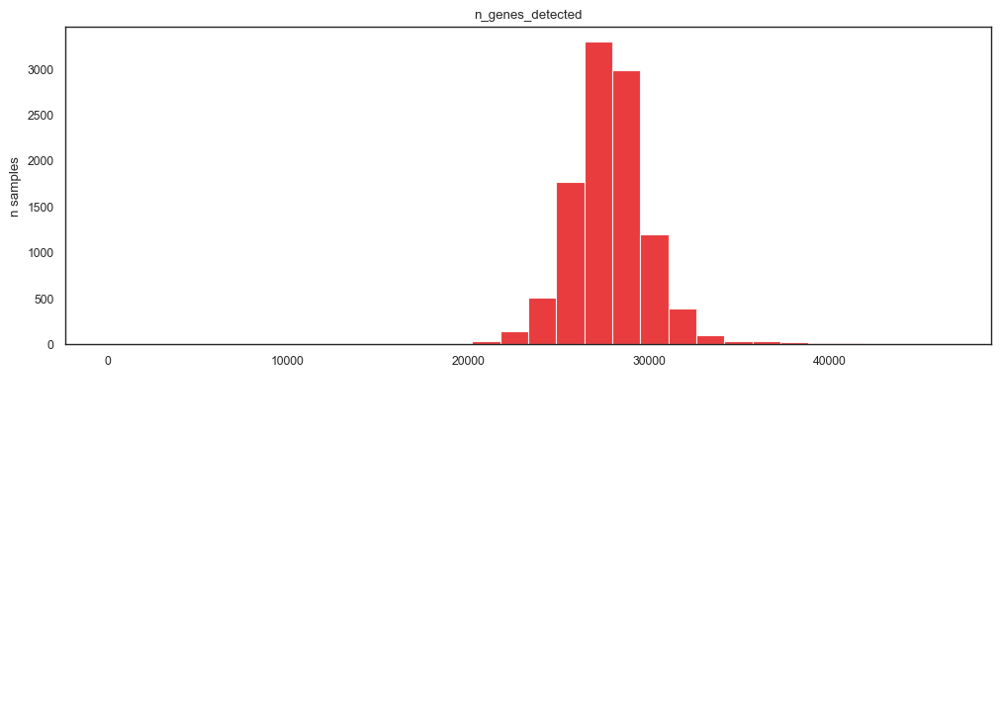

(<Figure size 1000x700 with 2 Axes>,
 array([<Axes: title={'center': 'n_genes_detected'}, ylabel='n samples'>,
        <Axes: >], dtype=object))

In [48]:
#If you only computed n_genes_detected
bk.pl.qc_metrics(
    adata,
    color="n_genes_detected",
    vars_to_plot=("n_genes_detected",),
)

### Filter out

In [49]:
adata.obs[["n_genes_detected"]].describe()    #"total_counts", "pct_counts_mt"

,n_genes_detected
count,10535.000000
mean,27840.924442
std,2242.703355
min,5.000000
25%,26528.500000
50%,27771.000000
75%,28992.000000
max,46612.000000


In [50]:
adata.shape

(10535, 58581)

In [ ]:
# If your data is log-transformed (no counts)

In [53]:
adata = bk.pp.filter_genes(adata, layer="log1p_cpm", min_samples=10, min_expr=0.1)

INFO: Filtering genes: layer='log1p_cpm', min_expr>0.1, min_samples=10 -> keep 52603/58581


In [54]:
adata = bk.pp.filter_samples(adata, layer="log1p_cpm", min_genes=15000, expr_threshold_for_genes=0.1)

INFO: Filtering samples -> keep 10534/10535


In [55]:
# 4) Recompute QC after gene filtering (optional but nice)
bk.pp.qc_metrics(adata, layer="log1p_cpm", detection_threshold=0.1)

INFO: QC metrics added to adata.obs (total_counts, n_genes_detected, pct_counts_mt where applicable).


### Normalize (already done in this dataset)

	•	layers["counts"] = raw integer counts
	•	layers["cpm"] = normalized
	•	layers["log1p_cpm"] = for PCA/plotting

In [56]:
# quick check
adata.layers["log1p_cpm"]

array([[0.7385, 0.    , 0.    , ..., 0.    , 0.    , 0.    ],
       [0.    , 0.    , 0.    , ..., 7.7539, 0.    , 0.    ],
       [0.    , 0.    , 0.    , ..., 0.6456, 0.    , 0.    ],
       ...,
       [0.    , 0.    , 0.    , ..., 7.5931, 0.    , 0.    ],
       [0.    , 0.    , 0.    , ..., 7.3647, 0.    , 0.    ],
       [0.    , 0.    , 0.    , ..., 6.8309, 0.    , 0.    ]])

# 4. PCA and bidimensional representation
<a id="pca"></a>

In [57]:
adata.obs.columns

Index(['Patient_ID', 'Project_ID', 'gender', 'race',
       'ajcc_pathologic_tumor_stage', 'clinical_stage', 'histological_type',
       'histological_grade', 'initial_pathologic_dx_year', 'menopause_status',
       ...
       'fetoprotein_outcome_value', 'fetoprotein_outcome_upper_limit',
       'fetoprotein_outcome_lower_limit', 'inter_norm_ratio_lower_limit',
       'family_cancer_type_txt', 'bilirubin_upper_limit',
       'days_to_last_known_alive', 'Unnamed: 1061', 'Unnamed: 1062',
       'n_genes_detected'],
      dtype='object', length=1063)

In [58]:
# to confirm categories
adata.obs["Project_ID"] = adata.obs["Project_ID"].astype("category")

<Axes: >

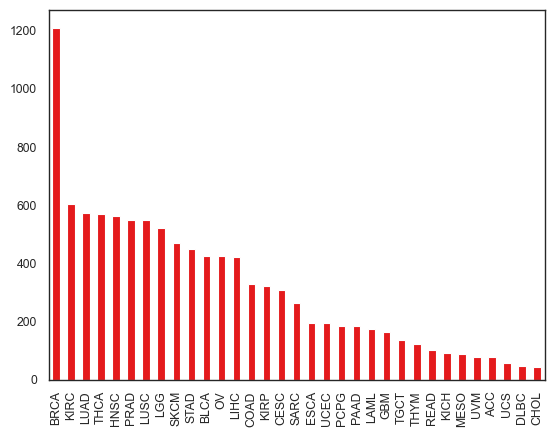

In [59]:
adata.obs["Project_ID"].value_counts().plot(kind="bar")

## 4.1. Highly-variable genes & PCA

In [60]:
bk.pp.highly_variable_genes(adata, layer="log1p_cpm", n_top_genes=2000)
adata.var["highly_variable"].sum()

INFO: Computing HVGs from layer='log1p_cpm' with n_top_genes=2000
INFO: Marked 2000 highly variable genes in adata.var['highly_variable']


2000

If you ever see HVGs dominated by:
	•	mitochondrial genes
	•	ribosomal genes

you may want to exclude them before HVG selection:

- `mask = ~adata.var_names.str.startswith(("MT-", "RPS", "RPL"))`  
- `adata_hvg = adata[:, mask].copy()`  
- `bk.pp.highly_variable_genes(adata_hvg, ...)`
  


In [62]:
# Compute PCA
bk.tl.pca(adata, layer="log1p_cpm", n_comps=20, 
         use_highly_variable=True,)                              # typically better to use this

INFO: Running PCA on matrix 10534 samples × 2000 genes; n_comps=20
INFO: PCA stored in adata.obsm['X_pca'], adata.varm['PCs'], adata.uns['pca']


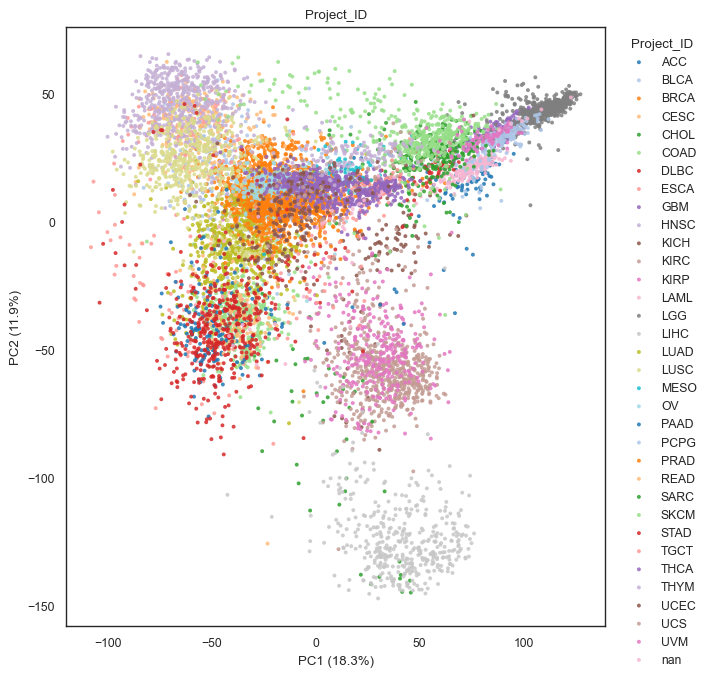

(<Figure size 700x700 with 1 Axes>,
 [<Axes: title={'center': 'Project_ID'}, xlabel='PC1 (18.3%)', ylabel='PC2 (11.9%)'>])

In [64]:
bk.pl.pca_scatter(adata, color="Project_ID", palette="tab20", figsize=(7,7), point_size=8)

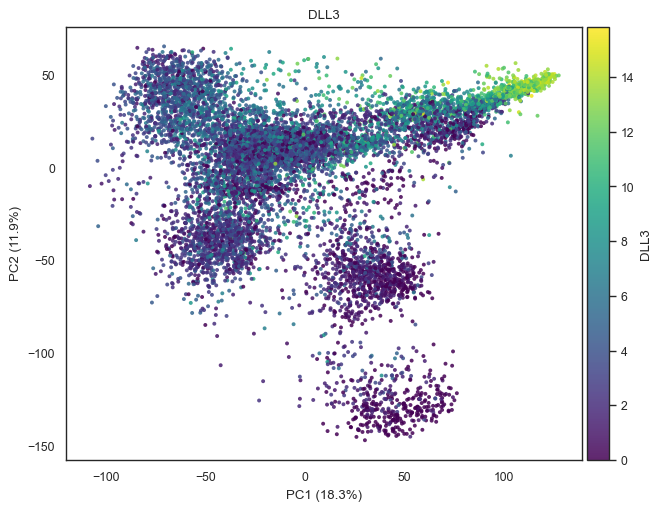

(<Figure size 650x500 with 2 Axes>,
 [<Axes: title={'center': 'DLL3'}, xlabel='PC1 (18.3%)', ylabel='PC2 (11.9%)'>])

In [65]:
bk.pl.pca_scatter(adata, color="DLL3", layer="log1p_cpm", cmap="viridis", point_size=8)

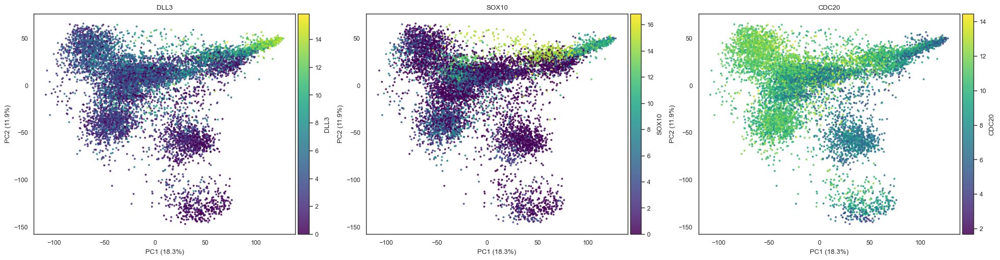

(<Figure size 1950x500 with 6 Axes>,
 array([<Axes: title={'center': 'DLL3'}, xlabel='PC1 (18.3%)', ylabel='PC2 (11.9%)'>,
        <Axes: title={'center': 'SOX10'}, xlabel='PC1 (18.3%)', ylabel='PC2 (11.9%)'>,
        <Axes: title={'center': 'CDC20'}, xlabel='PC1 (18.3%)', ylabel='PC2 (11.9%)'>],
       dtype=object))

In [66]:
bk.pl.pca_scatter(adata, color=["DLL3","SOX10","CDC20"], layer="log1p_cpm", point_size=8)

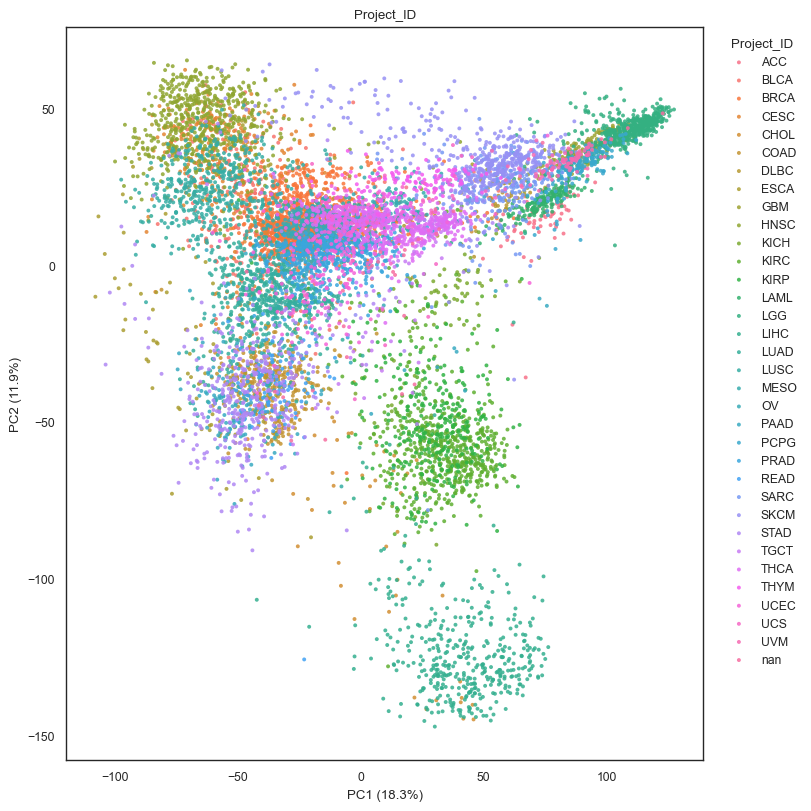

(<Figure size 800x800 with 1 Axes>,
 [<Axes: title={'center': 'Project_ID'}, xlabel='PC1 (18.3%)', ylabel='PC2 (11.9%)'>])

In [67]:
# 5) Lots of categories (e.g. 34) → use husl explicitly if you want

bk.pl.pca_scatter(adata, color="Project_ID", palette="husl", 
                  figsize=(8,8),
                  point_size=8)

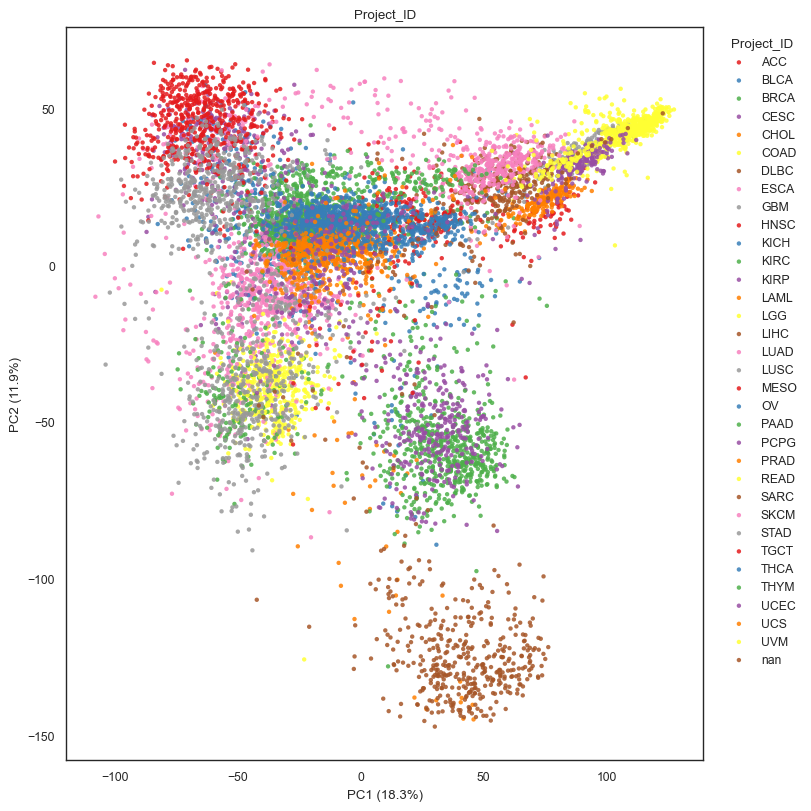

(<Figure size 800x800 with 1 Axes>,
 [<Axes: title={'center': 'Project_ID'}, xlabel='PC1 (18.3%)', ylabel='PC2 (11.9%)'>])

In [68]:
#OLD
bk.pl.pca_scatter(adata, color="Project_ID", 
                  figsize=(8,8),
                  point_size=10,
                 )                              # save="pca_by_subtype.png"

### PCA Variance

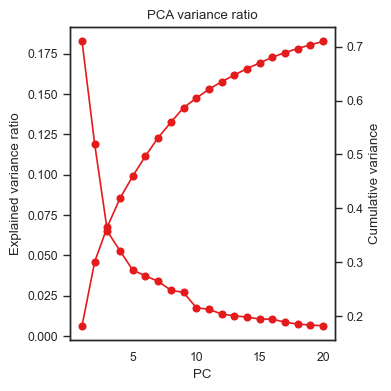

(<Figure size 400x400 with 2 Axes>,
 <Axes: title={'center': 'PCA variance ratio'}, xlabel='PC', ylabel='Explained variance ratio'>)

In [69]:
# 4) scree
bk.pl.pca_variance_ratio(adata, 
                         figsize=(4, 4),
                         #save="figs/pca_scree.png"
                        )


#If you ever call PCA with key_added="pca_hvg", then:
bk.pl.pca_variance_ratio(adata, key="pca_hvg")

## 4.2. PCA loadings

In [71]:
bk.tl.pca_loadings(adata, pcs=[1,2], n_top=10)

{'PC1_pos':         pc sign  rank       gene   loading
 50860  PC1  pos     1       BCAN  0.050191
 1837   PC1  pos     2     POU3F3  0.048378
 33110  PC1  pos     3       GFAP  0.046873
 28995  PC1  pos     4       PLP1  0.042937
 33065  PC1  pos     5      OLIG1  0.042259
 29112  PC1  pos     6  LINC01158  0.041495
 796    PC1  pos     7       BEX1  0.039875
 12805  PC1  pos     8     CTNNA2  0.038589
 11976  PC1  pos     9     ETNPPL  0.037962
 37756  PC1  pos    10       SCG3  0.037738,
 'PC1_neg':         pc sign  rank      gene   loading
 50438  PC1  neg     1   CEACAM6 -0.086779
 8052   PC1  neg     2     KRT6A -0.084907
 50435  PC1  neg     3   CEACAM5 -0.083953
 16858  PC1  neg     4      AGR2 -0.081556
 2256   PC1  neg     5  SERPINB5 -0.080948
 50128  PC1  neg     6   TMPRSS4 -0.079735
 15716  PC1  neg     7     KRT15 -0.077447
 29857  PC1  neg     8     RAB25 -0.076824
 14572  PC1  neg     9      KRT5 -0.076631
 15715  PC1  neg    10     KRT16 -0.075571,
 'PC2_pos':        

In [72]:
#Export
bk.tl.pca_loadings(
    adata,
    pcs=[1,2,3,4,5],
    n_top=100,
    export="results/TCGA_pca_loadings.tsv",
    export_gmt="results/TCGA_pca_loadings.gmt",
)

INFO: pca_loadings: exported results/TCGA_pca_loadings.tsv and results/TCGA_pca_loadings.wide.tsv
INFO: pca_loadings: exported GMT to results/TCGA_pca_loadings.gmt


{'PC1_pos':         pc sign  rank     gene   loading
 50860  PC1  pos     1     BCAN  0.050191
 1837   PC1  pos     2   POU3F3  0.048378
 33110  PC1  pos     3     GFAP  0.046873
 28995  PC1  pos     4     PLP1  0.042937
 33065  PC1  pos     5    OLIG1  0.042259
 ...    ...  ...   ...      ...       ...
 20633  PC1  pos    96   GABRG2  0.020344
 25643  PC1  pos    97  SLC22A7  0.020339
 21811  PC1  pos    98   ACSM2B  0.020221
 41790  PC1  pos    99   NKX2-2  0.020165
 33493  PC1  pos   100    KCNJ3  0.020014
 
 [100 rows x 5 columns],
 'PC1_neg':         pc sign  rank      gene   loading
 50438  PC1  neg     1   CEACAM6 -0.086779
 8052   PC1  neg     2     KRT6A -0.084907
 50435  PC1  neg     3   CEACAM5 -0.083953
 16858  PC1  neg     4      AGR2 -0.081556
 2256   PC1  neg     5  SERPINB5 -0.080948
 ...    ...  ...   ...       ...       ...
 46401  PC1  neg    96     ESRP2 -0.050246
 28140  PC1  neg    97    S100A2 -0.049962
 18737  PC1  neg    98   ANXA8L1 -0.049845
 24337  PC1  neg 

In [73]:
#Absolute loadings only (single list per PC)
bk.tl.pca_loadings(adata, pcs=[1,2,3], n_top=100, use_abs=True)

{'PC1_abs':         pc sign  rank      gene   loading
 50438  PC1  abs     1   CEACAM6 -0.086779
 8052   PC1  abs     2     KRT6A -0.084907
 50435  PC1  abs     3   CEACAM5 -0.083953
 16858  PC1  abs     4      AGR2 -0.081556
 2256   PC1  abs     5  SERPINB5 -0.080948
 ...    ...  ...   ...       ...       ...
 46401  PC1  abs    96     ESRP2 -0.050246
 50860  PC1  abs    97      BCAN  0.050191
 28140  PC1  abs    98    S100A2 -0.049962
 18737  PC1  abs    99   ANXA8L1 -0.049845
 24337  PC1  abs   100     IGHA2 -0.049593
 
 [100 rows x 5 columns],
 'PC2_abs':         pc sign  rank     gene   loading
 40168  PC2  abs     1    HNF4A -0.099591
 11245  PC2  abs     2    CDHR5 -0.089164
 52362  PC2  abs     3    ALDOB -0.088794
 20467  PC2  abs     4     A1CF -0.087727
 6005   PC2  abs     5      FGA -0.085978
 ...    ...  ...   ...      ...       ...
 5772   PC2  abs    96   CYP3A5 -0.055155
 10653  PC2  abs    97  UGT2B15 -0.055070
 15896  PC2  abs    98   UGT3A1 -0.055053
 32526  PC2  ab

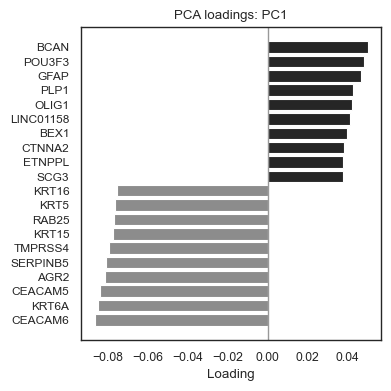

(<Figure size 400x400 with 1 Axes>,
 <Axes: title={'center': 'PCA loadings: PC1'}, xlabel='Loading'>)

In [75]:
# Barplot for PC1 (top pos/neg)
bk.pl.pca_loadings_bar(adata, pc=1, n_top=10, figsize=(4,4))   #save="figs/pc1_loadings_bar.png"

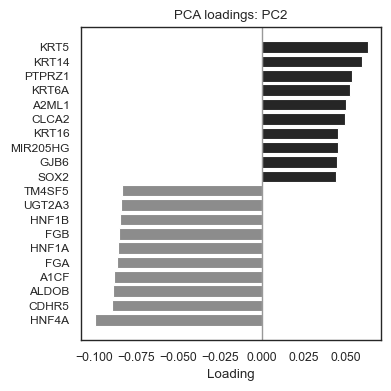

(<Figure size 400x400 with 1 Axes>,
 <Axes: title={'center': 'PCA loadings: PC2'}, xlabel='Loading'>)

In [76]:
# Barplot for PC2 (top pos/neg)
bk.pl.pca_loadings_bar(adata, pc=2, n_top=10, figsize=(4,4))   #save="figs/pc1_loadings_bar.png"

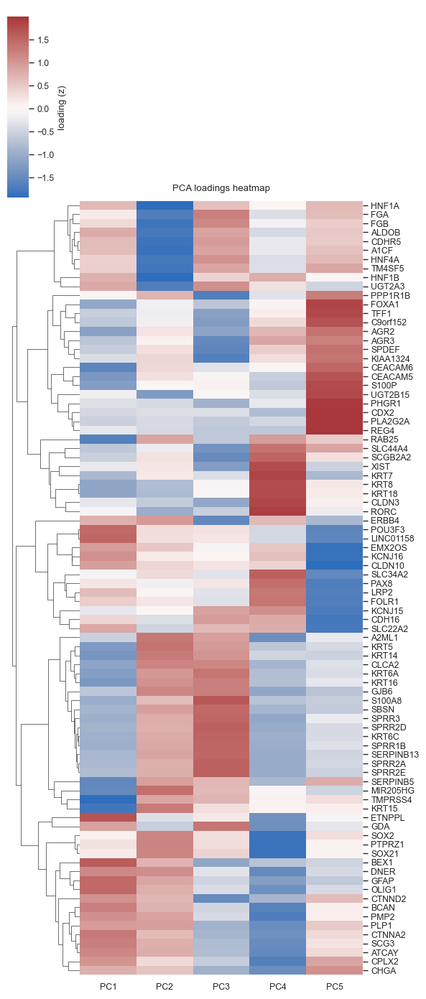

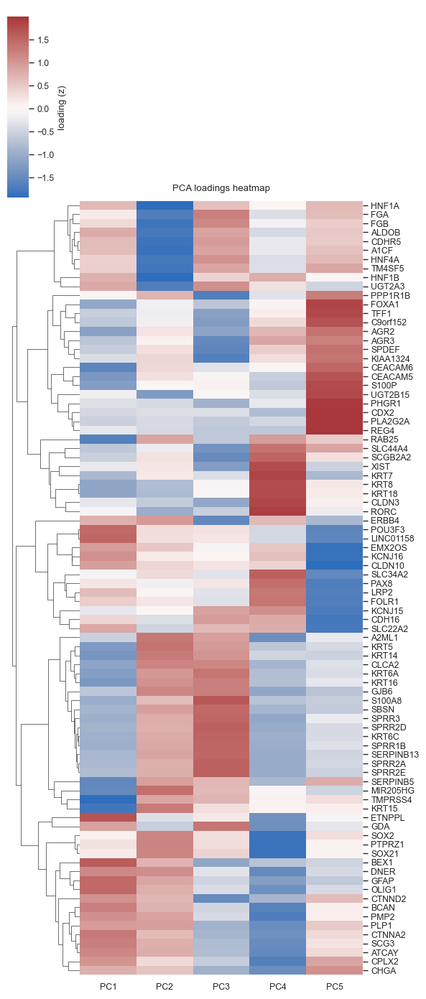

In [77]:
# Heatmap for PC1–PC5 (union of top genes)
bk.pl.pca_loadings_heatmap(
    adata,
    pcs=[1,2,3,4,5],
    n_top=10,
    cluster_genes=True,
    cluster_pcs=False,
    z_score=True,
    figsize=(6,14),
    save="figs/pca_loadings_heatmap_TCGAall.png",
)

## 4.3. Neighbors & UMAP

Common bulk-friendly parameter ranges
	•	n_neighbors: 10–30 (for ~100 samples, 15 is a good start)
	•	resolution:
	•	0.3–0.8 for broader groups
	•	1.0–2.0 for finer subclusters

In [78]:
# Calculate neighbors - PCA should be already computed
bk.tl.neighbors(adata, n_neighbors=15, n_pcs=20, metric="euclidean")

INFO: Computing neighbors: k=15, rep=X_pca, n_pcs=20, metric=euclidean
INFO: Stored neighbors graph in adata.obsp['distances'] and adata.obsp['connectivities'].


In [79]:
bk.tl.umap(adata, n_neighbors=8, n_pcs=30, min_dist=0.3, random_state=0)    #0.3

INFO: Running UMAP (rep=X_pca, n_pcs=20, n_neighbors=8, min_dist=0.3, n_components=2)
/Users/mmalumbres/mambaforge/envs/biopython/lib/python3.10/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


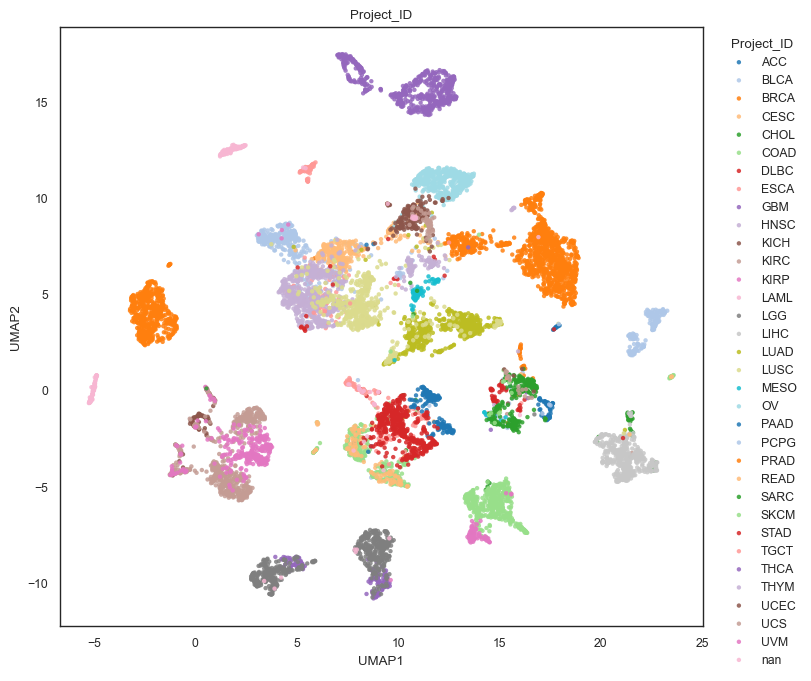

(<Figure size 800x700 with 1 Axes>,
 [<Axes: title={'center': 'Project_ID'}, xlabel='UMAP1', ylabel='UMAP2'>])

In [80]:
# categorical (legend)
bk.pl.umap(adata, color="Project_ID", 
           figsize=(8,7),
           point_size=10, palette="tab20")

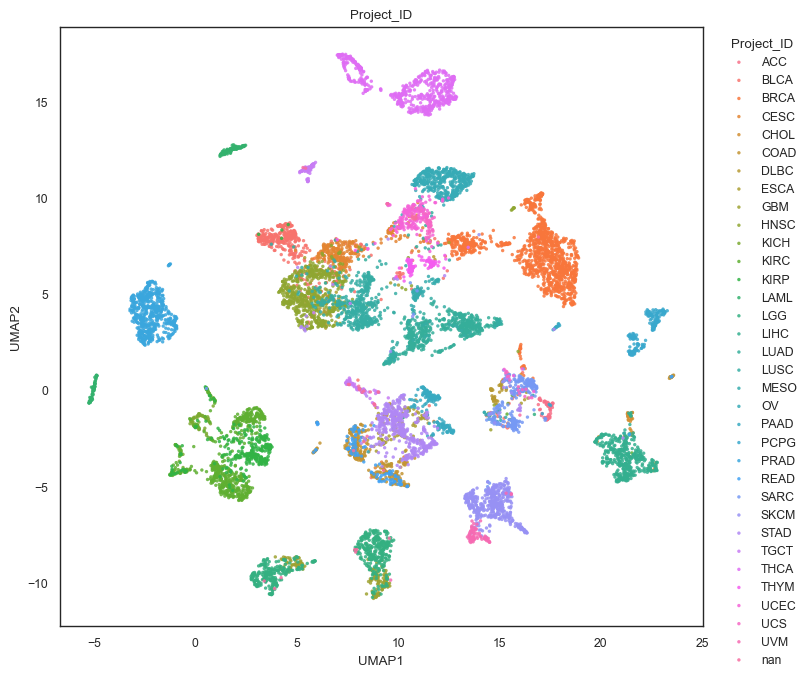

(<Figure size 800x700 with 1 Axes>,
 [<Axes: title={'center': 'Project_ID'}, xlabel='UMAP1', ylabel='UMAP2'>])

In [81]:
# many categories → avoid repetition
bk.pl.umap(adata, color="Project_ID", palette="husl", 
           figsize=(8,7),
           point_size=6)

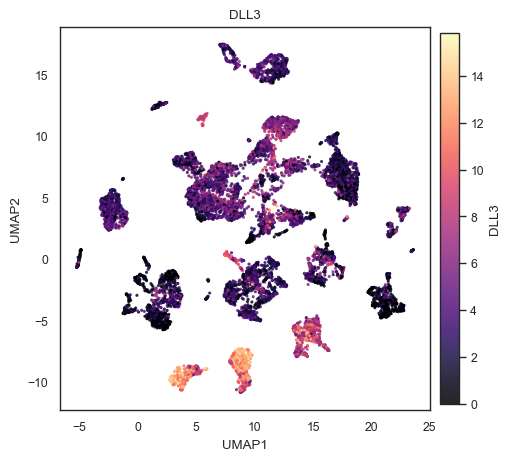

(<Figure size 500x450 with 2 Axes>,
 [<Axes: title={'center': 'DLL3'}, xlabel='UMAP1', ylabel='UMAP2'>])

In [85]:
# gene expression (continuous, from a layer)
bk.pl.umap(adata, color="DLL3", layer="log1p_cpm", figsize=(5,4.5), point_size=5, cmap="magma")

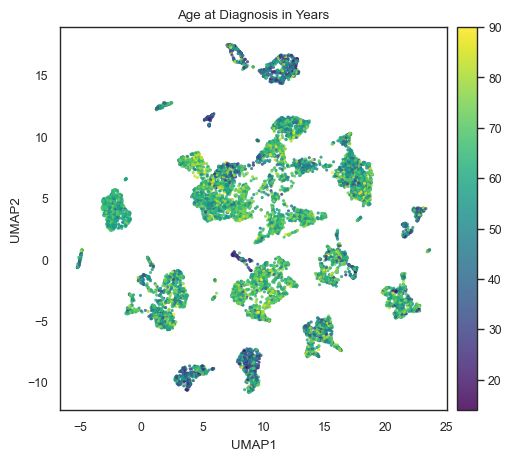

(<Figure size 500x450 with 2 Axes>,
 [<Axes: title={'center': 'Age at Diagnosis in Years'}, xlabel='UMAP1', ylabel='UMAP2'>])

In [89]:
# continuous metadata
bk.pl.umap(adata, color="Age at Diagnosis in Years", 
           figsize=(5,4.5), point_size=5, 
           cmap="viridis")


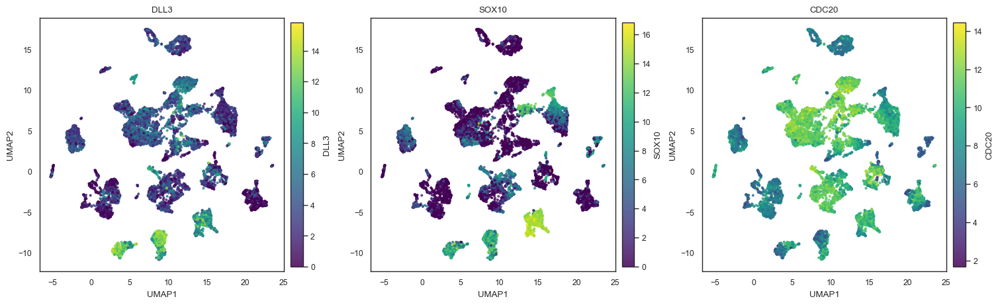

(<Figure size 1500x450 with 6 Axes>,
 array([<Axes: title={'center': 'DLL3'}, xlabel='UMAP1', ylabel='UMAP2'>,
        <Axes: title={'center': 'SOX10'}, xlabel='UMAP1', ylabel='UMAP2'>,
        <Axes: title={'center': 'CDC20'}, xlabel='UMAP1', ylabel='UMAP2'>],
       dtype=object))

In [91]:
# multiple genes → 1 row of panels
bk.pl.umap(adata, color=["DLL3", "SOX10", "CDC20"], layer="log1p_cpm", 
           figsize=(5,4.5),
           point_size=8, cmap="viridis")

### Compare umap & umap_graph:  
- umap: regular, representation-driven, standard
- umap_graph: “Graph-enforced UMAP reveals subtype separation”, topology-preserving, exploratory

In [92]:
bk.tl.umap_graph(
    adata,
    graph_key="connectivities",
    min_dist=0.3,
    random_state=0,
)

INFO: Running graph-based UMAP (graph=connectivities, init=spectral, n_pcs=20, min_dist=0.3, n_components=2)
/Users/mmalumbres/mambaforge/envs/biopython/lib/python3.10/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


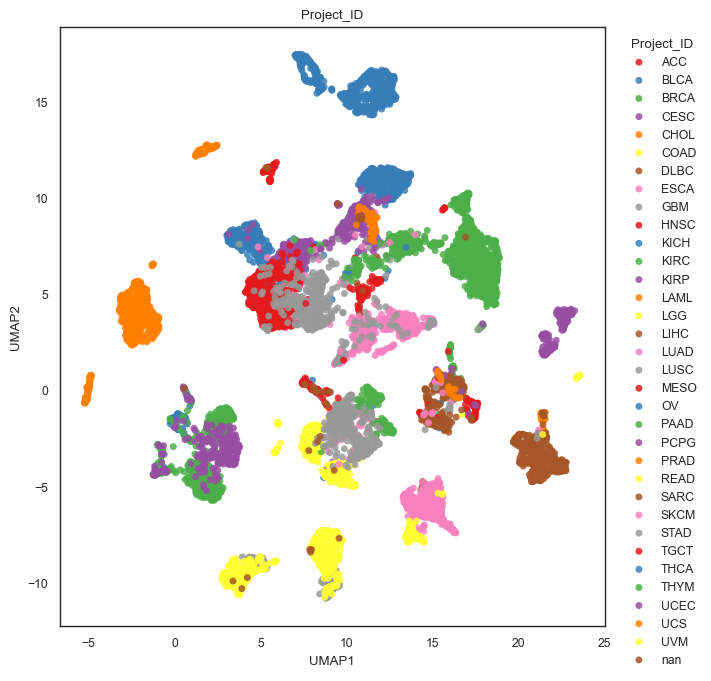

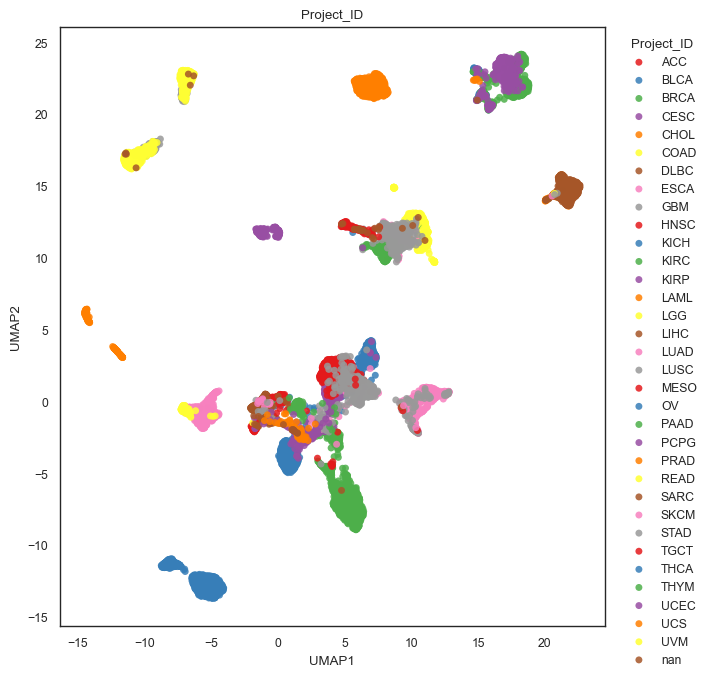

(<Figure size 700x700 with 1 Axes>,
 [<Axes: title={'center': 'Project_ID'}, xlabel='UMAP1', ylabel='UMAP2'>])

In [93]:
bk.pl.umap(adata, basis="X_umap", color="Project_ID", figsize=(7,7))      #save="umap_standard.png"
bk.pl.umap(adata, basis="X_umap_graph", color="Project_ID", figsize=(7,7))   #save="umap_graph.png"

# 5. Clustering and define groups <a id="clusters"></a> 

Basic procedure: PCA → 2) neighbors graph on PCs → 3) Leiden (scan resolution)   
- Use `method=leiden` for computational of clusters. `resolution`: Higher resolution → more clusters // Lower resolution → fewer clusters. Leiden requires a graph, so run after `bk.tl.neighbors` (already computed for UMAP)  
- Use K-means when you want direct control over the number of clusters or a quick baseline.   
Try Leiden; if not installed it will fallback to kmeans automatically  


## 5.1. Leiden  
For complex structure and unknown number of clusters

In [94]:
# Initial test if true groups already known. Scan many Leiden resolutions
df = bk.tl.leiden_resolution_scan(
    adata,
    true_key="Project_ID",                                          # Biological true groups                    
    resolutions=[0.2, 0.4, 0.6, 0.8, 1.0, 1.2, 1.5, 2.0],
    base_key="leiden",
    use_rep="X_pca",
    n_pcs=20,
    n_neighbors=15,
)
df

INFO: Leiden resolution=0.2
INFO: Clustering with Leiden (resolution=0.2)
INFO: Leiden produced 16 clusters stored in adata.obs['leiden_0.2'].
INFO: Leiden resolution=0.4
INFO: Clustering with Leiden (resolution=0.4)
INFO: Leiden produced 21 clusters stored in adata.obs['leiden_0.4'].
INFO: Leiden resolution=0.6
INFO: Clustering with Leiden (resolution=0.6)
INFO: Leiden produced 23 clusters stored in adata.obs['leiden_0.6'].
INFO: Leiden resolution=0.8
INFO: Clustering with Leiden (resolution=0.8)
INFO: Leiden produced 25 clusters stored in adata.obs['leiden_0.8'].
INFO: Leiden resolution=1
INFO: Clustering with Leiden (resolution=1.0)
INFO: Leiden produced 27 clusters stored in adata.obs['leiden_1'].
INFO: Leiden resolution=1.2
INFO: Clustering with Leiden (resolution=1.2)
INFO: Leiden produced 30 clusters stored in adata.obs['leiden_1.2'].
INFO: Leiden resolution=1.5
INFO: Clustering with Leiden (resolution=1.5)
INFO: Leiden produced 33 clusters stored in adata.obs['leiden_1.5'].
INF

,resolution,key,n_clusters,ARI,NMI,cramers_v,n_used,n_missing
0,0.2,leiden_0.2,16,0.550043,0.788988,0.889240,10495,39
1,0.4,leiden_0.4,21,0.527337,0.783418,0.802683,10495,39
2,0.6,leiden_0.6,23,0.578785,0.801896,0.810116,10495,39
3,0.8,leiden_0.8,25,0.605164,0.812923,0.806741,10495,39
4,1.0,leiden_1,27,0.630577,0.811779,0.796994,10495,39
5,1.2,leiden_1.2,30,0.637650,0.812469,0.769847,10495,39
6,1.5,leiden_1.5,33,0.654320,0.812014,0.752093,10495,39
7,2.0,leiden_2,37,0.670129,0.823322,0.807237,10495,39


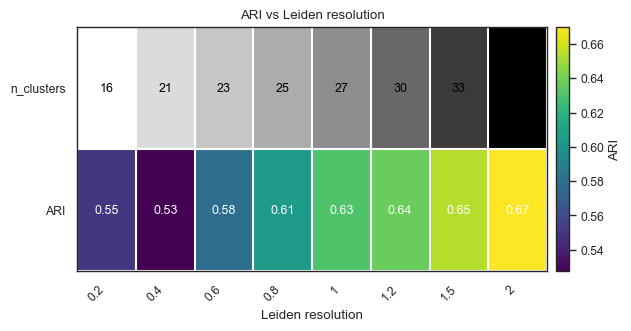

(<Figure size 620x320 with 2 Axes>,
 <Axes: title={'center': 'ARI vs Leiden resolution'}, xlabel='Leiden resolution'>)

In [95]:
# Heatmap of ARI vs resolution in the previous calculations
bk.pl.ari_resolution_heatmap(
    adata,
    df=df,
    metric="ARI",
    show_n_clusters=True,
    save="figs/ari_vs_resolution.png",
)

In [96]:
# A single calculation with a specific resolution
bk.tl.cluster(adata, method="leiden", key_added="leiden_2.2", resolution=2.2)

INFO: Clustering with Leiden (resolution=2.2)
INFO: Leiden produced 39 clusters stored in adata.obs['leiden_2.2'].


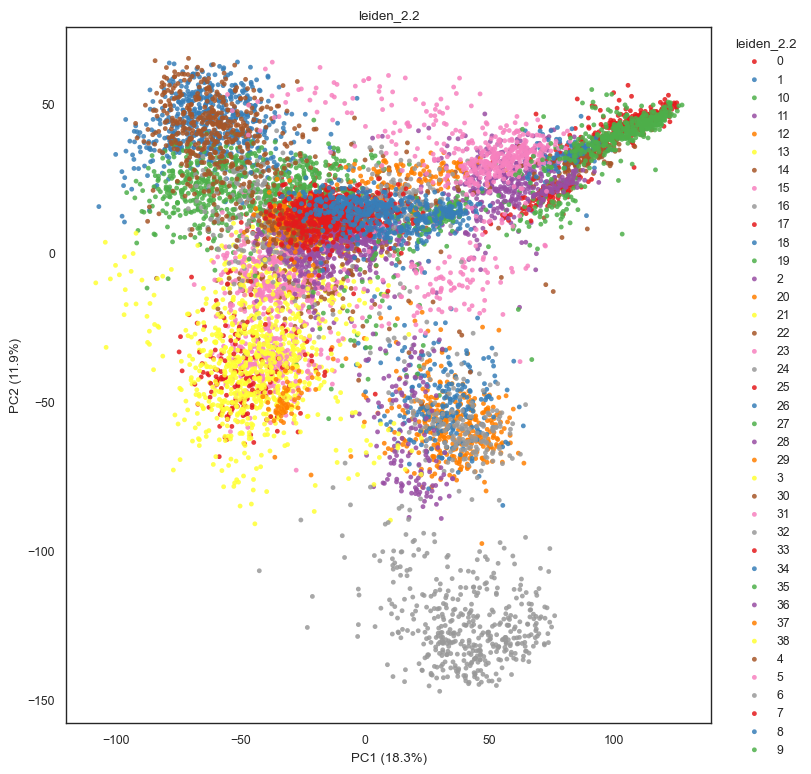

(<Figure size 800x800 with 1 Axes>,
 [<Axes: title={'center': 'leiden_2.2'}, xlabel='PC1 (18.3%)', ylabel='PC2 (11.9%)'>])

In [97]:
bk.pl.pca_scatter(adata, color="leiden_2.2", 
                  figsize=(8,8),
                  point_size=12)    #save="pca_clusters.png"

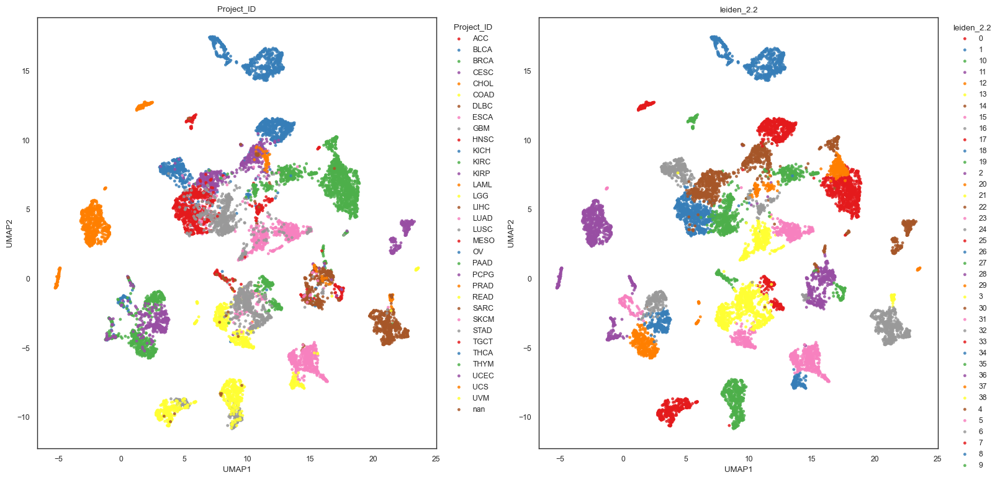

(<Figure size 1600x800 with 2 Axes>,
 array([<Axes: title={'center': 'Project_ID'}, xlabel='UMAP1', ylabel='UMAP2'>,
        <Axes: title={'center': 'leiden_2.2'}, xlabel='UMAP1', ylabel='UMAP2'>],
       dtype=object))

In [98]:
bk.pl.umap(adata, color=["Project_ID", "leiden_2.2"], 
                  figsize=(8,8),
                  point_size=12)    #save="pca_clusters.png"

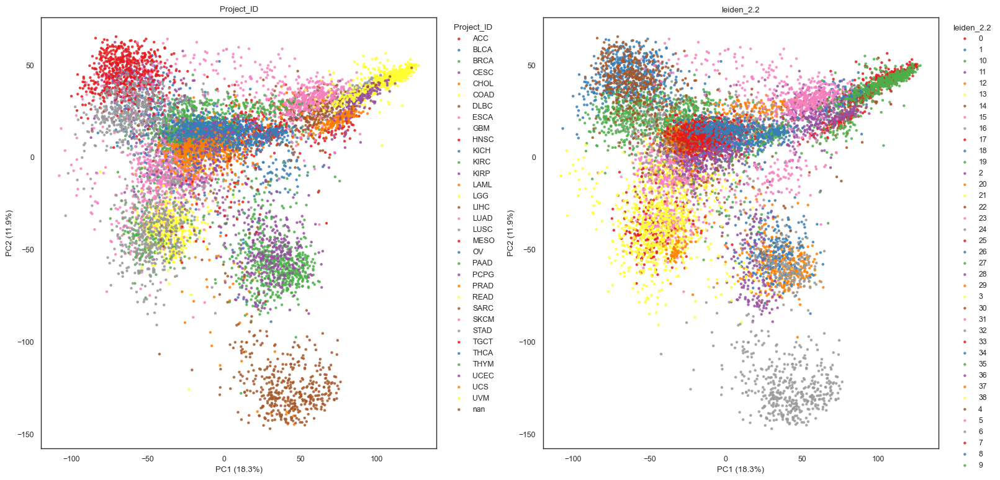

(<Figure size 1600x800 with 2 Axes>,
 array([<Axes: title={'center': 'Project_ID'}, xlabel='PC1 (18.3%)', ylabel='PC2 (11.9%)'>,
        <Axes: title={'center': 'leiden_2.2'}, xlabel='PC1 (18.3%)', ylabel='PC2 (11.9%)'>],
       dtype=object))

In [99]:
bk.pl.pca_scatter(adata, color=["Project_ID", "leiden_2.2"],  
                 figsize=(8,8),
                 point_size=10)   #save="pca_leiden.png"


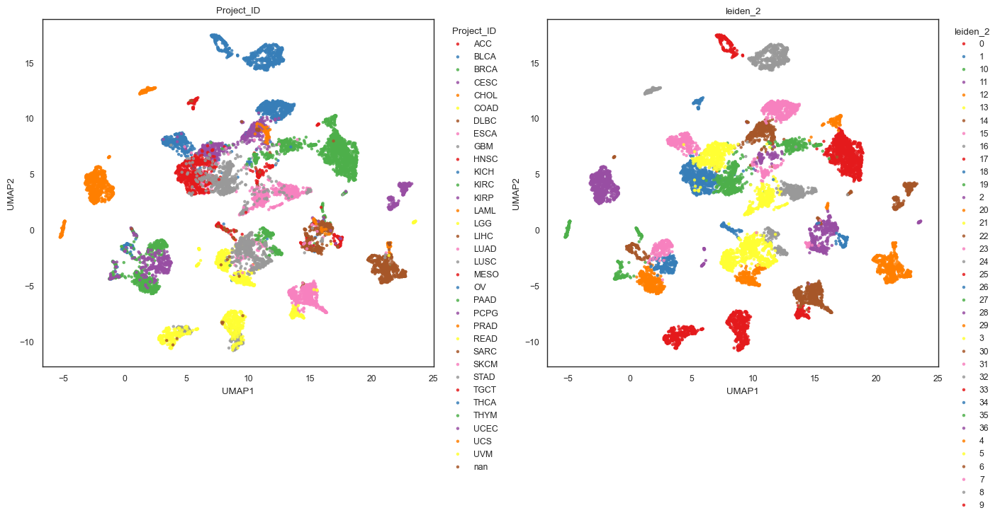

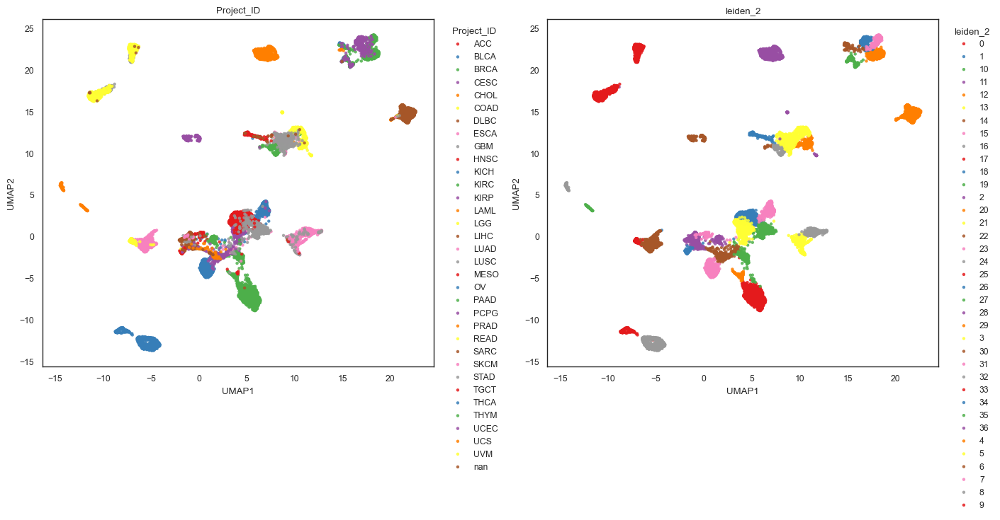

(<Figure size 1400x700 with 2 Axes>,
 array([<Axes: title={'center': 'Project_ID'}, xlabel='UMAP1', ylabel='UMAP2'>,
        <Axes: title={'center': 'leiden_2'}, xlabel='UMAP1', ylabel='UMAP2'>],
       dtype=object))

In [100]:
bk.pl.umap(adata, basis="X_umap", color=["Project_ID", "leiden_2"], figsize=(7,7), point_size=10)             #save="umap_leiden_standard.png"
bk.pl.umap(adata, basis="X_umap_graph", color=["Project_ID", "leiden_2"], figsize=(7,7), point_size=10)      #save="umap_leiden_standard.png"

In [101]:
# Compare results leiden vs. True biological
pd.crosstab(adata.obs["Project_ID"], adata.obs["leiden_2"])

leiden_2,0,1,10,11,12,13,14,15,16,17,...,33,34,35,36,4,5,6,7,8,9
Project_ID,,,,,,,,,,,,,,,,,,,,,
ACC,0,0,0,2,0,0,0,0,0,0,...,0,74,0,0,0,0,0,0,0,0
BLCA,0,47,5,9,0,2,3,305,0,0,...,0,0,0,0,0,37,0,0,0,0
BRCA,868,0,0,16,0,0,3,0,0,0,...,0,0,0,0,1,7,0,0,0,0
CESC,0,0,0,2,0,0,60,1,0,0,...,0,0,0,0,0,235,0,1,0,0
CHOL,0,0,0,1,0,0,0,0,0,0,...,0,0,0,0,41,0,0,0,0,0
COAD,0,0,0,0,0,0,0,0,0,0,...,0,0,0,41,0,0,0,0,0,0
DLBC,0,0,0,44,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
ESCA,0,75,6,2,0,0,1,1,0,0,...,0,0,0,0,0,11,0,0,0,0
GBM,0,0,0,4,0,0,0,0,0,57,...,0,0,0,0,0,0,0,0,0,104


In [104]:
# estimate how good is the correlation - Compute ARI - NMI - cramers_v, silhouette
# ARI: from sklearn.metrics import adjusted_rand_score
# NMI: from sklearn.metrics import normalized_mutual_info_score

# Test1. One clustering vs ground truth (plus silhouette on PCA)
#bk.tl.neighbors(adata, n_neighbors=15, n_pcs=20)  # if not done
#bk.tl.leiden(adata, resolution=1.0)

m = bk.tl.cluster_metrics(
    adata,
    true_key="Project_ID",
    cluster_key="leiden_2",
    use_rep="X_pca",
    n_pcs=20,
)
m

INFO: cluster_metrics: n_used=10495 ari=0.670 nmi=0.823 cramers_v=0.806 silhouette=0.23031431903604613


{'n_used': 10495.0,
 'ari': 0.6701289105340902,
 'nmi': 0.8233217047066449,
 'cramers_v': 0.8063399112300729,
 'silhouette': 0.23031431903604613}

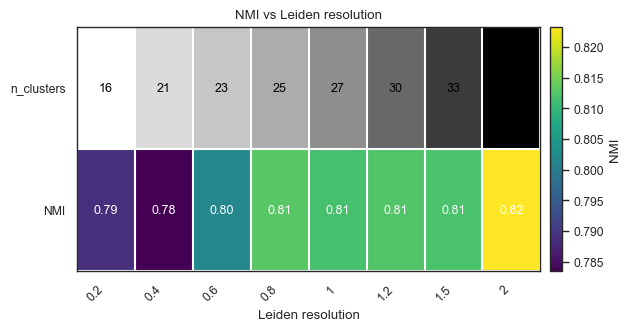

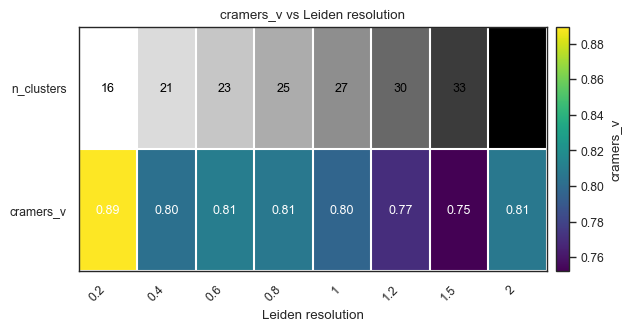

(<Figure size 620x320 with 2 Axes>,
 <Axes: title={'center': 'cramers_v vs Leiden resolution'}, xlabel='Leiden resolution'>)

In [105]:
# Plot results
bk.pl.ari_resolution_heatmap(adata, df=df, metric="NMI")
bk.pl.ari_resolution_heatmap(adata, df=df, metric="cramers_v")
#bk.pl.ari_resolution_heatmap(adata, df=df, metric="silhouette", vmin=None, vmax=None)

## 5.2. K-means  
Fixed number of clusters

In [106]:
# try several k values
for k in [10, 15, 20, 25, 30]:
    bk.tl.cluster(
        adata,
        method="kmeans",
        n_clusters=k,
        use_rep="X_pca",
        n_pcs=20,
        key_added=f"kmeans_{k}",
    )

INFO: Clustering with kmeans (k=10, rep=X_pca, n_pcs=20)
INFO: KMeans produced 10 clusters stored in adata.obs['kmeans_10'].
INFO: Clustering with kmeans (k=15, rep=X_pca, n_pcs=20)
INFO: KMeans produced 15 clusters stored in adata.obs['kmeans_15'].
INFO: Clustering with kmeans (k=20, rep=X_pca, n_pcs=20)
INFO: KMeans produced 20 clusters stored in adata.obs['kmeans_20'].
INFO: Clustering with kmeans (k=25, rep=X_pca, n_pcs=20)
INFO: KMeans produced 25 clusters stored in adata.obs['kmeans_25'].
INFO: Clustering with kmeans (k=30, rep=X_pca, n_pcs=20)
INFO: KMeans produced 30 clusters stored in adata.obs['kmeans_30'].


In [109]:
# evaluate quantitively
bk.tl.cluster_metrics(
    adata,
    cluster_key="kmeans_25",
    true_key="Project_ID",
)

INFO: cluster_metrics: n_used=10495 ari=0.673 nmi=0.799 cramers_v=0.817 silhouette=0.3125603659482761


{'n_used': 10495.0,
 'ari': 0.6732428059451844,
 'nmi': 0.7988848404974632,
 'cramers_v': 0.8170361498370644,
 'silhouette': 0.3125603659482761}

In [110]:
# Calculate for a fixed number of clusters
bk.tl.cluster(
    adata,
    method="kmeans",
    n_clusters=25,
    use_rep="X_pca",
    n_pcs=20,
    key_added="kmeans_25",
    random_state=0,
)

INFO: Clustering with kmeans (k=25, rep=X_pca, n_pcs=20)
INFO: KMeans produced 25 clusters stored in adata.obs['kmeans_25'].


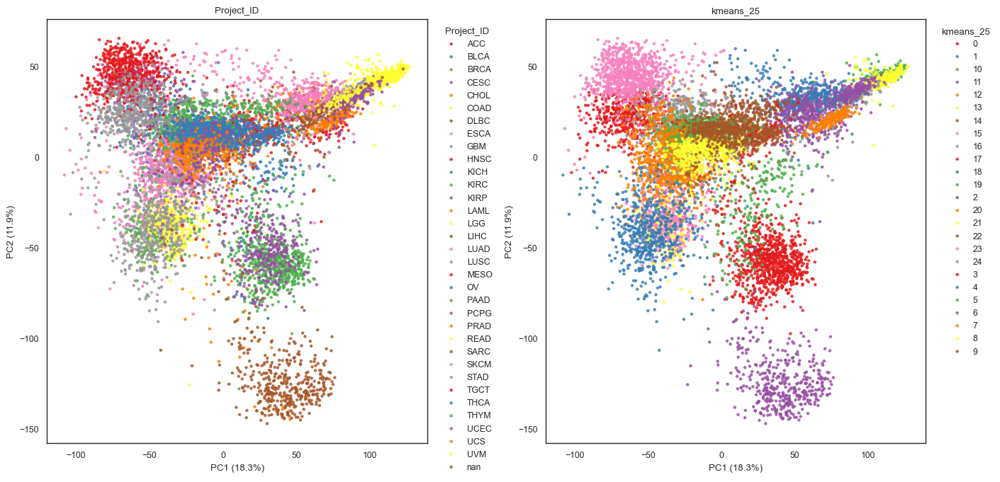

(<Figure size 1400x700 with 2 Axes>,
 array([<Axes: title={'center': 'Project_ID'}, xlabel='PC1 (18.3%)', ylabel='PC2 (11.9%)'>,
        <Axes: title={'center': 'kmeans_25'}, xlabel='PC1 (18.3%)', ylabel='PC2 (11.9%)'>],
       dtype=object))

In [111]:
bk.pl.pca_scatter(adata, color=["Project_ID", "kmeans_25"], figsize=(7,7), point_size=10)

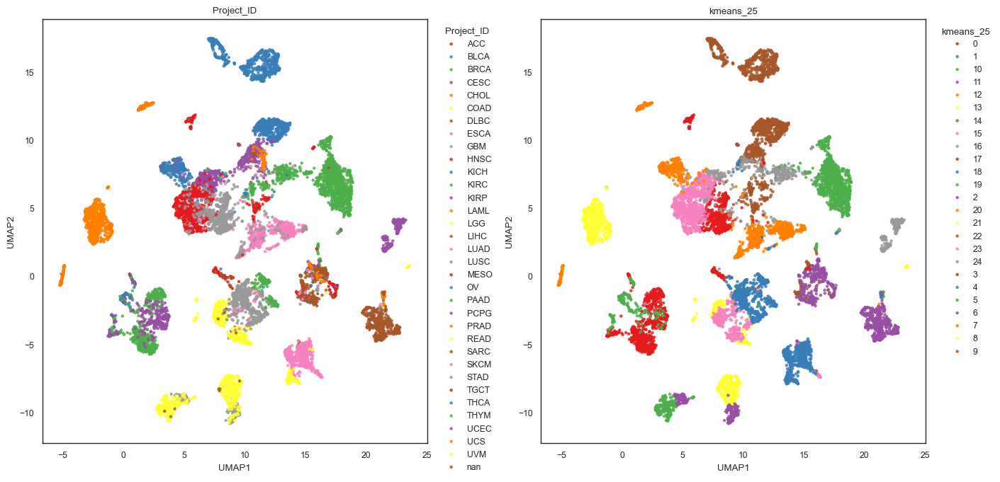

(<Figure size 1400x700 with 2 Axes>,
 array([<Axes: title={'center': 'Project_ID'}, xlabel='UMAP1', ylabel='UMAP2'>,
        <Axes: title={'center': 'kmeans_25'}, xlabel='UMAP1', ylabel='UMAP2'>],
       dtype=object))

In [112]:
bk.pl.umap(adata, color=["Project_ID", "kmeans_25"], figsize=(7,7), point_size=10)

# 6. Genes and Gene Signatures
<a id="genes"></a>

## 6.1. Gene plots

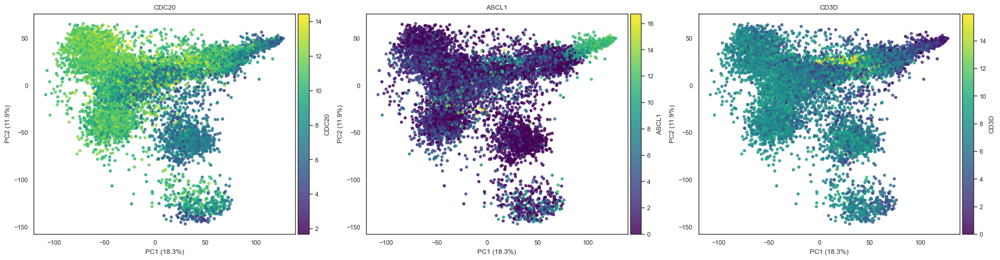

(<Figure size 1950x500 with 6 Axes>,
 array([<Axes: title={'center': 'CDC20'}, xlabel='PC1 (18.3%)', ylabel='PC2 (11.9%)'>,
        <Axes: title={'center': 'ASCL1'}, xlabel='PC1 (18.3%)', ylabel='PC2 (11.9%)'>,
        <Axes: title={'center': 'CD3D'}, xlabel='PC1 (18.3%)', ylabel='PC2 (11.9%)'>],
       dtype=object))

In [113]:
bk.pl.pca_scatter(adata, color=["CDC20", "ASCL1","CD3D"],)

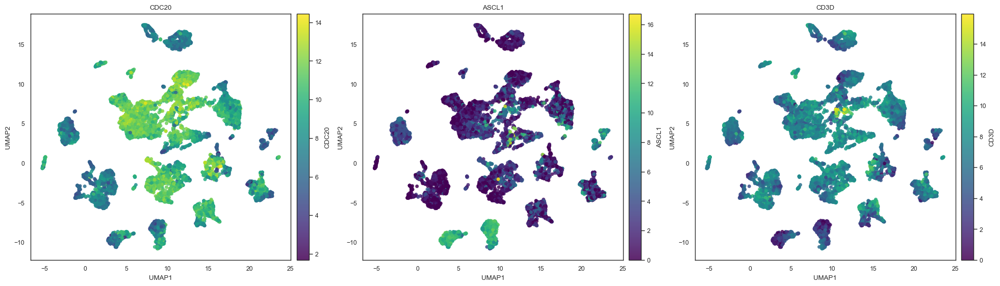

(<Figure size 1950x550 with 6 Axes>,
 array([<Axes: title={'center': 'CDC20'}, xlabel='UMAP1', ylabel='UMAP2'>,
        <Axes: title={'center': 'ASCL1'}, xlabel='UMAP1', ylabel='UMAP2'>,
        <Axes: title={'center': 'CD3D'}, xlabel='UMAP1', ylabel='UMAP2'>],
       dtype=object))

In [114]:
bk.pl.umap(adata, color=["CDC20", "ASCL1","CD3D"],)

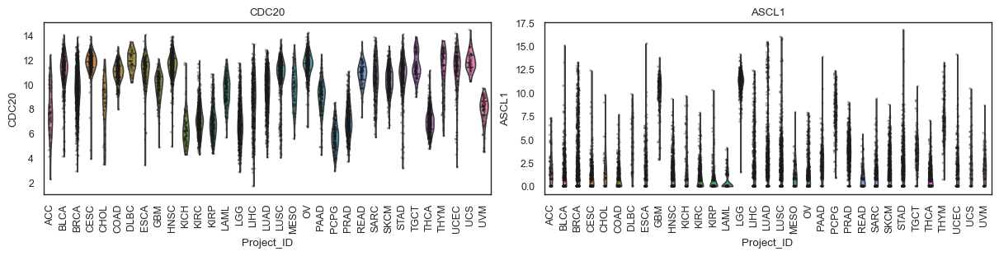

(<Figure size 1200x300 with 2 Axes>,
 array([<Axes: title={'center': 'CDC20'}, xlabel='Project_ID', ylabel='CDC20'>,
        <Axes: title={'center': 'ASCL1'}, xlabel='Project_ID', ylabel='ASCL1'>],
       dtype=object))

In [115]:
bk.pl.violin(
    adata,
    keys=["CDC20", "ASCL1"],
    groupby="Project_ID",
    #layer="log1p_cpm",      # or "counts" / None
    rotate_xticks=90,
    figsize=(12, 3),
)                           #save="figs/violin_qc.png", 

## 6.2. Score gene signatures

### 6.2.1. A dictionary of signatures

In [116]:
# Define signatures
signatures = {
    "Proliferation": ["MKI67", "TOP2A", "CDC20", "CCNB1", "CCNDA2"],
    "T_cell": ["CD3D", "CD3E", "TRBC1"],
    "Neuroendocrine": ["ASCL1", "NEUROD1", "DLL3", "CHGA"],
}

In [117]:
# Compute signature scores
bk.tl.score_genes_dict(
    adata,
    signatures,
    layer="log1p_cpm",
    scale=True,
)

INFO: score_genes: stored 'Proliferation_score' in adata.obs (n_sig=4, n_ctrl=200, layer=log1p_cpm)
INFO: score_genes: stored 'T_cell_score' in adata.obs (n_sig=2, n_ctrl=100, layer=log1p_cpm)
INFO: score_genes: stored 'Neuroendocrine_score' in adata.obs (n_sig=4, n_ctrl=200, layer=log1p_cpm)


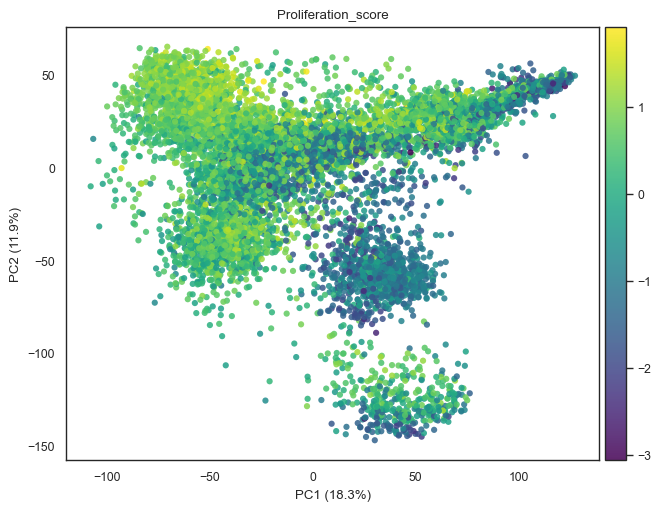

(<Figure size 650x500 with 2 Axes>,
 [<Axes: title={'center': 'Proliferation_score'}, xlabel='PC1 (18.3%)', ylabel='PC2 (11.9%)'>])

In [118]:
bk.pl.pca_scatter(
    adata,
    color="Proliferation_score",
    cmap="viridis",
)

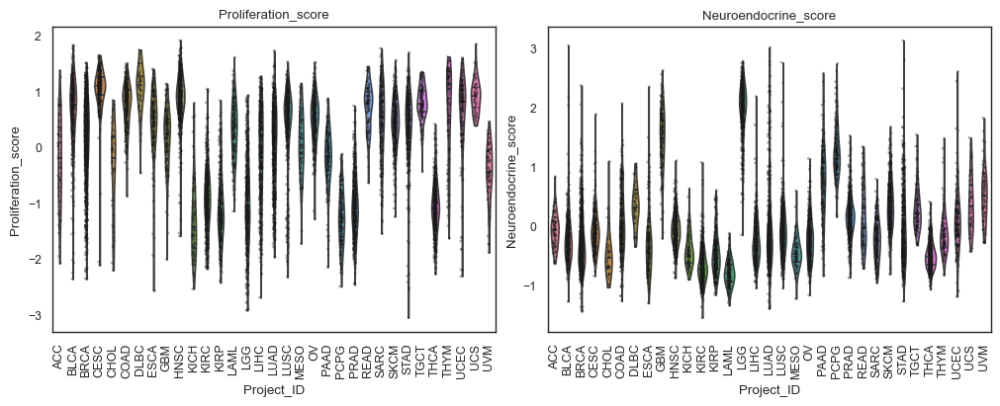

(<Figure size 1000x400 with 2 Axes>,
 array([<Axes: title={'center': 'Proliferation_score'}, xlabel='Project_ID', ylabel='Proliferation_score'>,
        <Axes: title={'center': 'Neuroendocrine_score'}, xlabel='Project_ID', ylabel='Neuroendocrine_score'>],
       dtype=object))

In [119]:
bk.pl.violin(
    adata,
    keys=["Proliferation_score", "Neuroendocrine_score"],
    groupby="Project_ID",
    figsize=(10,4),
    rotate_xticks=90,
)

### 6.2.2. A single signature

In [7]:
ne_score_25 = ['BEX1', 'ASCL1', 'INSM1', 'CHGA', 'TAGLN3', 'KIF5C', 'CRMP1', 'SCG3', 'SYT4', 'RTN1',
               'MYT1', 'SYP', 'KIF1A', 'TMSB15a', 'SYN1', 'SYT11', 'RUNDC3A', 'TFF3', 'CHGB', 'TLCD3B',
               'SH3GL2', 'BSN', 'SEZ6', 'TMSB15B', 'CELF3']


INFO: score_genes: stored 'NE25_score' in adata.obs (n_sig=23, n_ctrl=1110, layer=log1p_cpm)


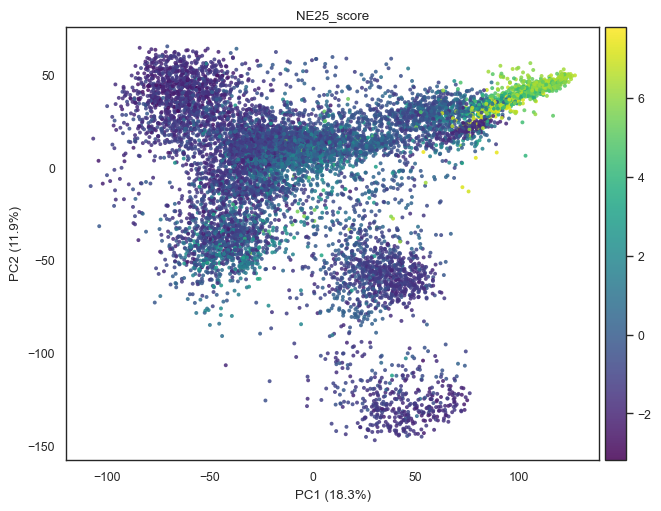

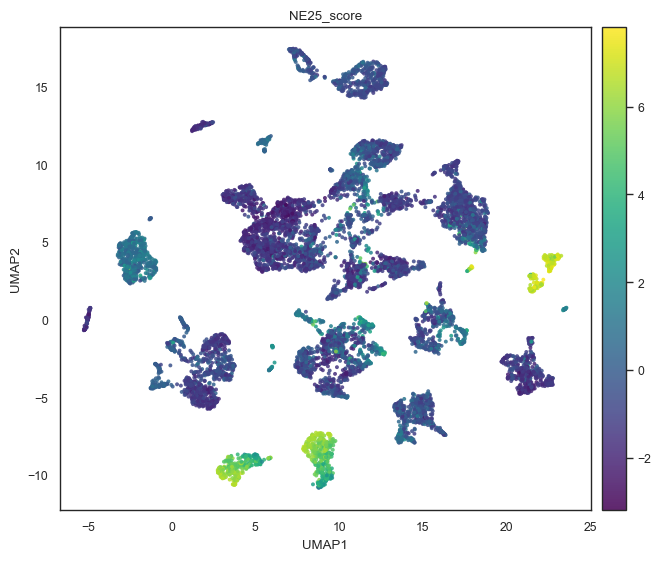

(<Figure size 650x550 with 2 Axes>,
 [<Axes: title={'center': 'NE25_score'}, xlabel='UMAP1', ylabel='UMAP2'>])

In [8]:
bk.tl.score_genes(adata, ne_score_25, score_name="NE25_score", layer="log1p_cpm")

# Plot on PCA/UMAP as continuous color (after your pca_scatter/umap changes)
bk.pl.pca_scatter(adata, color="NE25_score", cmap="viridis", point_size=8)
bk.pl.umap(adata, color="NE25_score", cmap="viridis", point_size=8)

### 6.3. Cell cycle status

This is not very informative in bulk RNAseq data and simply correlates with increased proliferation, but it may be useful to separate specific subgroups of proliferating vs. less proliferating samples in the same tumor type

In [127]:
# Example gene lists (use your preferred human cell-cycle sets)
s_genes = ["MCM5", "PCNA", "TYMS", "MCM2", "MCM4", "RRM1", "UNG", "GINS2"]
g2m_genes = ["HMGB2", "CDK1", "NUSAP1", "UBE2C", "BIRC5", "TPX2", "TOP2A"]

bk.tl.score_genes_cell_cycle(
    adata,
    s_genes=s_genes,
    g2m_genes=g2m_genes,
    layer="log1p_cpm",   # or whatever you use for expression scoring
    scale=True,          # optional; often helps if genes have different ranges
)

adata.obs[["S_score", "G2M_score", "phase"]].head()

INFO: score_genes: stored 'S_score' in adata.obs (n_sig=8, n_ctrl=387, layer=log1p_cpm)
INFO: score_genes: stored 'G2M_score' in adata.obs (n_sig=7, n_ctrl=347, layer=log1p_cpm)
INFO: score_genes_cell_cycle: stored obs['S_score'], obs['G2M_score'], obs['phase'] (layer=log1p_cpm, scale=True)


,S_score,G2M_score,phase
Sample_ID,,,
TCGA-S9-A7J2-01,-0.847903,-0.972469,G1
TCGA-G3-A3CH-11,-0.637804,-1.100115,G1
TCGA-EK-A2RE-01,1.475654,1.156046,S
TCGA-44-6778-01,0.346758,0.475727,G2M
TCGA-F4-6854-01,0.681045,0.929727,G2M


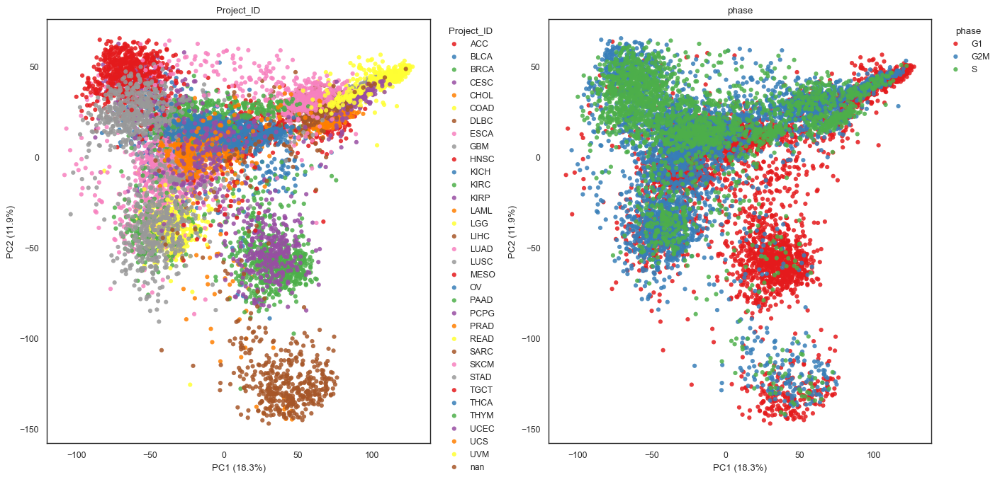

(<Figure size 1400x700 with 2 Axes>,
 array([<Axes: title={'center': 'Project_ID'}, xlabel='PC1 (18.3%)', ylabel='PC2 (11.9%)'>,
        <Axes: title={'center': 'phase'}, xlabel='PC1 (18.3%)', ylabel='PC2 (11.9%)'>],
       dtype=object))

In [128]:
bk.pl.pca_scatter(adata, color=["Project_ID", "phase"], figsize=(7,7))

# 7. Data Exploration
<a id="exploration"></a>

## 7.1. General bidimensional representation

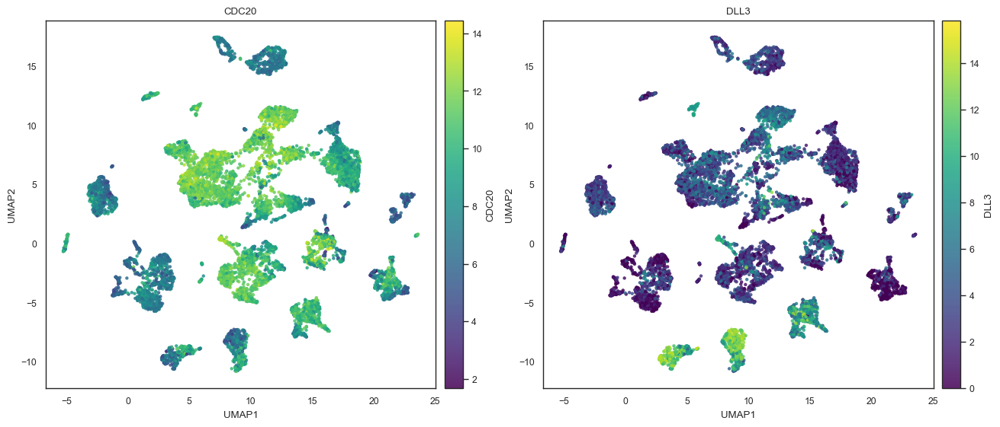

(<Figure size 1300x550 with 4 Axes>,
 array([<Axes: title={'center': 'CDC20'}, xlabel='UMAP1', ylabel='UMAP2'>,
        <Axes: title={'center': 'DLL3'}, xlabel='UMAP1', ylabel='UMAP2'>],
       dtype=object))

In [129]:
bk.pl.umap(adata, color=["CDC20", "DLL3"], point_size=10)

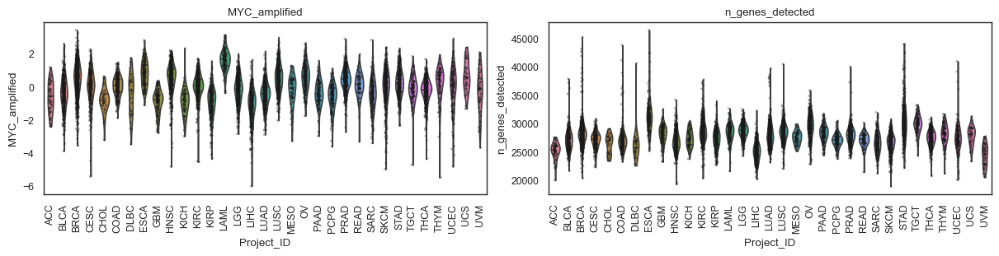

(<Figure size 1200x300 with 2 Axes>,
 array([<Axes: title={'center': 'MYC_amplified'}, xlabel='Project_ID', ylabel='MYC_amplified'>,
        <Axes: title={'center': 'n_genes_detected'}, xlabel='Project_ID', ylabel='n_genes_detected'>],
       dtype=object))

In [130]:
bk.pl.violin(
    adata,
    keys=["MYC_amplified", "n_genes_detected"],
    groupby="Project_ID",
    #order=["LumA", "LumB", "Her2", "Basal", "Normal"],
    figsize=(12, 3),
    rotate_xticks=90,
    #save="figs/violin_qc.png",
)

## 7.2. Select only one/a few categories

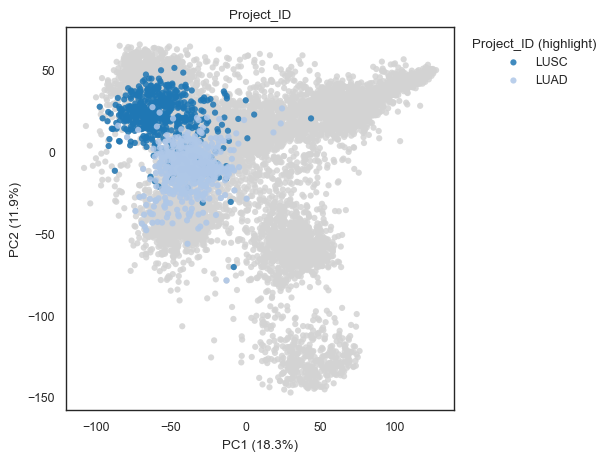

(<Figure size 600x450 with 1 Axes>,
 [<Axes: title={'center': 'Project_ID'}, xlabel='PC1 (18.3%)', ylabel='PC2 (11.9%)'>])

In [131]:
bk.pl.pca_scatter(
    adata,
    color="Project_ID",
    highlight=["LUSC", "LUAD"],
    palette="tab20",
    figsize=(6,4.5),
)

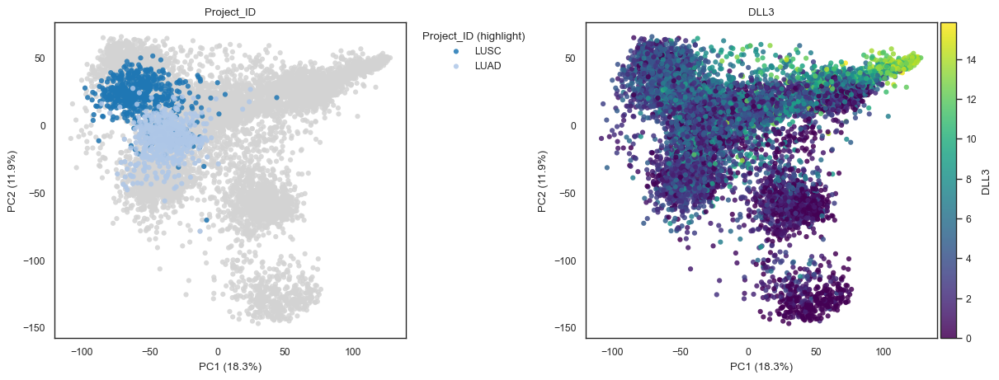

(<Figure size 1200x450 with 3 Axes>,
 array([<Axes: title={'center': 'Project_ID'}, xlabel='PC1 (18.3%)', ylabel='PC2 (11.9%)'>,
        <Axes: title={'center': 'DLL3'}, xlabel='PC1 (18.3%)', ylabel='PC2 (11.9%)'>],
       dtype=object))

In [132]:
bk.pl.pca_scatter(
    adata,
    color=["Project_ID", "DLL3"],
    highlight=["LUSC", "LUAD"],
    palette="tab20",
    figsize=(6,4.5),
)

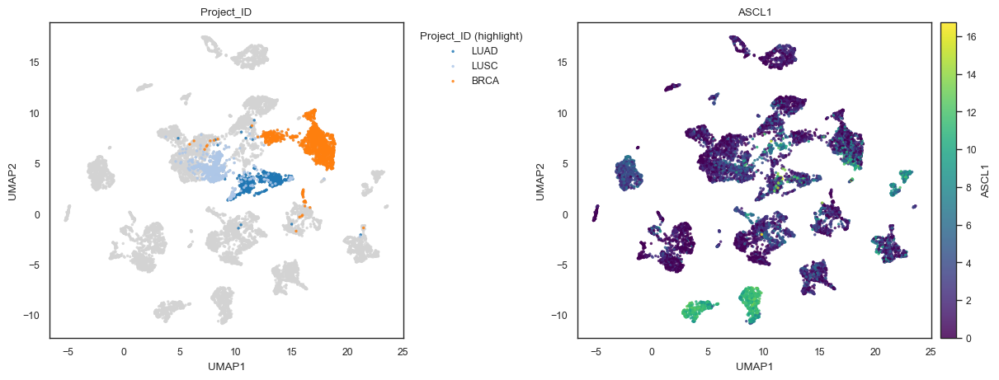

(<Figure size 1200x450 with 3 Axes>,
 array([<Axes: title={'center': 'Project_ID'}, xlabel='UMAP1', ylabel='UMAP2'>,
        <Axes: title={'center': 'ASCL1'}, xlabel='UMAP1', ylabel='UMAP2'>],
       dtype=object))

In [133]:
bk.pl.umap(
    adata,
    color=["Project_ID", "ASCL1"],
    highlight=["LUAD", "LUSC", "BRCA"],
    palette="tab20",
    figsize=(6,4.5),
    point_size=6,
)

## 7.3. Subfilters

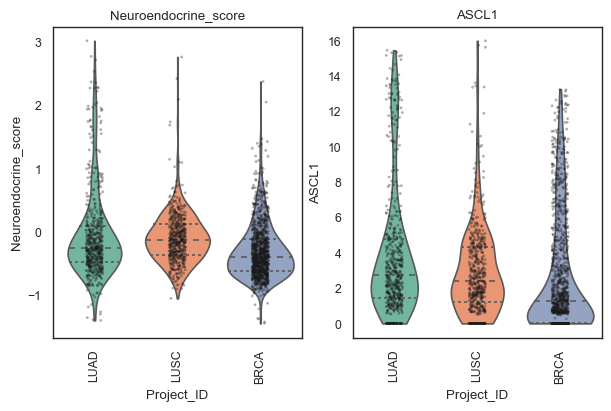

(<Figure size 600x400 with 2 Axes>,
 array([<Axes: title={'center': 'Neuroendocrine_score'}, xlabel='Project_ID', ylabel='Neuroendocrine_score'>,
        <Axes: title={'center': 'ASCL1'}, xlabel='Project_ID', ylabel='ASCL1'>],
       dtype=object))

In [134]:
bk.pl.violin(
    adata,
    keys=["Neuroendocrine_score", "ASCL1"],
    groupby="Project_ID",
    order=["LUAD", "LUSC", "BRCA"],
    figsize=(6,4),
    rotate_xticks=90,
    #save="figs/violin_qc.png",
)

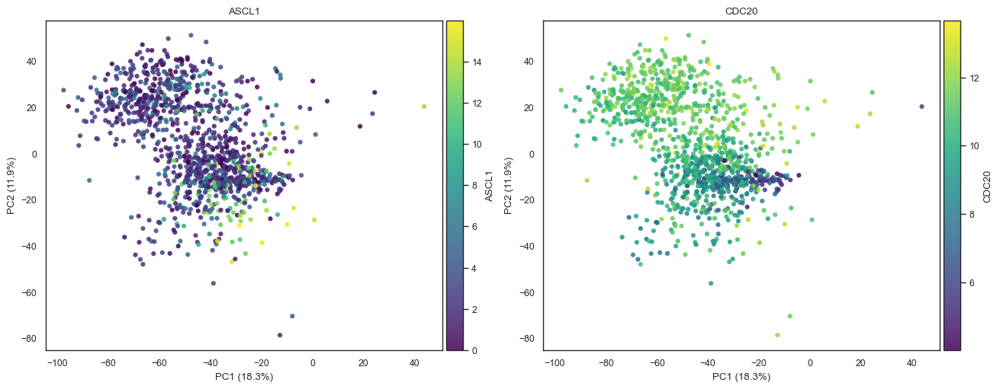

(<Figure size 1300x500 with 4 Axes>,
 array([<Axes: title={'center': 'ASCL1'}, xlabel='PC1 (18.3%)', ylabel='PC2 (11.9%)'>,
        <Axes: title={'center': 'CDC20'}, xlabel='PC1 (18.3%)', ylabel='PC2 (11.9%)'>],
       dtype=object))

In [136]:
bk.pl.pca_scatter(adata_lung, color=["ASCL1", "CDC20"])

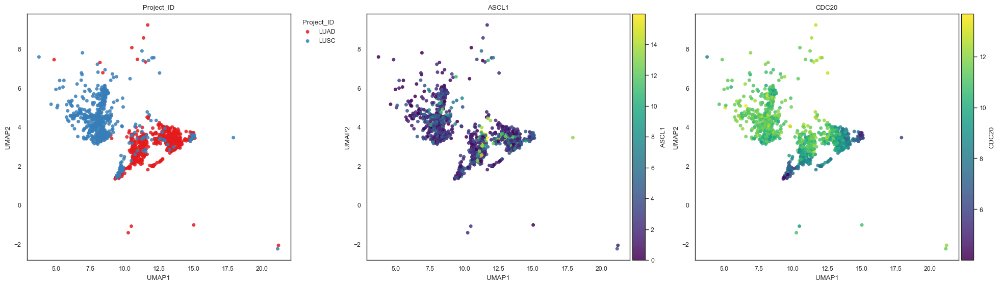

(<Figure size 1950x550 with 5 Axes>,
 array([<Axes: title={'center': 'Project_ID'}, xlabel='UMAP1', ylabel='UMAP2'>,
        <Axes: title={'center': 'ASCL1'}, xlabel='UMAP1', ylabel='UMAP2'>,
        <Axes: title={'center': 'CDC20'}, xlabel='UMAP1', ylabel='UMAP2'>],
       dtype=object))

In [137]:
bk.pl.umap(adata_lung, color=["Project_ID", "ASCL1", "CDC20"])

## 7.4. Correlations

### 7.4.1. Correlation heatmap

/Users/mmalumbres/mambaforge/envs/biopython/lib/python3.10/site-packages/seaborn/matrix.py:654: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/Users/mmalumbres/mambaforge/envs/biopython/lib/python3.10/site-packages/seaborn/matrix.py:654: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


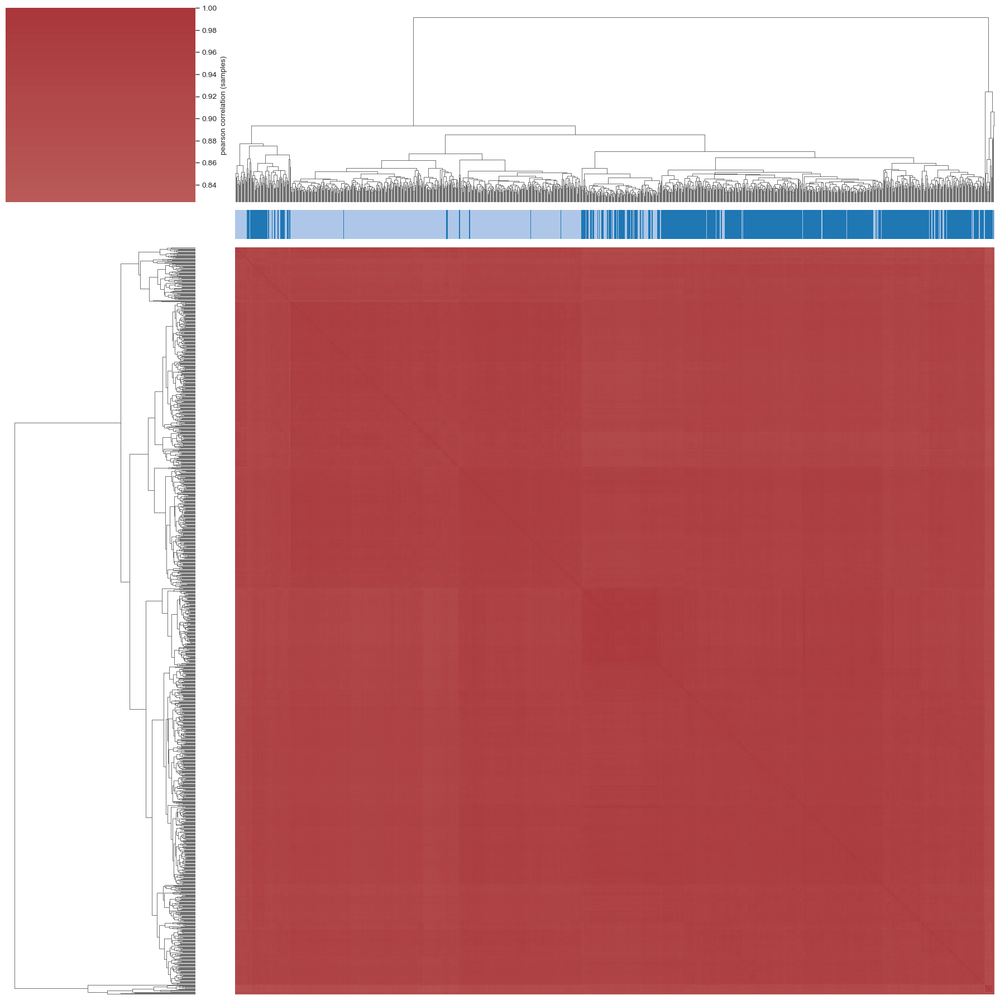

In [138]:
# 5) sample QC correlation heatmap
bk.pl.corr_heatmap(
    adata_lung,
    layer="log1p_cpm",
    method="pearson",
    groupby="Project_ID",
    col_colors="Project_ID",   # nice annotation
    #save="figs/corr_heatmap.png",
)

### 7.4.2. Find strongest correlations with numerical data

#### Gene–gene correlations

In [7]:
# 1) One gene vs ALL genes
df = bk.tl.gene_gene_correlations(
    adata,
    gene="DLL3",
    top_n=50000,
)
df.head(3)

,query_gene,gene,r,pval,n,qval,method,batch_key,batch_mode
0,DLL3,GDF1,0.687070,0.0,10534,0.0,pearson,None,none
1,DLL3,DPF1,0.656359,0.0,10534,0.0,pearson,None,none
2,DLL3,LINC00634,0.653721,0.0,10534,0.0,pearson,None,none


In [8]:
df.tail(5)

,query_gene,gene,r,pval,n,qval,method,batch_key,batch_mode
49995,DLL3,RPSAP64,-0.004006,0.681003,10534,0.716500,pearson,None,none
49996,DLL3,CCR1,-0.004005,0.681052,10534,0.716537,pearson,None,none
49997,DLL3,FCF1P4,-0.004005,0.681101,10534,0.716562,pearson,None,none
49998,DLL3,RNU5F-1,-0.004005,0.681103,10534,0.716562,pearson,None,none
49999,DLL3,RP11-463M16.5,0.004004,0.681117,10534,0.716562,pearson,None,none


<Axes: ylabel='r'>

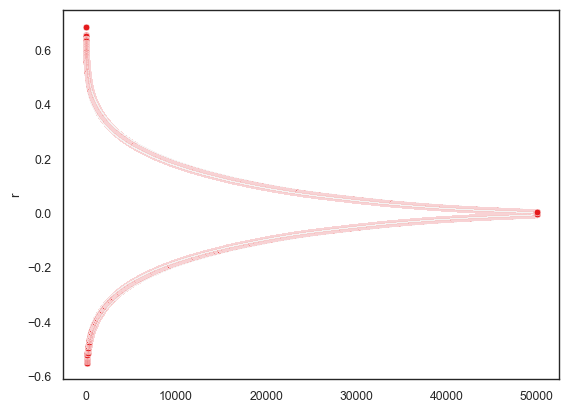

In [9]:
# Volcano-style plot
sns.scatterplot(x=df.index, y=df["r"],)

<Axes: xlabel='r'>

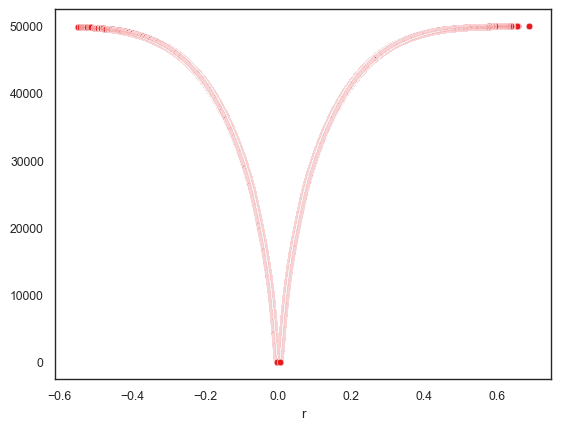

In [10]:
sns.scatterplot(y=df.index[::-1], x=df["r"],)

In [11]:
# 2) One gene vs a pathway / gene list

gene_list = ["DLL3", "SOX2", "NEUROD1", "MYCL", "RB1", "MYC", "YAP1"]

df = bk.tl.gene_gene_correlations(
    adata,
    gene="ASCL1",
    genes=gene_list,
)
df

,query_gene,gene,r,pval,n,qval,method,batch_key,batch_mode
0,ASCL1,NEUROD1,0.547992,0.000000e+00,10534,0.000000e+00,pearson,None,none
1,ASCL1,DLL3,0.479537,0.000000e+00,10534,0.000000e+00,pearson,None,none
2,ASCL1,SOX2,0.432899,0.000000e+00,10534,0.000000e+00,pearson,None,none
3,ASCL1,YAP1,-0.216790,2.894460e-112,10534,5.065305e-112,pearson,None,none
4,ASCL1,MYC,-0.164095,1.766614e-64,10534,2.473259e-64,pearson,None,none
5,ASCL1,MYCL,0.080813,9.828895e-17,10534,1.146704e-16,pearson,None,none
6,ASCL1,RB1,-0.026361,6.814782e-03,10534,6.814782e-03,pearson,None,none


#### Batch-aware correlation between genes and observations

In [ ]:
# 1) Residualize batch (+ optional covariates) then correlate
df = bk.tl.gene_gene_correlations(
    adata, gene="ASCL1", layer="log1p_cpm",
    batch_key="Batch",                                 # if bactches present
    batch_mode="residualize",
)

In [ ]:
# 2) Z-score within each batch, then correlate pooled
df = bk.tl.gene_gene_correlations(
    adata, gene="ASCL1",
    batch_key="Batch", batch_mode="within_batch",
)

In [ ]:
# 3) Meta-analyze correlations across batches
df = bk.tl.gene_gene_correlations(
    adata, gene="ASCL1",
    batch_key="Batch", batch_mode="meta",
)

#### Gene versus Observations Correlations

In [12]:
# One gene vs all numeric metadata

df_go = bk.tl.top_gene_obs_correlations(
    adata,
    gene="DLL3",
    layer="log1p_cpm",
    method="spearman",
    top_n=1000,
)
df_go.head()

/Users/mmalumbres/Library/CloudStorage/OneDrive-VHIO/BioInformatics/BioProjects/MM01_BULLKpy/bullkpy-skeleton/src/bullkpy/tl/correlations.py:140: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  r, p = spearmanr(x[m], y[m], nan_policy="omit")


,gene,obs,r,pval,n,qval,method,batch_key,batch_mode
0,DLL3,asbestos_exposure_age_last,0.644357,0.061033,9,0.072647,spearman,None,none
1,DLL3,Neuroendocrine_score,0.603009,0.000000,10534,0.000000,spearman,None,none
2,DLL3,asbestos_exposure_age,0.446018,0.146136,12,0.165884,spearman,None,none
3,DLL3,RETINOL_METABOLISM,-0.388674,0.000000,10194,0.000000,spearman,None,none
4,DLL3,VEGF_PATHWAY,-0.386605,0.000000,10194,0.000000,spearman,None,none


In [13]:
df_go.tail()

,gene,obs,r,pval,n,qval,method,batch_key,batch_mode
289,DLL3,MYC_mut,-0.001734,0.873265,8463,0.888373,spearman,None,none
290,DLL3,YAP1_mut,-0.001171,0.914255,8463,0.923672,spearman,None,none
291,DLL3,CCND1_mut,0.001154,0.915431,8463,0.923672,spearman,None,none
292,DLL3,kmeans_10,-0.001011,0.917388,10534,0.923672,spearman,None,none
293,DLL3,MYC_amplified,-0.000877,0.929460,10194,0.932632,spearman,None,none


<Axes: xlabel='r'>

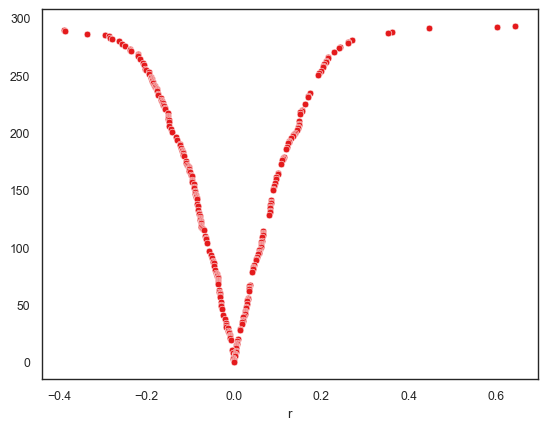

In [14]:
# Volcano-style plot
sns.scatterplot(y=df_go.index[::-1], x=df_go["r"],)

In [28]:
df_go = bk.tl.top_gene_obs_correlations(
    adata,
    gene="RB1",
    layer="log1p_cpm",
    method="spearman",
    top_n=60000,
)
df_go = df_go.sort_values(by="r", ascending=False)
df_go.head(10)

/Users/mmalumbres/Library/CloudStorage/OneDrive-VHIO/BioInformatics/BioProjects/MM01_BULLKpy/bullkpy-skeleton/src/bullkpy/tl/correlations.py:140: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  r, p = spearmanr(x[m], y[m], nan_policy="omit")


,gene,obs,r,pval,n,qval,method,batch_key,batch_mode
0,RB1,MYC_amplified,0.398919,0.000000e+00,10194,0.000000e+00,spearman,None,none
2,RB1,GP3_Tumor_suppressing_miRNA_targets,0.382611,0.000000e+00,10194,0.000000e+00,spearman,None,none
3,RB1,RB_PATHWAY,0.347591,2.389882e-287,10194,2.342085e-285,spearman,None,none
4,RB1,13q,0.329098,4.264420e-196,7788,1.567174e-194,spearman,None,none
5,RB1,chr13,0.329098,4.264420e-196,7788,1.567174e-194,spearman,None,none
6,RB1,n_genes_detected,0.319131,5.445399e-248,10534,4.002368e-246,spearman,None,none
7,RB1,RAS_PATHWAY,0.308493,1.197690e-223,10194,7.042420e-222,spearman,None,none
8,RB1,ALK_PATHWAY,0.290023,9.555320e-197,10194,4.682107e-195,spearman,None,none
9,RB1,asbestos_exposure_age_last,0.266667,4.879223e-01,9,5.293327e-01,spearman,None,none
10,RB1,Immune_NSCLC_score,0.258981,6.801010e-156,10194,2.221663e-154,spearman,None,none


In [38]:
df_go.tail(15)

,gene,obs,r,pval,n,qval,method,batch_key,batch_mode
70,RB1,PD1_SIGNALING,-0.127876,1.990392e-38,10194,9.002697e-38,spearman,None,none
68,RB1,3p,-0.129386,2.602763e-31,8027,1.006858e-30,spearman,None,none
51,RB1,diagnoses.year_of_diagnosis,-0.150708,1.069503e-53,10362,6.835520e-53,spearman,None,none
50,RB1,initial_pathologic_dx_year,-0.150747,1.016900e-53,10361,6.643746e-53,spearman,None,none
47,RB1,NE25_score,-0.154030,6.131690e-57,10534,4.097084e-56,spearman,None,none
46,RB1,Neuroendocrine_score,-0.156832,5.478429e-59,10534,3.745716e-58,spearman,None,none
45,RB1,leiden_0.4,-0.162069,6.385504e-63,10534,4.469853e-62,spearman,None,none
42,RB1,RB1_mut,-0.166202,1.778777e-53,8463,1.111797e-52,spearman,None,none
35,RB1,IGF1R_PATHWAY,-0.174507,1.621550e-70,10194,1.444653e-69,spearman,None,none
32,RB1,GP5_MYC_targets/TERT,-0.180469,2.286266e-75,10194,2.240541e-74,spearman,None,none


<Axes: xlabel='r'>

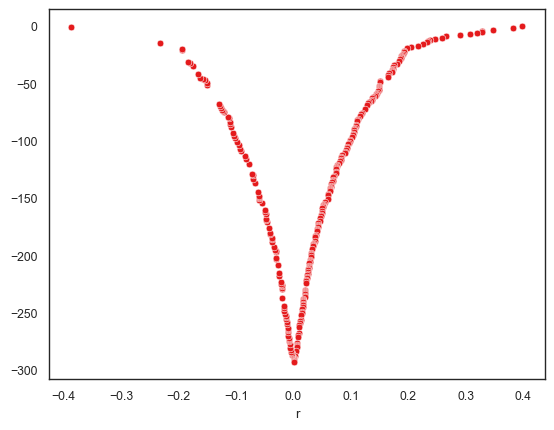

In [33]:
# Volcano-style plot
sns.scatterplot(y=-df_go.index, x=df_go["r"],)

/Users/mmalumbres/mambaforge/envs/biopython/lib/python3.10/site-packages/pandas/core/arraylike.py:402: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


<Axes: xlabel='r', ylabel='qval'>

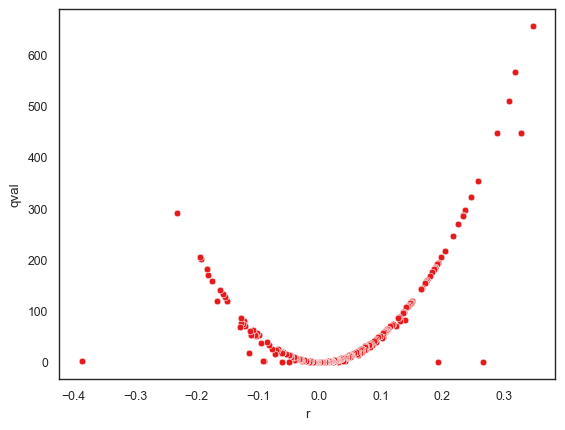

In [34]:
# Volcano-style plot
sns.scatterplot(y=-np.log(df_go["qval"]), x=df_go["r"],)

#### Wide matrix (focus × against) + p/q matrices

In [39]:
selected_obs = "NE25_score",                         # One: "Purity" or several: ["Purity", "TMB"]
obs_list = ["OS.time", "DSS.time", "PFI.time", 
            "PFI.time.1", "PFI.time.2", "PFS.time", "DSS.time.cr", "DFI.time.cr", "PFI.time.1.cr",
            "PFI.time.2.cr",
            "mitotic_count", 
            "Interferon_19272155", "ai1", "lst1", "hrd-loh", "HRD", "S_score",
            "GP2_Immune-Tcell/Bcell", "Leuk", "Stroma", "purity", "ploidy",
            "exposures.cigarettes_per_day", "exposures.pack_years_smoked", "exposures.years_smoked",
            "number_pack_years_smoked", "age_began_smoking_in_years",
            "exposures.alcohol_history", "frequency_of_alcohol_consumption", "amount_of_alcohol_consumption_per_day",
            "amt_alcohol_consumption_per_day",
            "asbestos_exposure_age", "asbestos_exposure_years", "asbestos_exposure_age_last",
           ]

# If necessary:
#adata.obs[obs_list] = adata.obs[obs_list].apply(pd.to_numeric, errors="coerce")
#adata.obs[obs_list] = adata.obs[obs_list].astype(float)          # float, int, "category"

In [42]:
R, P, Q = bk.tl.obs_obs_corr_matrix(
    adata, focus=selected_obs, against=obs_list, return_p=True, return_q=True,)

res = pd.concat([R, P, Q], keys=["R", "p-val", "q-val"], #names=["source", "row"]
)
res.index = res.index.droplevel(1)
res = res.T.sort_values(by="R", ascending=False)
res

,R,p-val,q-val
asbestos_exposure_years,0.567641,2.181642e-02,3.999677e-02
asbestos_exposure_age_last,0.396861,2.902566e-01,3.547581e-01
amt_alcohol_consumption_per_day,0.275576,1.268589e-01,1.744310e-01
purity,0.174058,2.322767e-64,9.581412e-64
frequency_of_alcohol_consumption,0.114633,2.304010e-02,4.001701e-02
age_began_smoking_in_years,0.061806,2.515527e-01,3.320496e-01
exposures.cigarettes_per_day,0.001252,9.581148e-01,9.880559e-01
exposures.pack_years_smoked,0.001252,9.581148e-01,9.880559e-01
number_pack_years_smoked,0.000125,9.958188e-01,9.958188e-01
DFI.time.cr,-0.013202,3.355024e-01,3.954136e-01


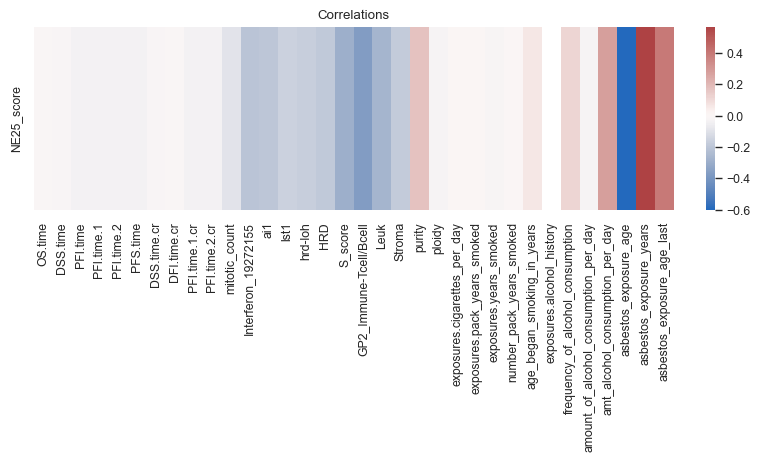

(<Figure size 750x450 with 2 Axes>, <Axes: title={'center': 'Correlations'}>)

In [43]:
bk.tl.plot_corr_heatmap(R, title="Correlations")

In [44]:
df_plot = res.copy()

# Drop missing values
df_plot = df_plot.dropna(subset=["R", "q-val"])

# Handle q = 0
df_plot["q-val"] = df_plot["q-val"].clip(lower=1e-300)

# Size metric
df_plot["minus_log10_q"] = -np.log10(df_plot["q-val"])

# Order (Scanpy-like: by effect size)
df_plot = df_plot.sort_values("R")

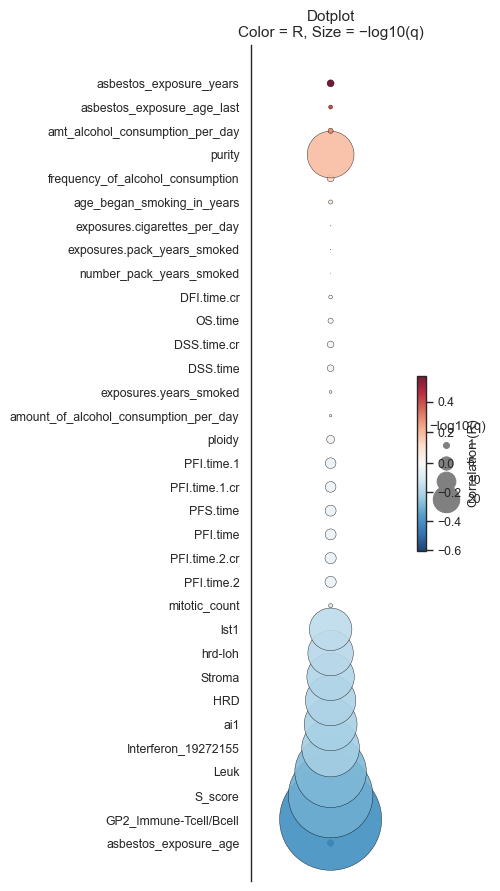

In [45]:
import matplotlib.pyplot as plt
from matplotlib.colors import TwoSlopeNorm

fig, ax = plt.subplots(figsize=(5, 9))

# Normalize color around 0
norm = TwoSlopeNorm(
    vmin=df_plot["R"].min(),
    vcenter=0,
    vmax=df_plot["R"].max()
)

sc = ax.scatter(
    x=np.zeros(len(df_plot)),             # single column like Scanpy
    y=np.arange(len(df_plot)),
    s=df_plot["minus_log10_q"] * 18,       # size scaling
    c=df_plot["R"],
    cmap="RdBu_r",
    norm=norm,
    edgecolors="black",
    linewidths=0.3,
    alpha=0.9
)

# Y axis labels
ax.set_yticks(np.arange(len(df_plot)))
ax.set_yticklabels(df_plot.index)

# Remove x-axis clutter
ax.set_xticks([])
ax.set_xlabel("")

# Frame cleanup
ax.spines["top"].set_visible(False)
ax.spines["right"].set_visible(False)
ax.spines["bottom"].set_visible(False)

# Colorbar
cbar = plt.colorbar(sc, ax=ax, fraction=0.05, pad=0.04)
cbar.set_label("Correlation (R)")

ax.set_title("Dotplot\nColor = R, Size = −log10(q)", fontsize=11)

# Add legend
for s in [1, 5, 10, 20]:
    ax.scatter([], [], s=s*18, c="grey", label=f"{s}")

ax.legend(
    title="−log10(q)",
    frameon=False,
    bbox_to_anchor=(1.05, 0.5),
    loc="center left"
)

plt.tight_layout()
plt.show()


#### Plot scatter with hue

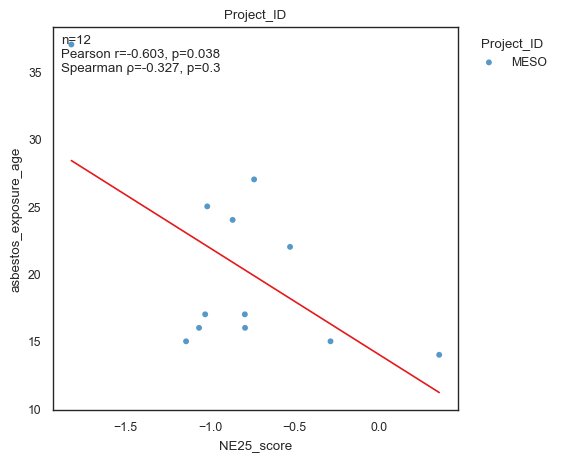

(<Figure size 550x450 with 1 Axes>,
 array([<Axes: title={'center': 'Project_ID'}, xlabel='NE25_score', ylabel='asbestos_exposure_age'>],
       dtype=object),
 [{'n': 12,
   'pearson_r': -0.6025907351393215,
   'pearson_p': 0.03810358196983384,
   'spearman_rho': -0.3268938230127368,
   'spearman_p': 0.29968036431149186,
   'slope': -7.893771887311972,
   'intercept': 14.028465233935872}])

In [46]:
bk.pl.corrplot_obs(
    adata,
    x="NE25_score",
    y="asbestos_exposure_age",
    color="Project_ID",
    cmap="viridis",
)

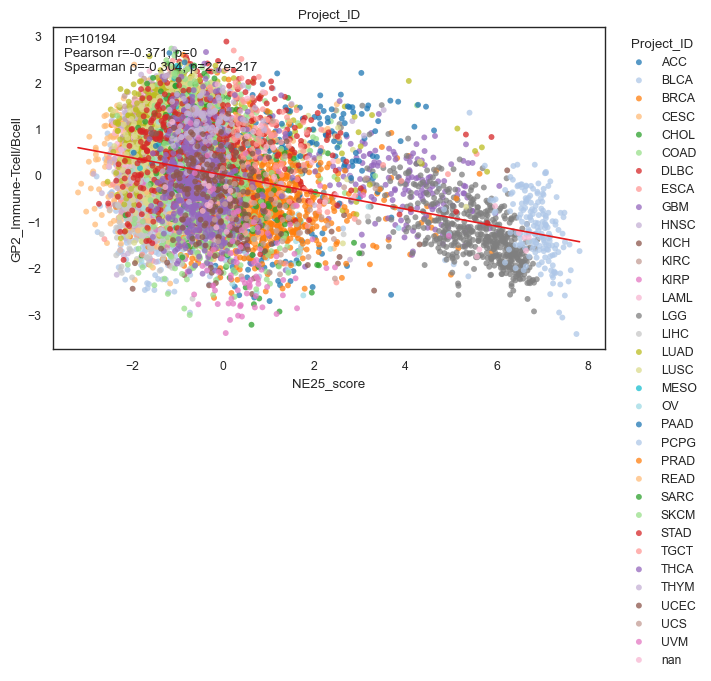

(<Figure size 700x600 with 1 Axes>,
 array([<Axes: title={'center': 'Project_ID'}, xlabel='NE25_score', ylabel='GP2_Immune-Tcell/Bcell'>],
       dtype=object),
 [{'n': 10194,
   'pearson_r': -0.3708946600312996,
   'pearson_p': 0.0,
   'spearman_rho': -0.30425574549600226,
   'spearman_p': 2.6672834429380435e-217,
   'slope': -0.18407344748214197,
   'intercept': 0.00590503043795062}])

In [47]:
bk.pl.corrplot_obs(
    adata,
    x="NE25_score",
    y="GP2_Immune-Tcell/Bcell",
    color="Project_ID",
    cmap="viridis",
    figsize=(7,6)
)

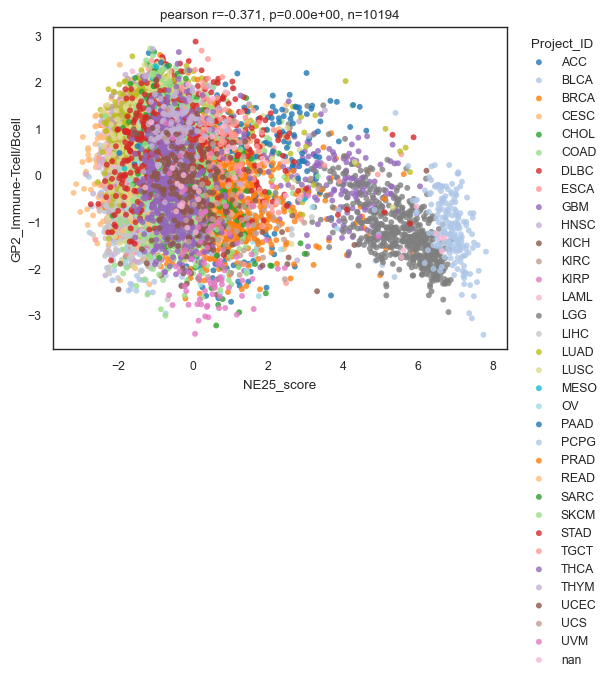

(<Figure size 600x600 with 1 Axes>,
 <Axes: title={'center': 'pearson r=-0.371, p=0.00e+00, n=10194'}, xlabel='NE25_score', ylabel='GP2_Immune-Tcell/Bcell'>)

In [48]:
bk.tl.plot_corr_scatter(
    adata,
    x="NE25_score",
    y="GP2_Immune-Tcell/Bcell",                      # asbestos_exposure_age
    hue="Project_ID",      # categorical
    kind="obs_obs",
    figsize=(6,6)
)

#### Quick correlations without statistics

In [49]:
# Numeric obs vs numeric obs (top pairs)

selected_obs = ["NE25_score", "purity"]                  # single: "purity" or list: ["NE25_score", "purity"]

mat = bk.tl.obs_obs_corr_matrix(adata, focus=selected_obs)
mat.T.sort_values(by=selected_obs, ascending=False)

,NE25_score,purity
Neuroendocrine_score,0.815772,0.121063
GP14_Plasma_membrane_cell-cell_signaling,0.756316,-0.077474
asbestos_exposure_years,0.567641,0.009374
leiden_0.2,0.504349,0.230729
GP15_EGF_signailng,0.452037,-0.152720
...,...,...
exposures.alcohol_history,NaN,NaN
exposures.created_datetime,NaN,NaN
days_to_last_known_alive,NaN,NaN
Unnamed: 1061,NaN,NaN


In [50]:
# Explicit focus × explicit against

focus=["NE25_score", "purity"]
against=["OS.time", "PFI.time", "DSS.time"]

mat = bk.tl.obs_obs_corr_matrix(adata, focus=focus, against=against,)
mat

,OS.time,PFI.time,DSS.time
NE25_score,-0.015300,-0.037279,-0.020918
purity,0.017287,-0.006304,0.021678


<Axes: >

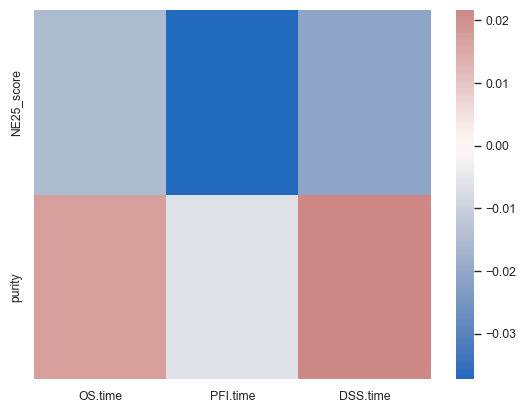

In [51]:
# Heatmap
sns.heatmap(mat, cmap="vlag", center=0)

### 7.4.3. Correlation Plots

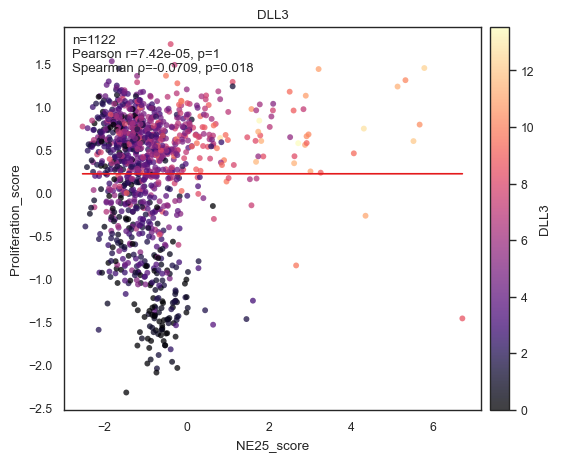

(<Figure size 550x450 with 2 Axes>,
 array([<Axes: title={'center': 'DLL3'}, xlabel='NE25_score', ylabel='Proliferation_score'>],
       dtype=object),
 [{'n': 1122,
   'pearson_r': 7.417901680064481e-05,
   'pearson_p': 0.9980196919197387,
   'spearman_rho': -0.07086313054853514,
   'spearman_p': 0.017597048900534748,
   'slope': 5.1817214761226566e-05,
   'intercept': 0.2192199586774967}])

In [52]:
#Color by gene expression (continuous colormap)
bk.pl.corrplot_obs(
    adata_lung,
    x="NE25_score",              # "Neuroendocrine_score"
    y="Proliferation_score",
    color="DLL3",          # gene in adata.var_names
    layer="log1p_cpm",
    cmap="magma",
)

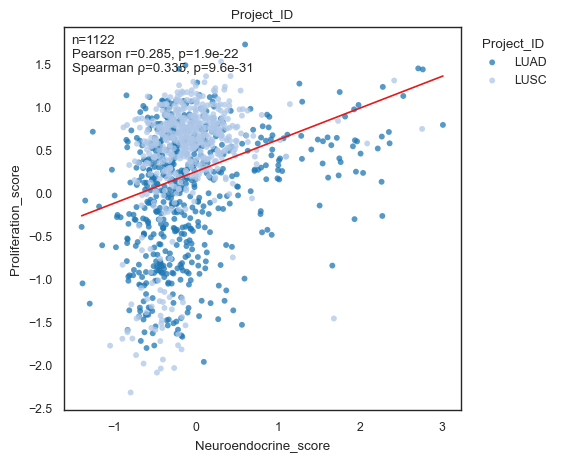

(<Figure size 550x450 with 1 Axes>,
 array([<Axes: title={'center': 'Project_ID'}, xlabel='Neuroendocrine_score', ylabel='Proliferation_score'>],
       dtype=object),
 [{'n': 1122,
   'pearson_r': 0.28523160548334237,
   'pearson_p': 1.905213040533741e-22,
   'spearman_rho': 0.3345589990202715,
   'spearman_p': 9.555423767627166e-31,
   'slope': 0.3686198024643119,
   'intercept': 0.24858805823473168}])

In [53]:
#Color by categorical metadata
bk.pl.corrplot_obs(
    adata_lung,
    x="Neuroendocrine_score",
    y="Proliferation_score",
    color="Project_ID",
    palette="tab20",
)

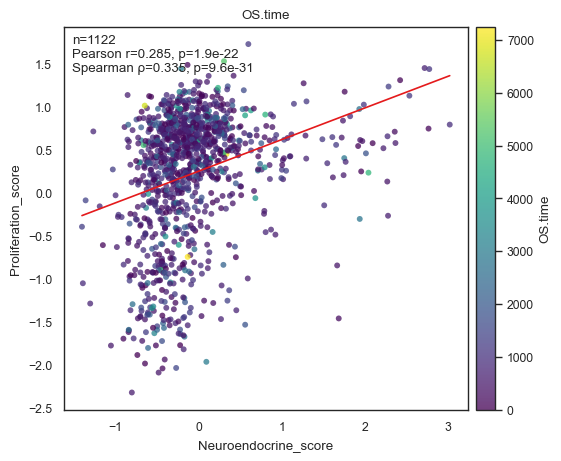

(<Figure size 550x450 with 2 Axes>,
 array([<Axes: title={'center': 'OS.time'}, xlabel='Neuroendocrine_score', ylabel='Proliferation_score'>],
       dtype=object),
 [{'n': 1122,
   'pearson_r': 0.28523160548334237,
   'pearson_p': 1.905213040533741e-22,
   'spearman_rho': 0.3345589990202715,
   'spearman_p': 9.555423767627166e-31,
   'slope': 0.3686198024643119,
   'intercept': 0.24858805823473168}])

In [54]:
#Color by numerical metadata
bk.pl.corrplot_obs(
    adata_lung,
    x="Neuroendocrine_score",
    y="Proliferation_score",
    color="OS.time",
    cmap="viridis",
)

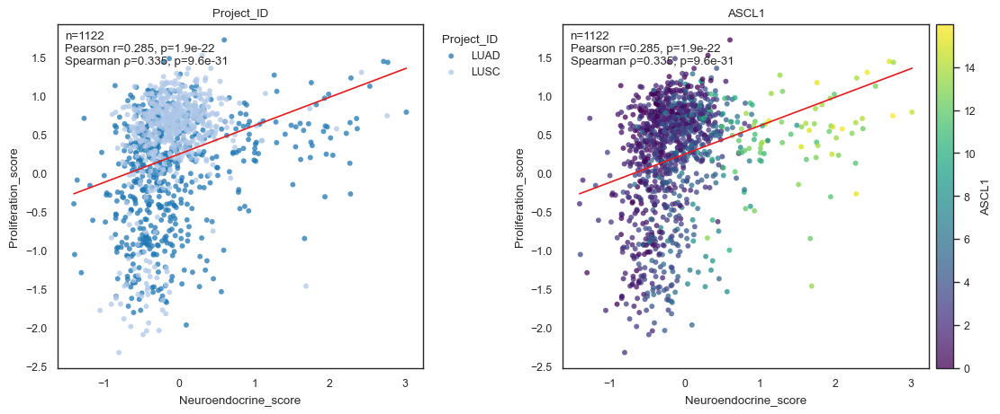

(<Figure size 1100x450 with 3 Axes>,
 array([<Axes: title={'center': 'Project_ID'}, xlabel='Neuroendocrine_score', ylabel='Proliferation_score'>,
        <Axes: title={'center': 'ASCL1'}, xlabel='Neuroendocrine_score', ylabel='Proliferation_score'>],
       dtype=object),
 [{'n': 1122,
   'pearson_r': 0.28523160548334237,
   'pearson_p': 1.905213040533741e-22,
   'spearman_rho': 0.3345589990202715,
   'spearman_p': 9.555423767627166e-31,
   'slope': 0.3686198024643119,
   'intercept': 0.24858805823473168},
  {'n': 1122,
   'pearson_r': 0.28523160548334237,
   'pearson_p': 1.905213040533741e-22,
   'spearman_rho': 0.3345589990202715,
   'spearman_p': 9.555423767627166e-31,
   'slope': 0.3686198024643119,
   'intercept': 0.24858805823473168}])

In [55]:
# Using hue instead of color
bk.pl.corrplot_obs(adata_lung,     
                   x="Neuroendocrine_score",
                   y="Proliferation_score",
                   hue=["Project_ID", "ASCL1"],
                   #figsize=(5,5),
                  )

### 7.4.4. Statistics between categorical data

In [ ]:
one single function
Practical advice (bulk RNA-seq)
	•	Prefer Kruskal–Wallis over ANOVA (non-normal)
	•	Always report effect size, not only p-values
	•	For clusters: ARI + Cramér’s V together is ideal
	•	Avoid Pearson with categorical encodings

#### Gene ↔ categorical (screen genes associated with subtype)

In [56]:
dfg = bk.tl.gene_categorical_association(
    adata,
    genes=["DLL3", "SOX10", "CDC20"],
    groupby="Project_ID",
    layer="log1p_cpm",
    method="kruskal",
    effect_size="epsilon2",
)
dfg

INFO: gene_categorical_association: 3 genes vs Project_ID (34 groups), method=kruskal


,groupby,gene,statistic,pval,effect,n_groups,n,group_means,qval
0,Project_ID,DLL3,5096.269017,0.0,0.482216,34,10534,"{'ACC': 3.573218181818182, 'BLCA': 3.314960179...",0.0
1,Project_ID,SOX10,6122.513829,0.0,0.579954,34,10534,"{'ACC': 0.36864545454545455, 'BLCA': 1.5780221...",0.0
2,Project_ID,CDC20,6386.193160,0.0,0.605066,34,10534,"{'ACC': 7.902002597402596, 'BLCA': 11.04651675...",0.0


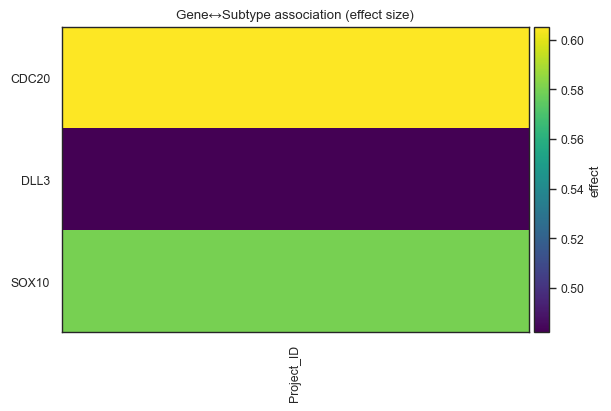

(<Figure size 600x400 with 2 Axes>,
 <Axes: title={'center': 'Gene↔Subtype association (effect size)'}>)

In [57]:
#Plot a heatmap of effects:
bk.pl.association_heatmap(
    dfg,
    index="gene",
    columns="groupby",
    values="effect",
    title="Gene↔Subtype association (effect size)",
)

#### Numeric obs ↔ categorical (which metadata differs across clusters)

In [58]:
dfo = bk.tl.obs_categorical_association(
    adata,
    obs_keys=["NE25_score"],                   # all numeric obs
    groupby="Project_ID",
    method="kruskal",
)
dfo.head(20)

INFO: obs_categorical_association: 1 numeric obs vs Project_ID (34 groups), method=kruskal


,groupby,obs,statistic,pval,effect,n_groups,n,group_means,qval
0,Project_ID,NE25_score,5890.059108,0.0,0.557815,34,10534,"{'ACC': 1.0220554141041098, 'BLCA': -1.2558328...",0.0


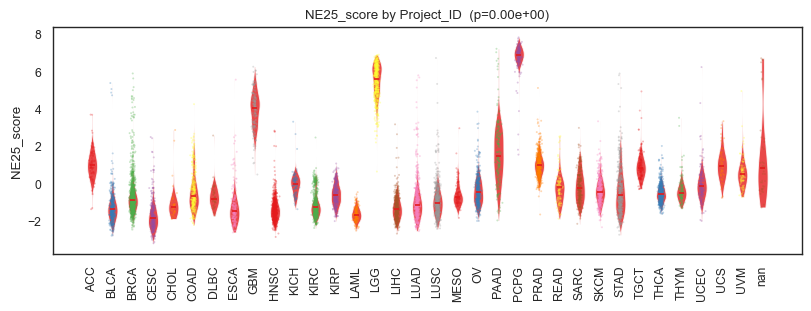

(<Figure size 800x300 with 1 Axes>,
 <Axes: title={'center': 'NE25_score by Project_ID  (p=0.00e+00)'}, ylabel='NE25_score'>)

In [59]:
#Plot one variable with a p-value:
bk.pl.boxplot_with_stats(
    adata,
    y="NE25_score",
    groupby="Project_ID",
    kind="violin",
    figsize=(8, 3),
)

In [60]:
dfo = bk.tl.obs_categorical_association(
    adata,
    obs_keys=["NE25_score"],                   # all numeric obs
    groupby="RB1_mut",
    method="kruskal",
)
dfo.head(20)

INFO: obs_categorical_association: 1 numeric obs vs RB1_mut (3 groups), method=kruskal


,groupby,obs,statistic,pval,effect,n_groups,n,group_means,qval
0,RB1_mut,NE25_score,18.260087,0.000108,0.001544,3,10534,"{'0.0': 0.04806304637641443, '1.0': -0.3658405...",0.000108


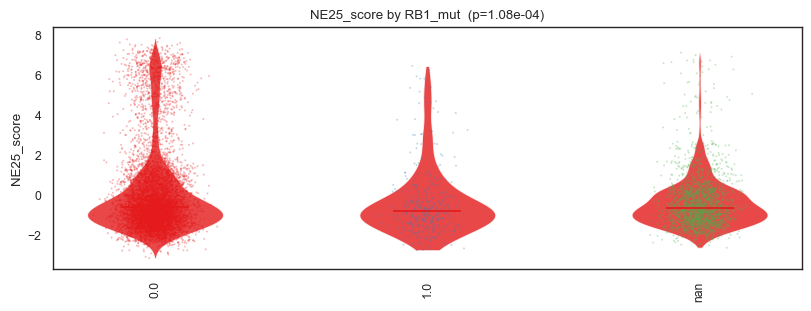

(<Figure size 800x300 with 1 Axes>,
 <Axes: title={'center': 'NE25_score by RB1_mut  (p=1.08e-04)'}, ylabel='NE25_score'>)

In [61]:
#Plot one variable with a p-value:
bk.pl.boxplot_with_stats(
    adata,
    y="NE25_score",
    groupby="RB1_mut",
    kind="violin",
    figsize=(8, 3),
)

#### Categorical ↔ categorical (Project vs Leiden)

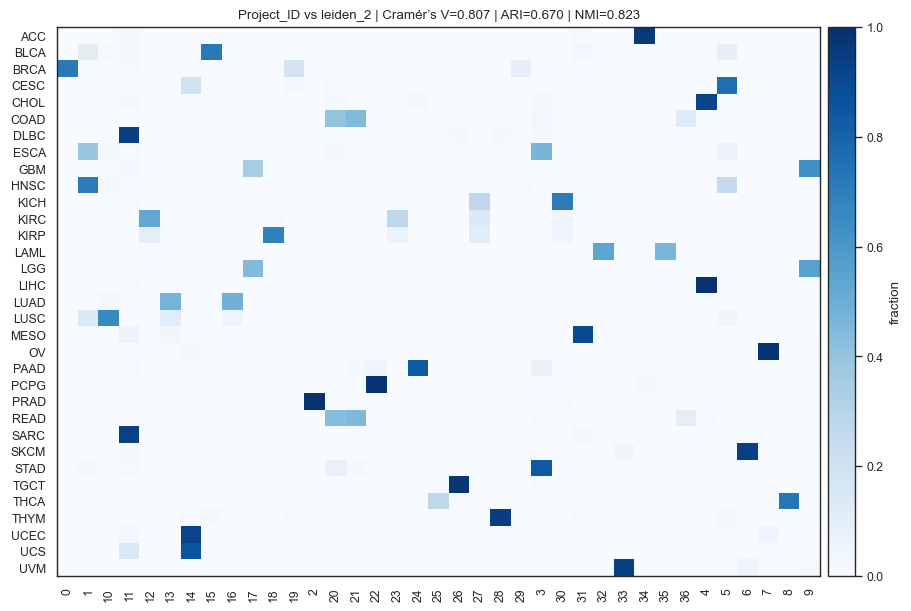

(<Figure size 900x600 with 2 Axes>,
 <Axes: title={'center': 'Project_ID vs leiden_2 | Cramér’s V=0.807 | ARI=0.670 | NMI=0.823'}>)

In [62]:
bk.pl.categorical_confusion(
    adata,
    key1="Project_ID",
    key2="leiden_2",
    normalize="row",
    figsize=(9, 6),
)

In [63]:
# Run leiden to df
df = bk.tl.leiden_resolution_scan(
    adata,
    true_key="Project_ID",
    resolutions=[0.2, 0.4, 0.6, 0.8, 1.0, 1.2, 1.5, 2.0],
    base_key="leiden",
)

INFO: Leiden resolution=0.2
INFO: Clustering with Leiden (resolution=0.2)
INFO: Leiden produced 16 clusters stored in adata.obs['leiden_0.2'].
INFO: Leiden resolution=0.4
INFO: Clustering with Leiden (resolution=0.4)
INFO: Leiden produced 21 clusters stored in adata.obs['leiden_0.4'].
INFO: Leiden resolution=0.6
INFO: Clustering with Leiden (resolution=0.6)
INFO: Leiden produced 23 clusters stored in adata.obs['leiden_0.6'].
INFO: Leiden resolution=0.8
INFO: Clustering with Leiden (resolution=0.8)
INFO: Leiden produced 25 clusters stored in adata.obs['leiden_0.8'].
INFO: Leiden resolution=1
INFO: Clustering with Leiden (resolution=1.0)
INFO: Leiden produced 27 clusters stored in adata.obs['leiden_1'].
INFO: Leiden resolution=1.2
INFO: Clustering with Leiden (resolution=1.2)
INFO: Leiden produced 30 clusters stored in adata.obs['leiden_1.2'].
INFO: Leiden resolution=1.5
INFO: Clustering with Leiden (resolution=1.5)
INFO: Leiden produced 33 clusters stored in adata.obs['leiden_1.5'].
INF

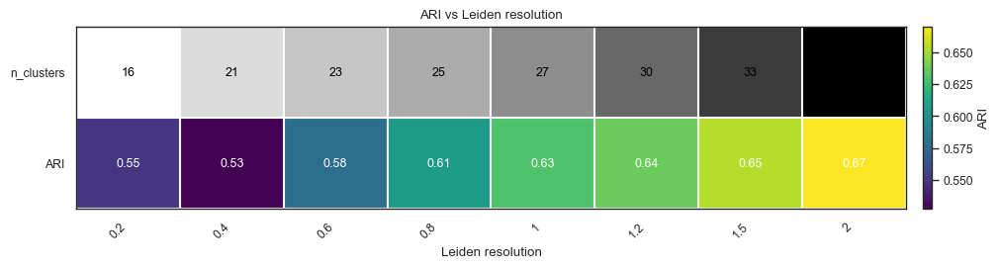

(<Figure size 1000x260 with 2 Axes>,
 <Axes: title={'center': 'ARI vs Leiden resolution'}, xlabel='Leiden resolution'>)

In [65]:
bk.pl.ari_resolution_heatmap(adata,
    df=df,
    metric="ARI",
    show_n_clusters=True,
    figsize=(10, 2.6),
    save="figs/ari_vs_resolution.png",
)

In [ ]:
Visualization:
You already have most pieces; add:
	•	bk.pl.association_heatmap() (genes × categories)
	•	bk.pl.boxplot_with_stats()
	•	bk.pl.categorical_confusion()


### 7.4.5. Associations

Association functions answer a broader statistical question: “Is variable X statistically associated with variable Y?”  

They are:  
- Symmetric (not inherently DE)
- Exploratory
- Model-light
- Often non-parametric  

Association functions generalize beyond genes. They work for:  
- gene ↔ category
- numeric obs ↔ category
- gene ↔ gene
- numeric obs ↔ numeric obs
- category ↔ category  

They are closer to EDA / statistics than DE.

#### bk.pl.gene_association()  
- automatic post-hoc (MWU + BH) and bracket annotation
- new effect-size aware volcano for categorical associations

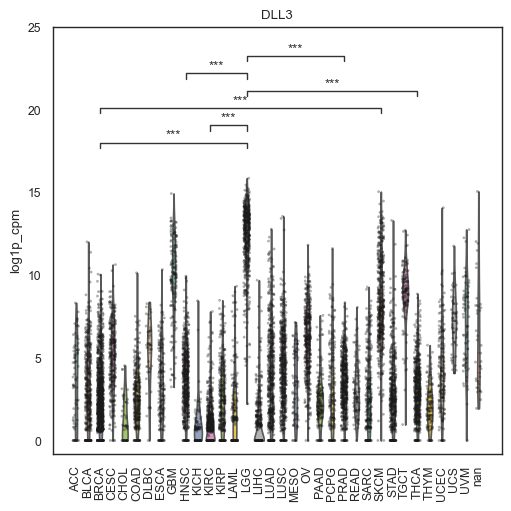

(<Figure size 500x500 with 1 Axes>,
 array([<Axes: title={'center': 'DLL3'}, ylabel='log1p_cpm'>], dtype=object))

In [17]:
bk.pl.gene_association(
    adata,
    gene=["DLL3"],
    groupby="Project_ID",
    layer="log1p_cpm",
    rotate_xticklabels=90,
    annotate_posthoc=True,
    figsize=(5,5),
    #save="figs/gene_association.png",
)

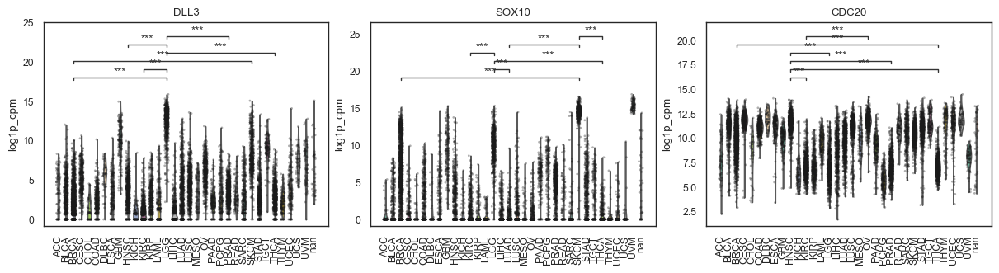

(<Figure size 1200x320 with 3 Axes>,
 array([<Axes: title={'center': 'DLL3'}, ylabel='log1p_cpm'>,
        <Axes: title={'center': 'SOX10'}, ylabel='log1p_cpm'>,
        <Axes: title={'center': 'CDC20'}, ylabel='log1p_cpm'>],
       dtype=object))

In [21]:
# Multiple genes (row of panels)
bk.pl.gene_association(
    adata,
    gene=["DLL3", "SOX10", "CDC20"],
    groupby="Project_ID",
    layer="log1p_cpm",
    rotate_xticklabels=90,
    figsize=(12.0, 3.2),  # per-panel size; total width = 3*4.0
    #save="figs/genes_by_ProjectID.png",
)

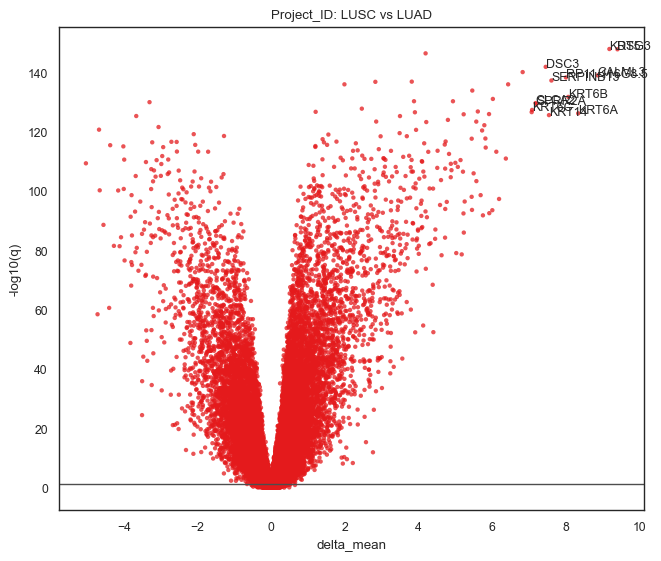

In [23]:
fig, ax, df = bk.pl.gene_association_volcano(
    adata,
    groupby="Project_ID",
    group="LUSC",
    reference="LUAD",   # or None for "rest"
    layer="log1p_cpm",
    alpha=0.05,
    #save="figs/assoc_volcano_SCLC_vs_LUAD.png",
)

In [24]:
df

,gene,effect,pval,qval,neglog10q
0,KRT5,9.191601,1.822702e-153,9.587959e-149,148.018274
1,DSG3,9.411068,4.580272e-153,1.204680e-148,147.919128
2,KRT74,4.195866,1.617996e-151,2.837049e-147,146.547133
3,DSC3,7.460600,7.749401e-147,1.019104e-142,141.991781
4,CERS3,6.834289,5.639659e-145,5.933259e-141,140.226707
...,...,...,...,...,...
52598,RP11-803A13.1,0.021460,9.906374e-01,1.000000e+00,-0.000000
52599,RPPH1-2P,0.000000,1.000000e+00,1.000000e+00,-0.000000
52600,RP11-656A10.1,0.000000,1.000000e+00,1.000000e+00,-0.000000
52601,LY6G6F,0.029988,9.885628e-01,1.000000e+00,-0.000000


#### Numerical - Categorical associations

In [35]:
# for numeric obs
y = pd.DataFrame({"y": adata.obs["purity"], "grp": adata.obs["Project_ID"]})
post = bk.tl.pairwise_posthoc(y, method="mwu")

In [27]:
post

,group1,group2,n1,n2,pval,effect,delta_mean,delta_median,qval
0,LUAD,OV,502,407,9.646718e-96,0.799891,-0.312945,-0.360,5.093467e-93
1,HNSC,OV,507,407,9.907419e-82,0.736117,-0.266157,-0.310,2.615558e-79
2,KIRC,OV,495,407,3.319469e-75,0.709180,-0.224717,-0.250,5.842265e-73
3,LGG,LUAD,511,502,7.938732e-75,-0.664294,0.251965,0.310,1.047913e-72
4,LUSC,OV,490,407,1.232161e-74,0.708068,-0.262391,-0.310,1.301162e-72
...,...,...,...,...,...,...,...,...,...
523,GBM,SARC,152,245,9.451089e-01,0.004135,0.016170,0.010,9.523235e-01
524,ACC,KICH,75,66,9.521921e-01,0.006061,-0.002412,-0.005,9.576332e-01
525,MESO,PRAD,81,471,9.750282e-01,0.002202,-0.000010,0.030,9.783327e-01
526,COAD,READ,282,89,9.764798e-01,0.002112,-0.005677,0.015,9.783327e-01


### Categorical - Categorical associations

In [32]:
cc = bk.tl.cat_cat_association(adata, key1="NE25_score", key2="Neuroendocrine_score")
cc

,key1,key2,chi2,dof,pval,cramers_v,n,qval
0,NE25_score,Neuroendocrine_score,1.109546e+08,110944089,0.239743,1.0,10534,NaN


#### A. Gene ↔ categorical, then rankplot

In [42]:
df = bk.tl.gene_categorical_association(
    adata,
    genes=["RB1", "TP53", "CCND1"],                 # All genes if None. Select one gene or a list of genes
    groupby="Project_ID",
    layer="log1p_cpm",
    method="kruskal",
    effect_size="epsilon2",
)
df

INFO: gene_categorical_association: 3 genes vs Project_ID (34 groups), method=kruskal


,groupby,gene,statistic,pval,effect,n_groups,n,group_means,qval
0,Project_ID,RB1,3969.506481,0.0,0.374905,34,10534,"{'ACC': 10.68782077922078, 'BLCA': 10.34634444...",0.0
1,Project_ID,TP53,2616.633303,0.0,0.246060,34,10534,"{'ACC': 10.217851948051948, 'BLCA': 11.1615268...",0.0
2,Project_ID,CCND1,3885.406876,0.0,0.366896,34,10534,"{'ACC': 12.109411688311692, 'BLCA': 12.6106368...",0.0


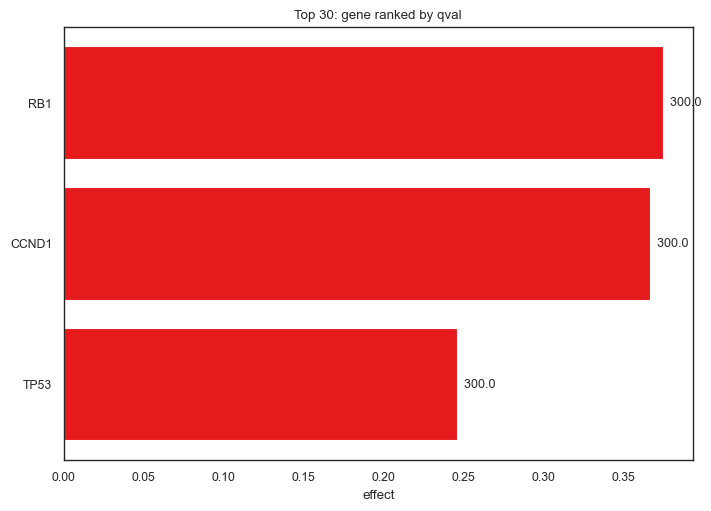

(<Figure size 700x500 with 1 Axes>,
 <Axes: title={'center': 'Top 30: gene ranked by qval'}, xlabel='effect'>)

In [43]:
bk.pl.rankplot_association(df, feature_col="gene", score_col="effect", p_col="qval", top_n=30)

#### B) Numeric obs ↔ categorical + posthoc

In [44]:
dfo = bk.tl.obs_categorical_association(
    adata,
    obs_keys=["purity", "age_at_diagnosis"],
    groupby="Project_ID",
    method="kruskal",
)

INFO: obs_categorical_association: 1 numeric obs vs Project_ID (34 groups), method=kruskal


In [45]:
# pick one obs and do pairwise
tmp = pd.DataFrame({"y": adata.obs["purity"], "grp": adata.obs["Project_ID"]})
post = bk.tl.pairwise_posthoc(tmp, method="mwu")
post.head(10)

,group1,group2,n1,n2,pval,effect,delta_mean,delta_median,qval
0,LUAD,OV,502,407,9.646718e-96,0.799891,-0.312945,-0.36,5.093467e-93
1,HNSC,OV,507,407,9.907419e-82,0.736117,-0.266157,-0.31,2.615558e-79
2,KIRC,OV,495,407,3.319469e-75,0.709180,-0.224717,-0.25,5.842265e-73
3,LGG,LUAD,511,502,7.938732e-75,-0.664294,0.251965,0.31,1.047913e-72
4,LUSC,OV,490,407,1.232161e-74,0.708068,-0.262391,-0.31,1.301162e-72
5,LUAD,THCA,502,469,9.531360e-68,0.645083,-0.233131,-0.23,8.387597e-66
6,OV,STAD,407,402,3.597096e-65,-0.692477,0.261110,0.29,2.713238e-63
7,BRCA,OV,1049,407,1.749028e-63,0.567221,-0.186443,-0.21,1.154359e-61
8,KIRP,LUAD,283,502,5.257696e-62,-0.713535,0.269181,0.32,3.084515e-60
9,HNSC,LGG,507,511,1.681618e-58,0.583834,-0.205178,-0.26,8.878945e-57


#### C) Dotplot/heatmap across multiple “groupby” runs

In [47]:
df1 = bk.tl.gene_categorical_association(adata, genes=["DLL3","SOX10"], groupby="Project_ID")
df2 = bk.tl.gene_categorical_association(adata, genes=["DLL3","SOX10"], groupby="Gender")

df_all = pd.concat([df1, df2], ignore_index=True)
df_all

INFO: gene_categorical_association: 2 genes vs Project_ID (34 groups), method=kruskal
INFO: gene_categorical_association: 2 genes vs Gender (3 groups), method=kruskal


,groupby,gene,statistic,pval,effect,n_groups,n,group_means,qval
0,Project_ID,DLL3,5096.269017,0.000000,0.482216,34,10534,"{'ACC': 3.573218181818182, 'BLCA': 3.314960179...",0.000000
1,Project_ID,SOX10,6122.513829,0.000000,0.579954,34,10534,"{'ACC': 0.36864545454545455, 'BLCA': 1.5780221...",0.000000
2,Gender,DLL3,3.436054,0.179420,0.000136,3,10534,"{'Female': 4.0029334938021375, 'Male': 4.08044...",0.358840
3,Gender,SOX10,0.520377,0.770906,0.000000,3,10534,"{'Female': 3.4830637846511987, 'Male': 3.41812...",0.770906


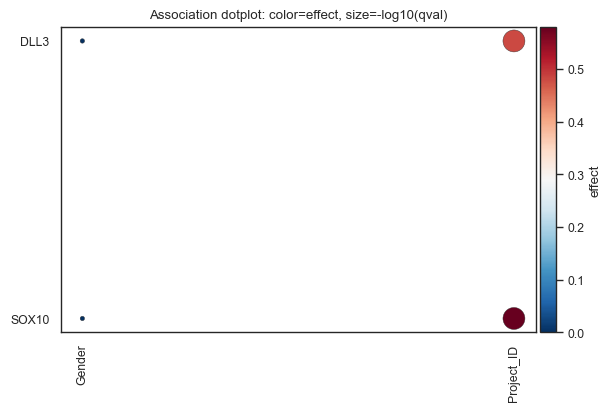

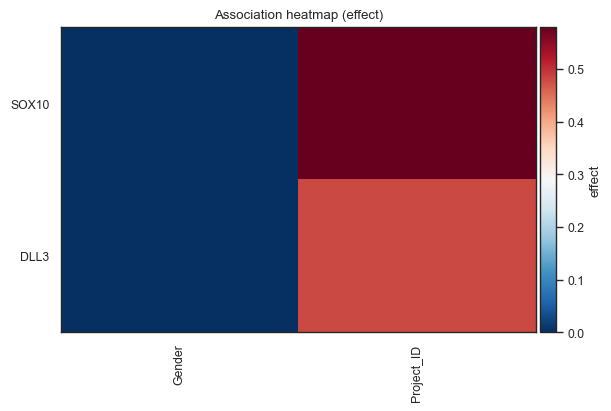

(<Figure size 600x400 with 2 Axes>,
 <Axes: title={'center': 'Association heatmap (effect)'}>)

In [48]:
bk.pl.dotplot_association(df_all, feature_col="gene", groupby_col="groupby", top_n=50)
bk.pl.heatmap_association(df_all, feature_col="gene", groupby_col="groupby", value_col="effect", top_n=40)

#### A) genes ↔ categorical obs (rank + plot)

In [49]:
df = bk.tl.gene_categorical_association(
    adata,
    groupby="Project_ID",
    genes=["DLL3", "SOX10", "CDC20"],
    layer="log1p_cpm",
    method="kruskal",
    effect_size="epsilon2",
)

df

INFO: gene_categorical_association: 3 genes vs Project_ID (34 groups), method=kruskal


,groupby,gene,statistic,pval,effect,n_groups,n,group_means,qval
0,Project_ID,DLL3,5096.269017,0.0,0.482216,34,10534,"{'ACC': 3.573218181818182, 'BLCA': 3.314960179...",0.0
1,Project_ID,SOX10,6122.513829,0.0,0.579954,34,10534,"{'ACC': 0.36864545454545455, 'BLCA': 1.5780221...",0.0
2,Project_ID,CDC20,6386.193160,0.0,0.605066,34,10534,"{'ACC': 7.902002597402596, 'BLCA': 11.04651675...",0.0


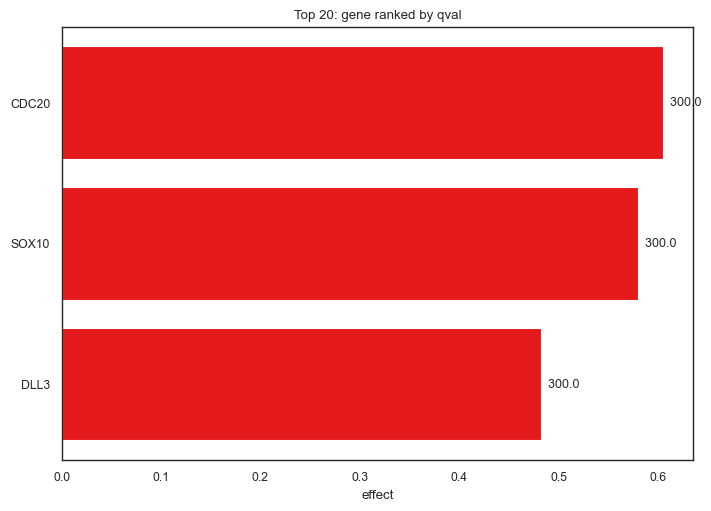

(<Figure size 700x500 with 1 Axes>,
 <Axes: title={'center': 'Top 20: gene ranked by qval'}, xlabel='effect'>)

In [50]:
bk.pl.rankplot_association(df, feature_col="gene", score_col="effect", p_col="qval", top_n=20)

#### B) numeric obs ↔ categorical obs

In [51]:
dfo = bk.tl.obs_categorical_association(
    adata,
    groupby="Project_ID",
    obs_keys=["purity", "NE25_score"],
    method="kruskal",
)
dfo

INFO: obs_categorical_association: 2 numeric obs vs Project_ID (34 groups), method=kruskal


,groupby,obs,statistic,pval,effect,n_groups,n,group_means,qval
0,Project_ID,purity,2009.295595,0.0,0.212619,34,9329,"{'ACC': 0.8221333333333333, 'BLCA': 0.60684343...",0.0
1,Project_ID,NE25_score,5890.059108,0.0,0.557815,34,10534,"{'ACC': 1.0220554141041098, 'BLCA': -1.2558328...",0.0


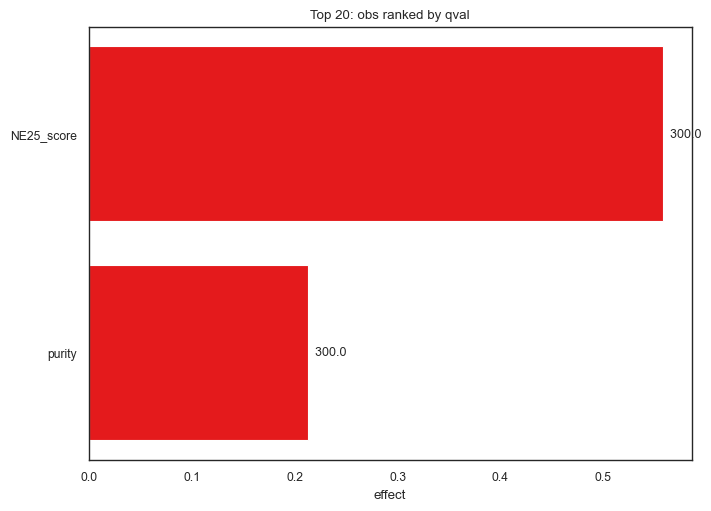

(<Figure size 700x500 with 1 Axes>,
 <Axes: title={'center': 'Top 20: obs ranked by qval'}, xlabel='effect'>)

In [52]:
bk.pl.rankplot_association(dfo, feature_col="obs", score_col="effect", p_col="qval", top_n=20)

#### A) Rank genes associated with a category (associations, not DE)

In [66]:
res = bk.tl.rank_genes_categorical(
    adata,
    groupby="Project_ID",
    group="LUSC",
    reference="rest",
    layer="log1p_cpm",
    method="mwu",
    store_key="assoc:Project_ID:LUSC_vs_rest",
)
res.head()

/Users/mmalumbres/Library/CloudStorage/OneDrive-VHIO/BioInformatics/BioProjects/MM01_BULLKpy/bullkpy-skeleton/src/bullkpy/tl/associations.py:55: RuntimeWarning: invalid value encountered in log2
  return float(np.log2((mean_a + eps) / (mean_b + eps)))
INFO: Stored categorical gene association in adata.uns['assoc']['assoc:Project_ID:LUSC_vs_rest'].


,gene,pval,qval,effect_size,mean_group,mean_ref,log2FC
0,CTB-11I22.2,0.0,NaN,-0.812866,3.160739,0.522038,2.598035
1,RP11-416L21.2,0.0,NaN,-0.705195,2.889580,0.335939,3.104588
2,RP11-416L21.1,0.0,NaN,-0.632022,1.417213,0.130457,3.441408
3,RP5-1097P24.1,0.0,NaN,-0.512046,1.475833,0.109945,3.746678
4,AC128709.3,0.0,NaN,-0.745796,3.007364,0.384418,2.967753


#### B) Volcano plot (effect-size aware)

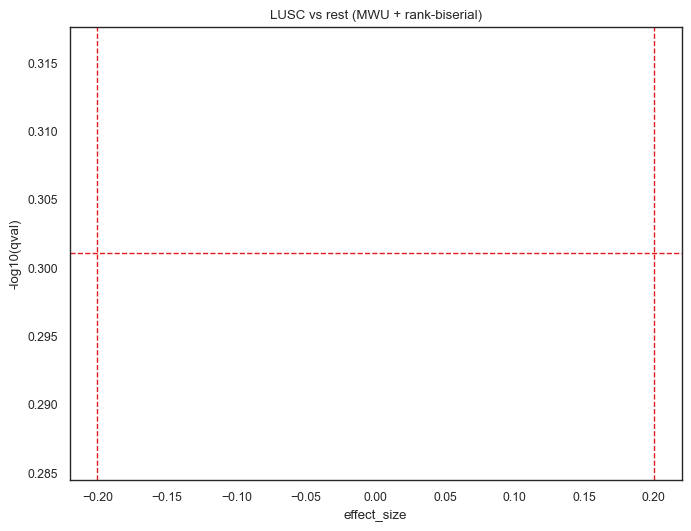

(<Figure size 680x520 with 1 Axes>,
 <Axes: title={'center': 'LUSC vs rest (MWU + rank-biserial)'}, xlabel='effect_size', ylabel='-log10(qval)'>)

In [68]:
bk.pl.volcano_categorical(
    res,
    x="effect_size",   # "effect_size" or x="log2FC"
    q_thr=0.5,
    effect_thr=0.2,
    title="LUSC vs rest (MWU + rank-biserial)",
    #save="figs/volcano_ACC.png",
)

#### D) Automatic posthoc per gene

In [ ]:
posthoc = bk.tl.posthoc_per_gene(
    adata,
    genes=["DLL3", "SOX10", "CDC20"],
    groupby="Project_ID",
    layer="log1p_cpm",
    method="mwu",
)
posthoc["DLL3"].head()

# 8. Markers and Differential expression
<a id="de"></a>

## 8.1. Marker genes

Which genes are differentially expressed between groups?  
Based on Differential expression (DE). Similar to Scanpy rank_genes_groups (group vs rest, etc.)
#rank_genes_groups

### 8.1.1. Every groups versus the rest

In [65]:
#Everyone versus the rest
bk.tl.rank_genes_groups(
    adata,
    groupby="Project_ID",
    layer="log1p_cpm",
    method="t-test",
    n_genes=50,
)

INFO: rank_genes_groups: groupby='Project_ID', method='t-test', layer='log1p_cpm', reference='rest', n_genes=50
INFO: rank_genes_groups: stored results in adata.uns['rank_genes_groups']


In [66]:
# Get the results for a group
df_lumb = bk.get.rank_genes_groups_df(adata, group="LUAD", sort_by="scores")
df_lumb.head()

,gene,scores,log2FC,pval,qval,mean_group,mean_ref
0,SFTPB,104.414715,19.480293,0.0,0.0,16.881305,3.378595
1,NKX2-1,103.835826,13.934064,0.0,0.0,11.743011,2.084654
2,SFTA3,98.559444,14.346238,0.0,0.0,11.594436,1.650381
3,SFTA2,95.571088,12.737869,0.0,0.0,11.479025,2.649807
4,SLC34A2,85.073474,12.129740,0.0,0.0,15.283845,6.876150


In [67]:
# Get the results for all groups
df_all = bk.get.rank_genes_groups_df_all(adata)
df_all.head()

,group,gene,scores,log2FC,pval,qval,mean_group,mean_ref
0,ACC,STAR,51.271787,18.752414,1.671393e-61,3.663345e-59,16.582610,3.584427
1,ACC,NR5A1,48.126282,17.582484,2.449793e-59,4.956402e-57,13.742514,1.555265
2,ACC,SULT2A1,41.167587,18.032900,1.625689e-54,2.689186e-52,13.736112,1.236658
3,ACC,CYP11A1,40.627762,15.326728,6.047854e-54,9.728907e-52,14.978512,4.354833
4,ACC,SERPINA5,39.269236,12.498863,2.771207e-54,4.541240e-52,15.053103,6.389551


In [60]:
# export
df_all.to_csv(DESKTOP + "rank_genes_groups_all.tsv", sep="\t", index=False)

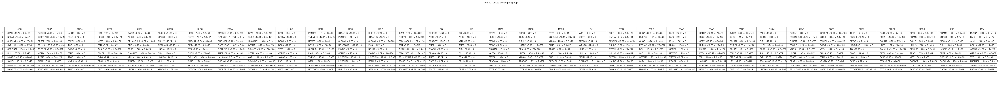

(<Figure size 5530x530 with 1 Axes>,
 <Axes: title={'center': 'Top 10 ranked genes per group'}>)

In [68]:
# Quick table view
bk.pl.rank_genes_groups(adata, n_genes=10, save="figs/rank_genes_groups_table.png")

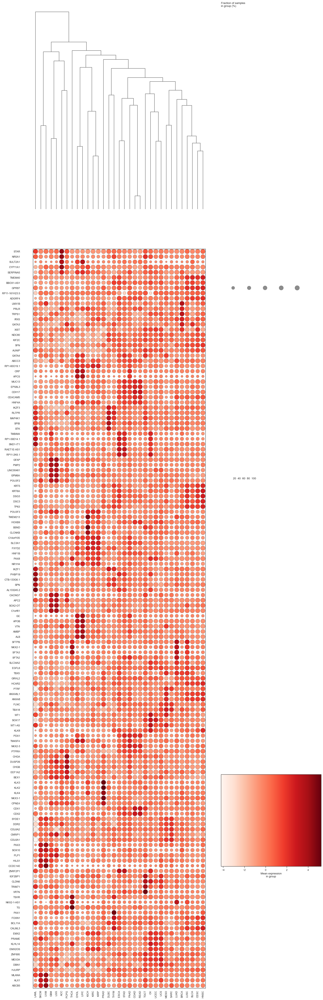

(<Figure size 2155x8010 with 4 Axes>, <Axes: >)

In [69]:
#3. Dotplot of top markers per group (Scanpy-ish)

bk.pl.rank_genes_groups_dotplot(
    adata,
    groupby="Project_ID",
    n_genes=5,
    swap_axes=True,
    dendrogram_top=True,
    #save="figs/rank_genes_groups_dotplot.png",
)

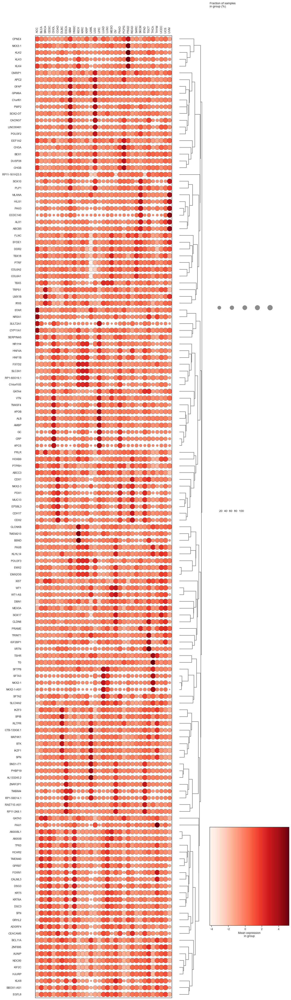

(<Figure size 2155x8010 with 4 Axes>, <Axes: >)

In [70]:
bk.pl.rank_genes_groups_dotplot(
    adata,
    groupby="Project_ID",
    n_genes=5,
    swap_axes=True,
    dendrogram_top=False,
    dendrogram_rows=True,
    #save="figs/rank_genes_groups_dotplot.png",
)

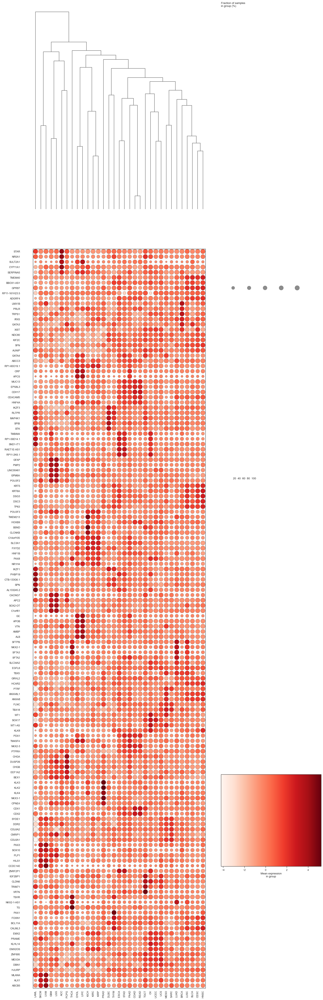

(<Figure size 2155x8010 with 4 Axes>, <Axes: >)

In [71]:
#A. Scanpy-like expression dotplot (auto standard_scale=“var”)
bk.pl.rank_genes_groups_dotplot(
    adata,
    groupby="Project_ID",
    n_genes=5,
    values_to_plot="expression",
    standard_scale="auto",
    #save="figs/rgg_dotplot_expression.png",
)

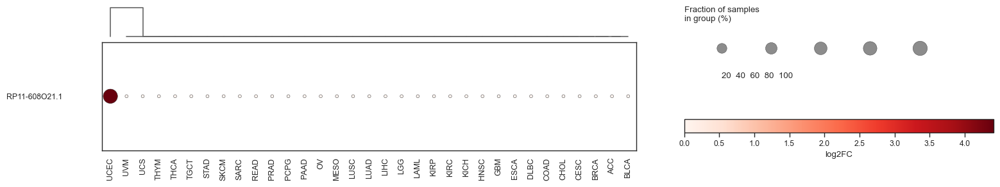

(<Figure size 2155x380 with 4 Axes>, <Axes: >)

In [73]:
#B. B) Color by log2FC (still sizes by fraction from counts)
bk.pl.rank_genes_groups_dotplot(
    adata,
    groupby="Project_ID",
    n_genes=5,
    values_to_plot="logfoldchanges",
    min_in_group_fraction=0.05,
    max_in_group_fraction=0.95,
    #save="figs/rgg_dotplot_logFC.png",
)

### 8.1.2. One group or a few groups versus other group

In [74]:
# Group versus specific reference
bk.tl.rank_genes_groups(
    adata,
    groupby="Project_ID",
    groups=["LUAD", "LUSC"],
    reference="BRCA",
    layer="log1p_cpm",
    method="wilcoxon",
    n_genes=50,
)

INFO: rank_genes_groups: groupby='Project_ID', method='wilcoxon', layer='log1p_cpm', reference='BRCA', n_genes=50
INFO: rank_genes_groups: stored results in adata.uns['rank_genes_groups']


Get the genes from `adata.uns['rank_genes_groups']` into a dataframe

In [75]:
df_lumb = bk.get.rank_genes_groups_df(adata, group="LUAD", sort_by="scores") 
df_lumb.head()

,gene,scores,log2FC,pval,qval,mean_group,mean_ref
0,SFTPB,34.073980,21.689591,6.864576e-255,1.504572e-251,16.881305,1.847226
1,SFTA3,34.066951,16.289189,7.163340e-302,5.383046e-298,11.594436,0.303630
2,NKX2-1,34.047337,16.410986,0.000000e+00,0.000000e+00,11.743011,0.367782
3,SFTA2,33.987364,14.910638,3.877076e-258,9.711707e-255,11.479025,1.143758
4,HNF1B,33.916282,12.553734,2.321304e-261,7.182798e-258,9.449643,0.748057


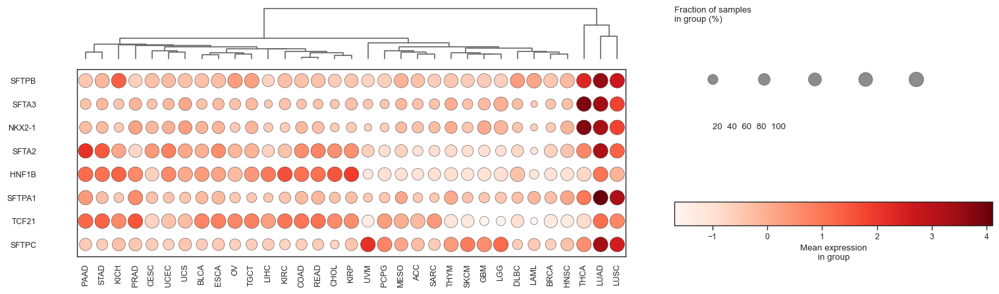

(<Figure size 2155x640 with 4 Axes>, <Axes: >)

In [76]:
#A. Scanpy-like expression dotplot (auto standard_scale=“var”)
bk.pl.rank_genes_groups_dotplot(
    adata,
    groupby="Project_ID",
    n_genes=5,
    values_to_plot="expression",
    standard_scale="auto",
    #save="figs/rgg_dotplot_expression.png",
)

## 8.2. Differential expression

For bulk RNA-seq, the two most useful layers are:  
	•	a fast exploratory DE (like Scanpy’s “rank genes” idea) → Welch t-test on log1p_cpm  
	•	a proper bulk model → Negative Binomial GLM (DESeq2/edgeR spirit) on raw counts with library-size offset. Important: requires raw counts

Quick best-practice recommendation. Use:  
- Welch_ttest for fast exploration and ranking  
- NB GLM only if we either (a) estimate alpha properly, or (b) accept that it’s an approximate baseline  

#### Define comparison

Select column to select groups from and groups

In [6]:
adata.obs.RB1_mut = adata.obs.RB1_mut.astype("category")
adata.obs.RB1_mut.value_counts()

0.0    8127
1.0     336
Name: RB1_mut, dtype: int64

In [6]:
dataset = adata                                    # adata, adata_lung
dataname = "TCGA"                                  # TCGA, TCGA_lung
column = "RB1_mut"                                 # e,g, "Project_ID", "RB1_mut"
groupA = "1.0"                                     # e.g. "LUAD", "1.0"
groupB = "0.0"                                     # e.g. "LUSC", "0.0"

comparison = f"{column}_{groupA}_vs_{groupB}"
comparison

'RB1_mut_1.0_vs_0.0'

### 8.2.1. Non-count based, log data: t-test, wilcoxon o welch t-test

In [7]:
# Fast exploratory (recommended first)
bk.tl.de(adata, groupby=column, group=groupA, reference=groupB,
    method="welch_ttest",         # wilcoxon  ---> explicitly non-count-based
    layer_expr="log1p_cpm",       # log
)

INFO: DE (welch_ttest) on layer='log1p_cpm'
INFO: Stored DE results (welch_ttest) in adata.uns['de']['RB1_mut_1.0_vs_0.0'].


In [8]:
res = adata.uns["de"][comparison]["results"]
res.head(10)

,gene,log2FC,t,pval,qval,mean_group,mean_ref
19927,CHAF1B,1.277070,28.074407,2.596478e-97,1.365825e-92,9.853566,8.576496
25275,MELK,1.725599,27.161092,3.677608e-96,9.672659e-92,10.017997,8.292398
16630,KIF4A,1.512519,26.751460,3.328550e-95,5.836390e-91,10.285657,8.773138
27852,TPX2,1.558066,26.608510,5.642415e-95,7.420199e-91,11.961647,10.403580
16665,WDR76,1.325717,27.025209,2.659189e-91,2.797626e-87,9.690250,8.364533
19752,KIFC1,1.504634,26.048083,4.663039e-91,4.088164e-87,10.719045,9.214411
20444,CDC25C,1.496204,25.528622,4.161906e-89,3.127553e-85,8.124011,6.627807
31037,BIRC5,1.564104,25.251723,9.997444e-89,5.843284e-85,11.083357,9.519253
34027,AC003984.1,-0.408961,-20.581319,9.301403e-89,5.843284e-85,0.036133,0.445093
28462,KIF2C,1.574318,25.534582,1.129147e-88,5.939653e-85,10.561436,8.987118


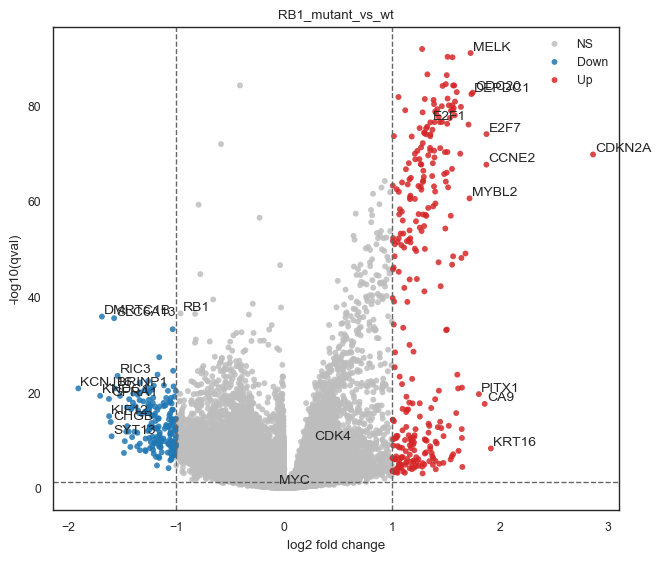

(<Figure size 650x550 with 1 Axes>,
 <Axes: title={'center': 'RB1_mutant_vs_wt'}, xlabel='log2 fold change', ylabel='-log10(qval)'>)

In [12]:
bk.pl.volcano(res, title="RB1_mutant_vs_wt", 
              top_n_labels = 10,                             # int
              bottom_n_labels = 10,
              label_genes = ["RB1", "MYC", "E2F1", "CDK4"],        #: Sequence[str] = (),
              p_cutoff = 0.05,
              fc_cutoff = 1.0,              # optional, set >0 to require |log2FC| >= fc_cutoff
              #save="volcano.png"
             )

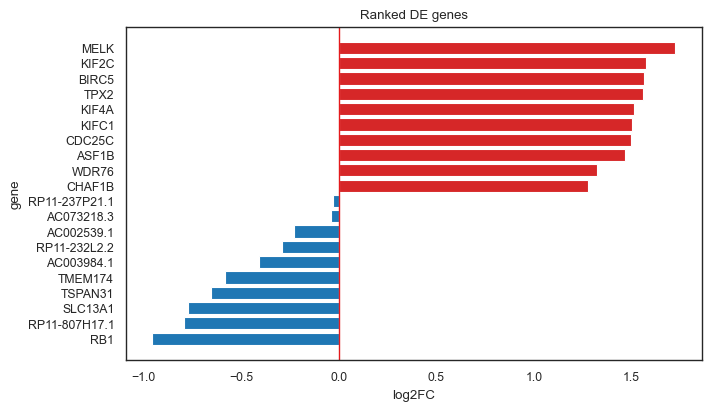

(<Figure size 700x400 with 1 Axes>,
 <Axes: title={'center': 'Ranked DE genes'}, xlabel='log2FC', ylabel='gene'>)

In [13]:
bk.pl.rankplot(res=res, n_genes=20, 
               direction="both", 
               sort_by="qval",               # or pval or log2FC
               figsize=(7, 4),
              )       #save="rankplot.png"

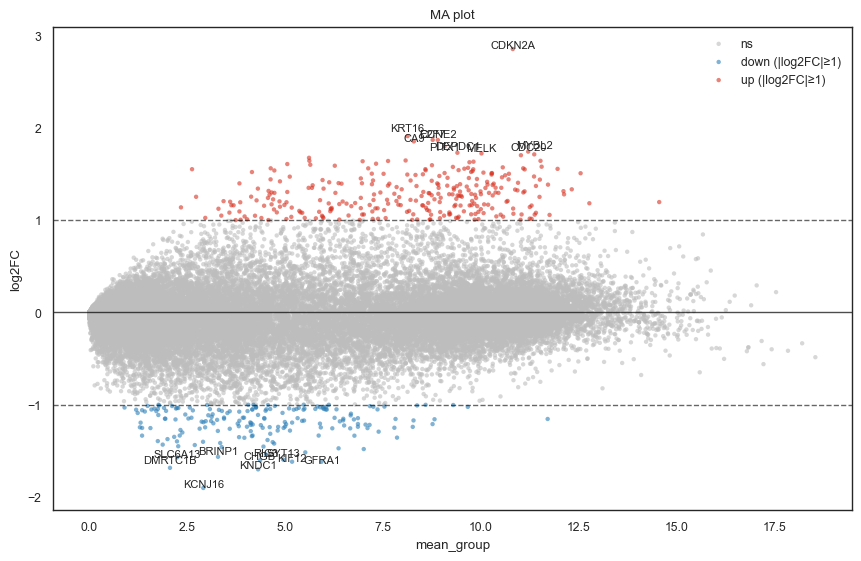

(<Figure size 850x550 with 1 Axes>,
 <Axes: title={'center': 'MA plot'}, xlabel='mean_group', ylabel='log2FC'>)

In [14]:
bk.pl.ma(
    result=res,
    mean_col="mean_group",
    fc_col="log2FC",
    top_n_labels=10,
    bottom_n_labels=10,
    min_abs_fc = 1.0,
    #label_genes=["DLL3", "SOX10", "CDC20"],
)

### 8.2.2. NB Model (DESeq-like) requires raw counts

NB Model  
This is DESeq2-like, not a full DESeq2 reimplementation:  
	•	DESeq2 does more sophisticated dispersion fitting + shrinkage + outlier handling.  
	•	But for many cohorts, this is already a big leap from “alpha=1”.  

In [ ]:
# Proper NB model (bulk) --- Requires raw counts

bk.tl.de(
    adata,
    groupby="Project_ID",
    group="LUAD",
    reference="LUSC",
    method="nb_glm",
    #layer_counts="counts",
    layer_expr="log1p_cpm",
    shrink_dispersion=True,
    prior_df=10.0,
)

res = adata.uns["de"]["LUAD_vs_LUSC"]["results"]
res.head(20)

#### multi-factor DE with a design matrix + contrasts, bulk-style.  
We’ll implement:  
	•	bk.tl.de_glm(...) using NB GLM + DESeq2-like size factors + dispersion (the improved engine),  
	•	supports formulas like ~ Subtype + Batch (and later interactions),  
	•	and a contrast like ("Subtype", "Basal", "Luminal").  

This is the bulk equivalent of “design matrix + contrast” from DESeq2/edgeR/limma.  

In [ ]:
# Make sure covariates are categorical where appropriate
adata.obs["Subtype_PAM50"] = adata.obs["Subtype_PAM50"].astype("category")
adata.obs["Batch"] = adata.obs["Batch"].astype("category")   # if you have it

In [ ]:
# Run DE adjusted for Batch
bk.tl.de_glm(
    adata,
    formula="~ Subtype_PAM50 + Batch",
    contrast=("Subtype_PAM50", "LumB", "LumA"),
    layer_counts="counts",
    shrink_dispersion=True,
    prior_df=10.0,
)
res = adata.uns["de_glm"]["Subtype_PAM50:LumB_vs_LumA"]["results"]
res.head(25)

In [ ]:
# If you don’t have Batch, just:
bk.tl.de_glm(
    adata,
    formula="~ Subtype_PAM50",
    contrast=("Subtype_PAM50", "LumB", "LumA"),
)

In [ ]:
res.query("qval < 0.05").head(20)

This initial formula parser supports ~ A + B + C with:  
	•	categorical → dummy-coded (reference = first category)  
	•	numeric → included as-is  

No interactions yet (A:B) and no random effects. If you later want patient-paired designs, we’ll add that as a dedicated mode.  

If you tell me your typical covariates (Batch, sex, site, patient ID?), I’ll harden the defaults for your use case.  

If results are stored in adata.uns["de_glm"]

# 9. Pathway and Gene Set Enrichment Analysis
<a id="go"></a>

## 9.1. GSEA

In [15]:
# as define above:
print(dataname + "/" + comparison)

TCGA/RB1_mut_1.0_vs_0.0


In [10]:
GENESETS = "/Users/mmalumbres/Library/CloudStorage/OneDrive-VHIO/BioInformatics/Public_Data/Signatures & GeneSets/GSEA_genesets/2024/"

In [9]:
df_gsea, pre_res = bk.tl.gsea_preranked(
    adata,
    res=res,
    comparison=comparison,
    score_col="t",                                       # # good default for preranked
    gene_sets=["hallmark"],                              # ["hallmark", "c2"] also as a list... convenience aliases
    #gene_sets=[GENESETS + "h.all.v2024.1.Hs.symbols.gmt"],        # if saved locally from MSigDB
    #gene_sets=[GENESETS + "h.all.v2024.1.Hs.symbols.gmt", GENESETS + "c2.cp.v2024.1.Hs.symbols.gmt",]   # list
    outdir="figs/gsea",
    return_pre_res=True,
)

# later: concatenate across comparisons
# all_gsea = pd.concat([df_gsea_1, df_gsea_2, ...])

INFO: Running GSEApy prerank: comparison=RB1_mut_1.0_vs_0.0 n_genes=52603 outdir=figs/gsea/RB1_mut_1.0_vs_0.0
2025-12-29 01:45:54,605 [WARNING] Duplicated values found in preranked stats: 0.34% of genes
The order of those genes will be arbitrary, which may produce unexpected results.


In [10]:
df_gsea.head(3)

,comparison,term,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
0,RB1_mut_1.0_vs_0.0,0,prerank,MSigDB_Hallmark_2020__E2F Targets,0.929041,4.13645,0.0,0.0,0.0,159/195,3.57%,MELK;KIF4A;ASF1B;MCM6;KIF2C;EZH2;DONSON;BIRC5;...
1,RB1_mut_1.0_vs_0.0,1,prerank,MSigDB_Hallmark_2020__G2-M Checkpoint,0.872058,3.840308,0.0,0.0,0.0,119/190,3.58%,KIF4A;TPX2;MCM6;KIF2C;EZH2;BIRC5;CDC20;RAD54L;...
2,RB1_mut_1.0_vs_0.0,2,prerank,MSigDB_Hallmark_2020__Myc Targets V1,0.793093,3.551782,0.0,0.0,0.0,117/194,8.50%,MCM6;CDC20;MCM2;TYMS;CDC45;CCNA2;PCNA;RFC4;MCM...


In [12]:
pre_res.res2d.head(3)

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
0,prerank,MSigDB_Hallmark_2020__E2F Targets,0.929041,4.13645,0.0,0.0,0.0,159/195,3.57%,MELK;KIF4A;ASF1B;MCM6;KIF2C;EZH2;DONSON;BIRC5;...
1,prerank,MSigDB_Hallmark_2020__G2-M Checkpoint,0.872058,3.840308,0.0,0.0,0.0,119/190,3.58%,KIF4A;TPX2;MCM6;KIF2C;EZH2;BIRC5;CDC20;RAD54L;...
2,prerank,MSigDB_Hallmark_2020__Myc Targets V1,0.793093,3.551782,0.0,0.0,0.0,117/194,8.50%,MCM6;CDC20;MCM2;TYMS;CDC45;CCNA2;PCNA;RFC4;MCM...


In [13]:
terms = pre_res.res2d.Term
terms

0                     MSigDB_Hallmark_2020__E2F Targets
1                 MSigDB_Hallmark_2020__G2-M Checkpoint
2                  MSigDB_Hallmark_2020__Myc Targets V1
3       MSigDB_Hallmark_2020__Interferon Gamma Response
4                MSigDB_Hallmark_2020__mTORC1 Signaling
5                 MSigDB_Hallmark_2020__Mitotic Spindle
6       MSigDB_Hallmark_2020__Interferon Alpha Response
7                  MSigDB_Hallmark_2020__Myc Targets V2
8                      MSigDB_Hallmark_2020__DNA Repair
9                      MSigDB_Hallmark_2020__Glycolysis
10                 MSigDB_Hallmark_2020__UV Response Up
11            MSigDB_Hallmark_2020__Allograft Rejection
12    MSigDB_Hallmark_2020__Epithelial Mesenchymal T...
13    MSigDB_Hallmark_2020__TNF-alpha Signaling via ...
14          MSigDB_Hallmark_2020__Inflammatory Response
15      MSigDB_Hallmark_2020__Unfolded Protein Response
16                MSigDB_Hallmark_2020__Spermatogenesis
17        MSigDB_Hallmark_2020__Cholesterol Home

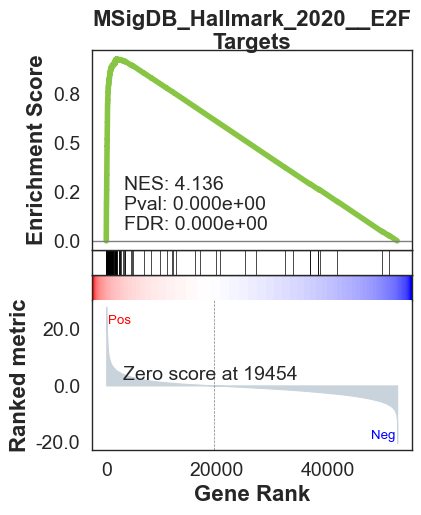

In [14]:
axs = pre_res.plot(terms=terms[0]) # v1.0.5

In [15]:
# plot to file
gseaplot(rank_metric=pre_res.ranking, term=terms[0], ofname=DESKTOP + 'your.plot.png', **pre_res.results[terms[0]])

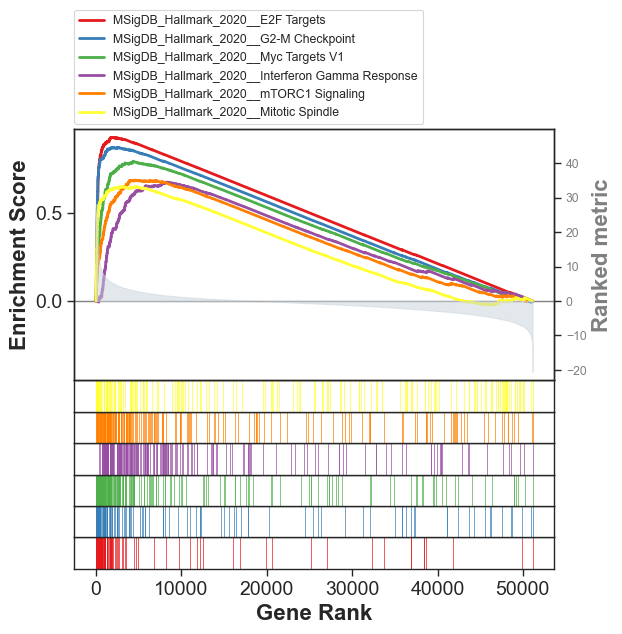

In [16]:
axs = pre_res.plot(terms=terms[0:6],
                   #legend_kws={'loc': (1.2, 0)}, # set the legend loc
                   show_ranking=True, # whether to show the second yaxis
                   figsize=(3,4)
                  )
# or use this to have more control on the plot
# from gseapy import gseaplot2
# terms = pre_res.res2d.Term[1:5]
# hits = [pre_res.results[t]['hits'] for t in terms]
# runes = [pre_res.results[t]['RES'] for t in terms]
# fig = gseaplot2(terms=terms, ress=runes, hits=hits,
#               rank_metric=gs_res.ranking,              # rank_metric=pre_res.ranking
#               legend_kws={'loc': (1.2, 0)},            # set the legend loc
#               figsize=(4,5))   

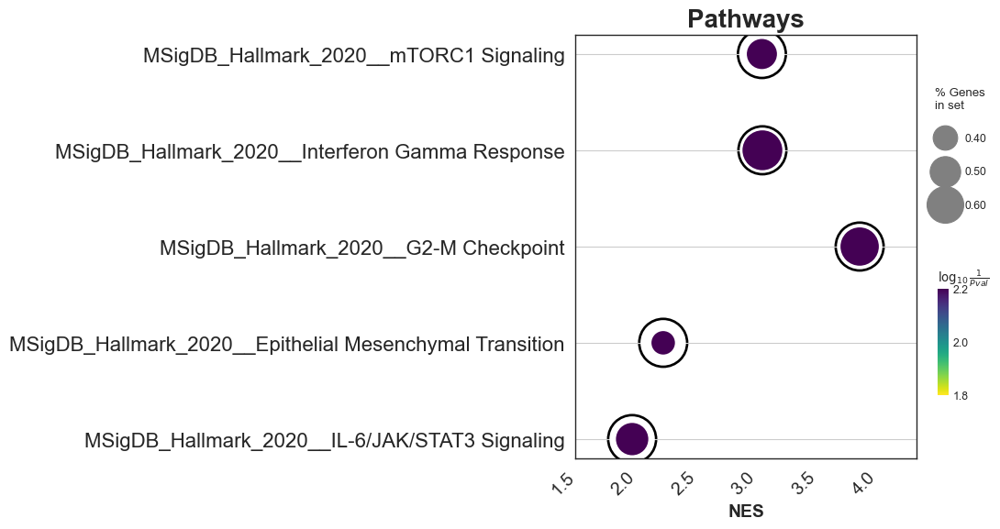

In [18]:
# categorical scatterplot
ax = gspy.dotplot(pre_res.res2d,
              column="NOM p-val",
              x='Gene_set', # set x axis, so you could do a multi-sample/library comparsion
              size=10,
              top_term=5,
              figsize=(6,6),
              title = "Pathways",
              xticklabels_rot=45, # rotate xtick labels
              show_ring=True, # set to False to revmove outer ring
              marker='o',
             )

In [22]:
# to save your figure, make sure that ``ofname`` is not None
ax = gspy.dotplot(pre_res.res2d,
             column="NOM p-val",                             #“Adjusted P-value”, “P-value”, “NOM p-val”, “FDR q-val”
             title='TEST',
             ofname=DESKTOP + "/mix_E3.5_KO_vs_WT.png",                                     # save to file
             cmap=plt.cm.viridis,
             top_term=12,
             size=6,                                          # adjust dot size
             figsize=(6,5), cutoff=0.25, show_ring=False)


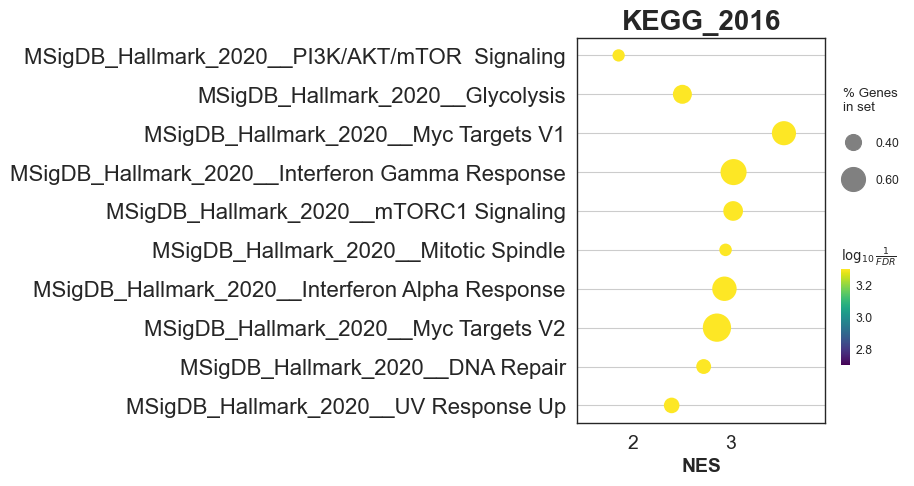

In [24]:
# to save your figure, make sure that ``ofname`` is not None
ax = gspy.dotplot(pre_res.res2d,
             column="FDR q-val",
             title='KEGG_2016',
             cmap=plt.cm.viridis,
             size=6, # adjust dot size
             figsize=(4,5), cutoff=0.25, show_ring=False)

#### Network Visualization

In [25]:
# return two dataframe
nodes, edges = enrichment_map(pre_res.res2d)

In [26]:
import networkx as nx
# build graph
G = nx.from_pandas_edgelist(edges,
                            source='src_idx',
                            target='targ_idx',
                            edge_attr=['jaccard_coef', 'overlap_coef', 'overlap_genes'])

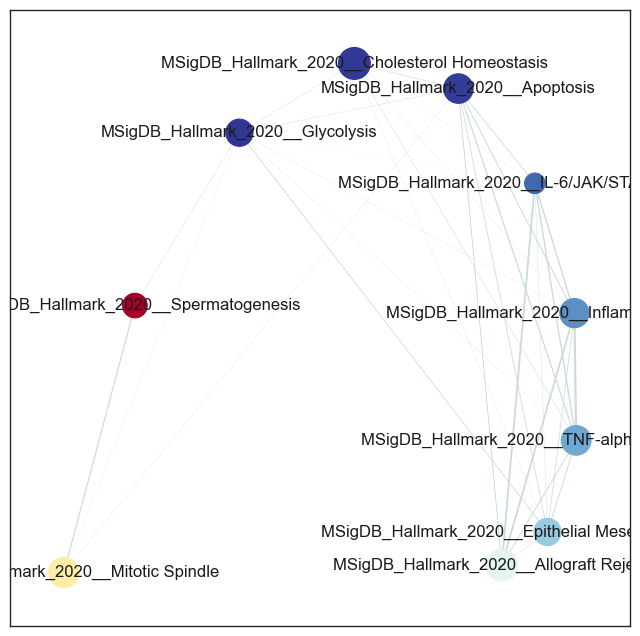

In [27]:
fig, ax = plt.subplots(figsize=(8, 8))

# init node cooridnates
pos=nx.layout.spiral_layout(G)
#node_size = nx.get_node_attributes()
# draw node
nx.draw_networkx_nodes(G,
                       pos=pos,
                       cmap=plt.cm.RdYlBu_r,
                       node_color=list(nodes.NES),
                       node_size=list(nodes.Hits_ratio *1000))
# draw node label
nx.draw_networkx_labels(G,
                        pos=pos,
                        labels=nodes.Term.to_dict())
# draw edge
edge_weight = nx.get_edge_attributes(G, 'jaccard_coef').values()
nx.draw_networkx_edges(G,
                       pos=pos,
                       width=list(map(lambda x: x*10, edge_weight)),
                       edge_color='#CDDBD4')
plt.show()

### 9.1.2. Leading edge genes

In [41]:
i=0
genes = pre_res.res2d.Lead_genes[i].split(";")
genes[:10]

['MELK',
 'KIF4A',
 'ASF1B',
 'MCM6',
 'KIF2C',
 'EZH2',
 'DONSON',
 'BIRC5',
 'CDC20',
 'DEPDC1']

#### Expression heatmap of frequent leading-edge genes

In [ ]:
df_expr, g = bk.pl.gsea_leading_edge_heatmap(
    adata,
    pre_res,
    term_idx=slice(0, 30),
    use="group_mean",
    groupby="RB1_mut",
    min_gene_freq=3,
    max_genes=150,
    show_labels=True,
    figsize=(20,6)
    save="figs/leading_edge_expr_heatmap.png",
)

/Users/mmalumbres/mambaforge/envs/biopython/lib/python3.10/site-packages/seaborn/matrix.py:654: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


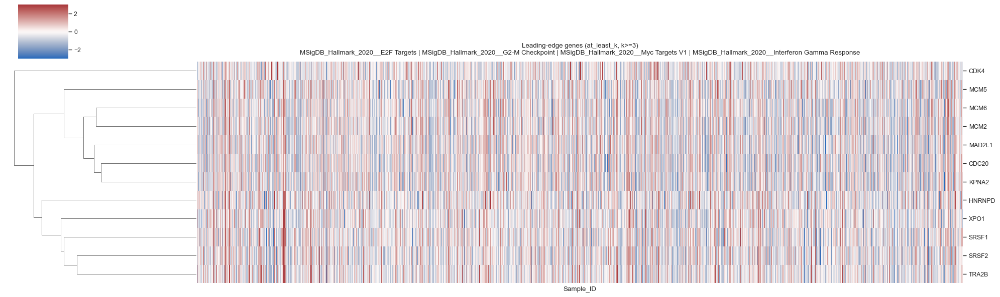

In [29]:
g = gsea_leading_edge_heatmap(
    adata, pre_res,
    term_idx=slice(0, 4),
    mode="at_least_k",                 #"union", "intersection" , "at_least_k"
    k=3,
    layer="log1p_cpm",
    #groupby="RB1_mut",   # optional
    figsize=(20,6),
)
plt.savefig("figs/gsea/leading_edge_intersection.png", dpi=300, bbox_inches="tight")

#### Jaccard similarity between pathways

In [ ]:
dfJ, g = bk.pl.leading_edge_jaccard_heatmap(
    pre_res,
    term_idx=slice(0, 30),
    cluster=True,
    figsize=(8,8),
    save="figs/leading_edge_jaccard.png",
)

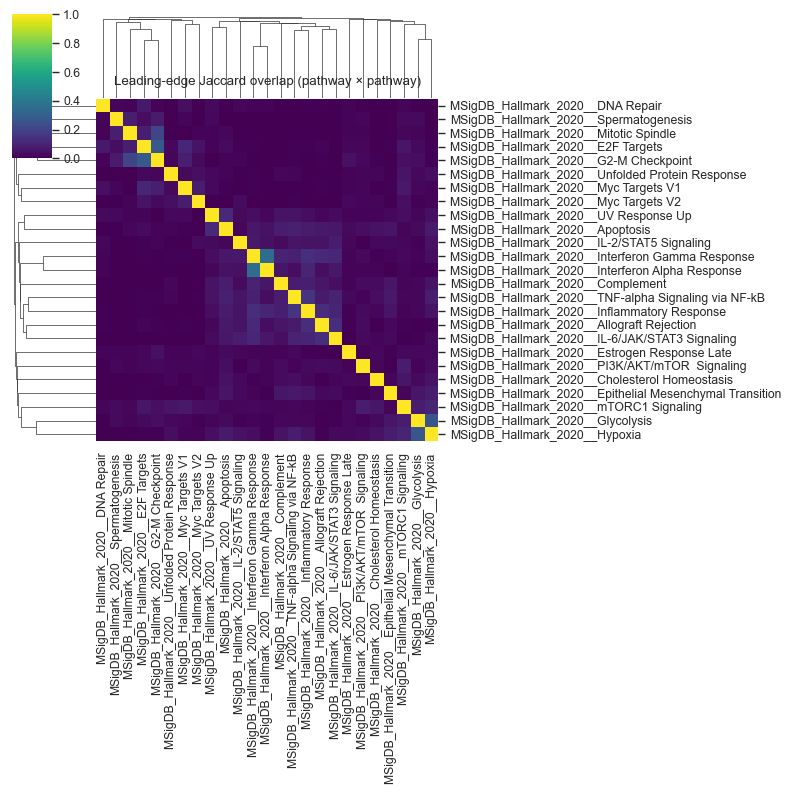

In [35]:
dfJ, gJ = leading_edge_jaccard_heatmap(
    pre_res, 
    term_idx=slice(0, 25),          # use only significant pathways (or top N by NES/FDR)
    cluster=True,
    figsize=(8,8))
plt.savefig("figs/gsea/leading_edge_jaccard.png", dpi=300, bbox_inches="tight")

#### Overlap matrix (pathways × genes) with gene names rotated 90°

In [ ]:
df_le, g = bk.pl.leading_edge_overlap_matrix(
    pre_res,
    term_idx=slice(0, 30),
    min_gene_freq=3,
    show_gene_labels=True,
    gene_label_fontsize=7,
    figsize=(30,8),
    save="figs/leading_edge_overlap.png",
)
# plt.savefig("figs/gsea/leading_edge_overlap.png", dpi=300, bbox_inches="tight")

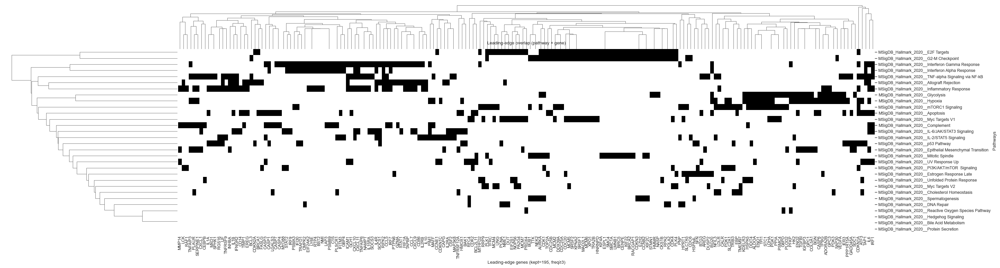

In [40]:
df_le, g = leading_edge_overlap_matrix(
    pre_res,
    term_idx=slice(0, 30),
    min_gene_freq=3,        # show only genes shared by >=3 pathways
    show_gene_labels=True,  # turn on if matrix is small
    figsize=(30,8)
)


## 9.2. Gene sets and enrichr

Enrichr libraries for selected UP- or DOWN-regulated genes (genelists)

In [28]:
res.head(3)

,gene,log2FC,t,pval,qval,mean_group,mean_ref
19927,CHAF1B,1.277070,28.074407,2.596478e-97,1.365825e-92,9.853566,8.576496
25275,MELK,1.725599,27.161092,3.677608e-96,9.672659e-92,10.017997,8.292398
16630,KIF4A,1.512519,26.751460,3.328550e-95,5.836390e-91,10.285657,8.773138


In [31]:
# subset up or down regulated genes
degs_sig = res[res.qval < 0.05]
degs_up = degs_sig[degs_sig.log2FC > 1]
degs_dw = degs_sig[degs_sig.log2FC < -1]
print(degs_up.shape, "UP")
print(degs_dw.shape, "DOWN")

(290, 7) UP
(186, 7) DOWN


In [33]:
# Over-representation analysis (Enrichr API)
enr_up = gspy.enrichr(degs_up.gene,                                # Genelist
                    gene_sets='GO_Biological_Process_2021',         # Geneset
                    outdir=None)

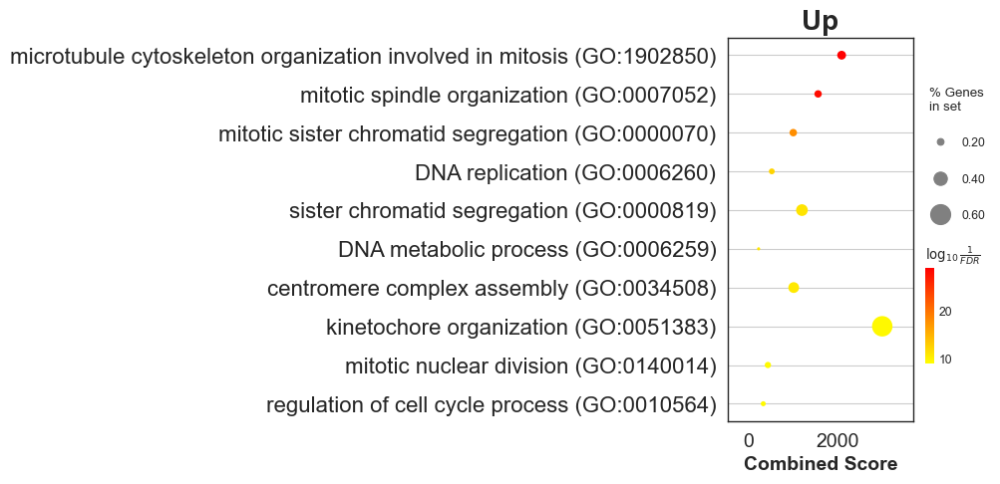

In [35]:
# dotplot
#UP
gspy.dotplot(enr_up.res2d, figsize=(3,5), title="Up", cmap = plt.cm.autumn_r)
plt.show()

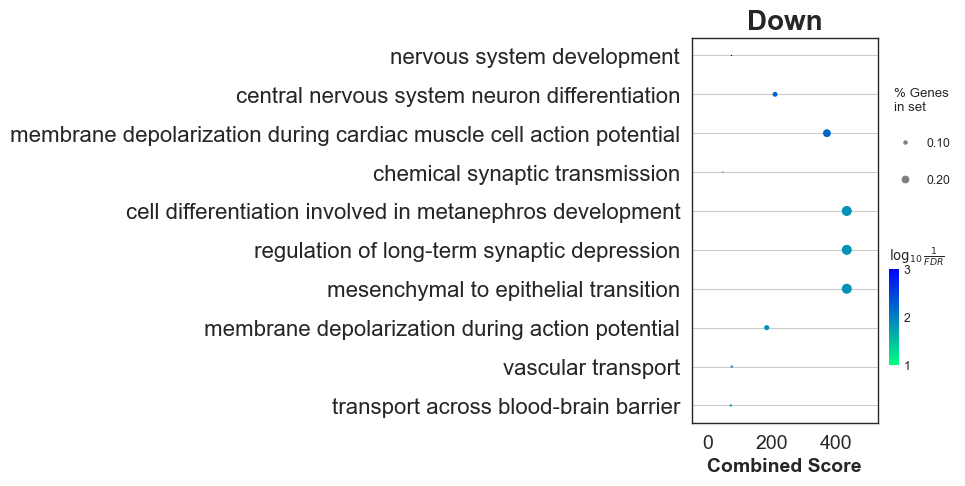

In [36]:
# DOWN
enr_dw = gspy.enrichr(degs_dw.gene,
                    gene_sets='GO_Biological_Process_2021',
                    outdir=None)

enr_dw.res2d.Term = enr_dw.res2d.Term.str.split(" \(GO").str[0]
gspy.dotplot(enr_dw.res2d,
           figsize=(3,5),
           title="Down",
           cmap = plt.cm.winter_r,
           size=5)
plt.show()

In [37]:
# concat results
enr_up.res2d['UP_DW'] = "UP"
enr_dw.res2d['UP_DW'] = "DOWN"
enr_res = pd.concat([enr_up.res2d.head(), enr_dw.res2d.head()])
enr_res

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Old P-value,Old Adjusted P-value,Odds Ratio,Combined Score,Genes,UP_DW
0,GO_Biological_Process_2021,microtubule cytoskeleton organization involved...,34/128,1.549010e-33,1.922321e-30,0,0,27.715426,2093.836437,ERCC6L;BUB1B;CDCA8;TTK;WDR62;KIF11;CENPA;SKA1;...,UP
1,GO_Biological_Process_2021,mitotic spindle organization (GO:0007052),35/157,1.342762e-31,8.331839e-29,0,0,22.037287,1566.529566,ERCC6L;BUB1B;CDCA8;TTK;WDR62;KIF11;CENPA;SKA1;...,UP
2,GO_Biological_Process_2021,mitotic sister chromatid segregation (GO:0000070),23/102,3.187767e-21,1.318673e-18,0,0,21.405822,1010.247041,SPAG5;CDCA5;PLK1;KIF14;CDCA8;NCAPG;KIF23;NCAPH...,UP
3,GO_Biological_Process_2021,DNA replication (GO:0006260),19/108,1.335048e-15,4.141987e-13,0,0,15.456652,529.387393,PIF1;FEN1;RMI2;RFC4;DONSON;CDC7;MCM10;CDC6;TIC...,UP
4,GO_Biological_Process_2021,sister chromatid segregation (GO:0000819),12/34,2.838688e-14,7.045623e-12,0,0,38.629169,1204.953867,TOP2A;KIF18A;KIF18B;SPAG5;ESPL1;KIFC1;PLK1;CEN...,UP
0,GO_Biological_Process_2021,nervous system development,18/447,2.081899e-07,2.569064e-04,0,0,4.841409,74.484175,GPM6A;TENM1;RBFOX1;CHRM1;ZBTB16;GFRA1;PCDHA11;...,DOWN
1,GO_Biological_Process_2021,central nervous system neuron differentiation,5/34,1.473603e-05,6.449331e-03,0,0,18.846447,209.670770,NTRK2;NPY;KNDC1;MAPT;CBLN1,DOWN
2,GO_Biological_Process_2021,membrane depolarization during cardiac muscle ...,4/17,1.567909e-05,6.449331e-03,0,0,33.475909,370.350098,ATP1A2;CACNA1D;SCN3B;SCN2B,DOWN
3,GO_Biological_Process_2021,chemical synaptic transmission,12/306,3.092587e-05,9.540631e-03,0,0,4.578935,47.547283,GABRB3;RIC3;GRIN2A;PTPRN2;CHRM1;GRID1;NPY;GRIK...,DOWN
4,GO_Biological_Process_2021,cell differentiation involved in metanephros d...,3/10,9.051690e-05,1.422930e-02,0,0,46.386417,431.856332,SALL1;PAX2;POU3F3,DOWN


In [38]:
from gseapy.scipalette import SciPalette
sci = SciPalette()
NbDr = sci.create_colormap()
# NbDr

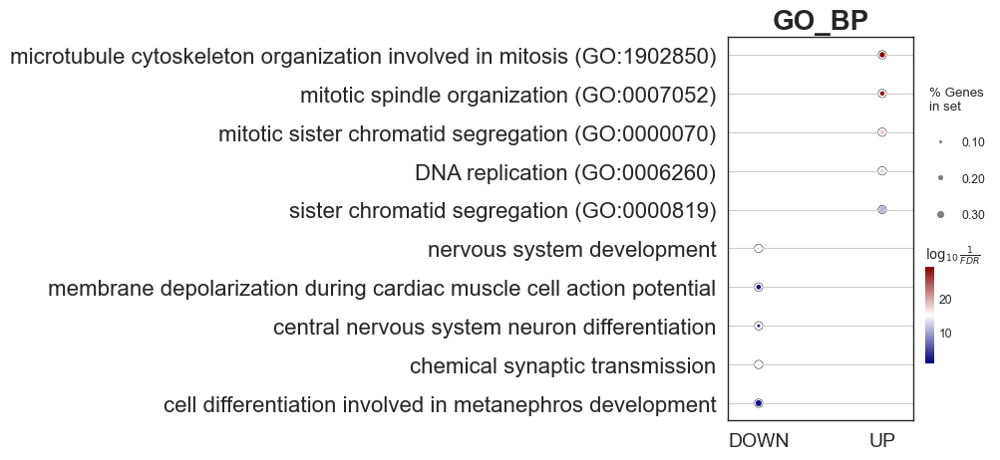

In [39]:
# display multi-datasets
ax = gspy.dotplot(enr_res,figsize=(3,5),
                x='UP_DW',
                x_order = ["DOWN", "UP"],
                title="GO_BP",
                cmap = NbDr,   # NbDr.reversed()
                size=3,
                show_ring=True)
ax.set_xlabel("")
plt.show()

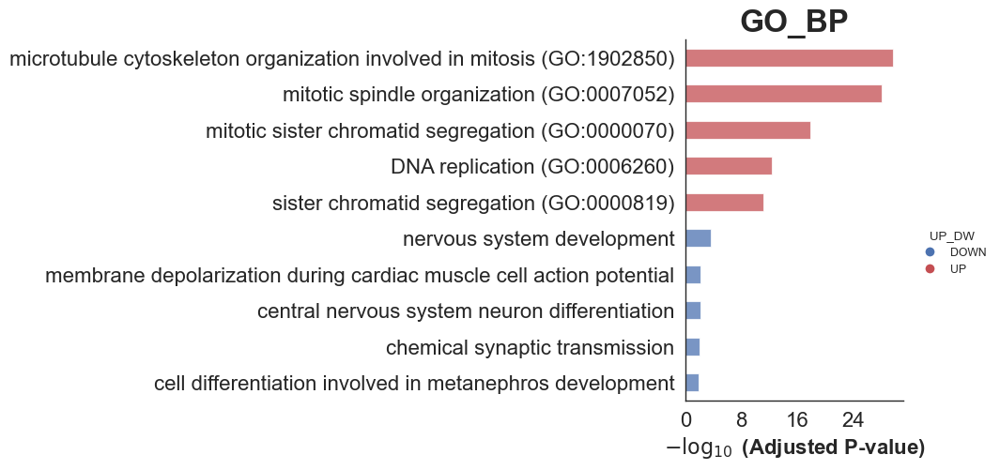

In [40]:
ax = gspy.barplot(enr_res, figsize=(3,5),
                group ='UP_DW',
                title ="GO_BP",
                color = ['b','r'])

## 9.3. Series of parallel comparisons

In [19]:
dataset = adata                                    # adata, adata_lung
dataname = "TCGA"                                  # TCGA, TCGA_lung
column = "Project_ID"                                 # e,g, "Project_ID", "RB1_mut"

In [20]:
GENESETS = "/Users/mmalumbres/Library/CloudStorage/OneDrive-VHIO/BioInformatics/Public_Data/Signatures & GeneSets/GSEA_genesets/2024/"

In [21]:
adata.obs.Project_ID.unique()

['LGG', 'LIHC', 'CESC', 'LUAD', 'COAD', ..., 'KICH', 'DLBC', NaN, 'ACC', 'CHOL']
Length: 34
Categories (33, object): ['ACC', 'BLCA', 'BRCA', 'CESC', ..., 'THYM', 'UCEC', 'UCS', 'UVM']

In [22]:
# Comparison 1 ---> save to df_gsea1, pre_res1
groupA = "LUAD"                                     # e.g. "LUAD", "1.0"
groupB = "BRCA"                                     # e.g. "LUSC", "0.0"
comparison = f"{column}_{groupA}_vs_{groupB}"
print("Comparison 01...")                   
bk.tl.de(adata, groupby=column, group=groupA, reference=groupB, method="welch_ttest", layer_expr="log1p_cpm")
res = adata.uns["de"][comparison]["results"]
df_gsea_01, pre_res_01 = bk.tl.gsea_preranked(adata, res=res, comparison=comparison, score_col="t",
    gene_sets=["hallmark"], outdir="gsea", return_pre_res=True)

# Comparison 2 ---> save to df_gsea2, , pre_res2
groupA = "LUSC"                                     # e.g. "LUAD", "1.0"
groupB = "BRCA"                                     # e.g. "LUSC", "0.0"
comparison = f"{column}_{groupA}_vs_{groupB}"
print("Comparison 02...")                     
bk.tl.de(adata, groupby=column, group=groupA, reference=groupB, method="welch_ttest", layer_expr="log1p_cpm")
res = adata.uns["de"][comparison]["results"]
df_gsea_02, pre_res_02 = bk.tl.gsea_preranked(adata, res=res, comparison=comparison, score_col="t",
    gene_sets=["hallmark"], outdir="gsea", return_pre_res=True)

print("Merging data from all comparisons...")
# later: concatenate across comparisons
all_gsea = pd.concat([df_gsea_01, df_gsea_02])
all_gsea.head(3)

INFO: DE (welch_ttest) on layer='log1p_cpm'


Comparison 01...


INFO: Stored DE results (welch_ttest) in adata.uns['de']['Project_ID_LUAD_vs_BRCA'].
INFO: Running GSEApy prerank: comparison=Project_ID_LUAD_vs_BRCA n_genes=52328 outdir=figs/gsea/Project_ID_LUAD_vs_BRCA
2025-12-30 00:02:15,217 [WARNING] Duplicated values found in preranked stats: 0.81% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
INFO: DE (welch_ttest) on layer='log1p_cpm'


Comparison 01...


INFO: Stored DE results (welch_ttest) in adata.uns['de']['Project_ID_LUSC_vs_BRCA'].
INFO: Running GSEApy prerank: comparison=Project_ID_LUSC_vs_BRCA n_genes=52277 outdir=figs/gsea/Project_ID_LUSC_vs_BRCA
2025-12-30 00:02:20,123 [WARNING] Duplicated values found in preranked stats: 1.00% of genes
The order of those genes will be arbitrary, which may produce unexpected results.


Merging data from all comparisons...


,comparison,term,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
0,Project_ID_LUAD_vs_BRCA,0,prerank,MSigDB_Hallmark_2020__Allograft Rejection,0.698233,2.557171,0.0,0.0,0.0,128/195,15.10%,LYN;ICAM1;CCL13;CTSS;ACHE;IL7;C2;SOCS1;IFNAR2;...
1,Project_ID_LUAD_vs_BRCA,1,prerank,MSigDB_Hallmark_2020__Inflammatory Response,0.697485,2.55315,0.0,0.0,0.0,121/199,14.28%,ROS1;FZD5;ICAM4;LYN;ICAM1;CCL20;SLC4A4;LAMP3;C...
2,Project_ID_LUAD_vs_BRCA,2,prerank,MSigDB_Hallmark_2020__Interferon Gamma Response,0.658335,2.445876,0.0,0.0,0.0,98/198,12.50%,UPP1;ICAM1;METTL7B;PTGS2;ST3GAL5;BANK1;CASP4;P...


In [50]:
all_gsea

,comparison,term,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
0,Project_ID_LUAD_vs_BRCA,0,prerank,MSigDB_Hallmark_2020__Allograft Rejection,0.698233,2.557171,0.0,0.0,0.0,128/195,15.10%,LYN;ICAM1;CCL13;CTSS;ACHE;IL7;C2;SOCS1;IFNAR2;...
1,Project_ID_LUAD_vs_BRCA,1,prerank,MSigDB_Hallmark_2020__Inflammatory Response,0.697485,2.55315,0.0,0.0,0.0,121/199,14.28%,ROS1;FZD5;ICAM4;LYN;ICAM1;CCL20;SLC4A4;LAMP3;C...
2,Project_ID_LUAD_vs_BRCA,2,prerank,MSigDB_Hallmark_2020__Interferon Gamma Response,0.658335,2.445876,0.0,0.0,0.0,98/198,12.50%,UPP1;ICAM1;METTL7B;PTGS2;ST3GAL5;BANK1;CASP4;P...
3,Project_ID_LUAD_vs_BRCA,3,prerank,MSigDB_Hallmark_2020__TNF-alpha Signaling via ...,0.639815,2.383453,0.0,0.0,0.0,112/198,14.73%,CXCL3;CSF2;ICAM1;CCL20;CXCL1;BMP2;CXCL2;PTGS2;...
4,Project_ID_LUAD_vs_BRCA,4,prerank,MSigDB_Hallmark_2020__IL-6/JAK/STAT3 Signaling,0.715757,2.371309,0.0,0.0,0.0,55/87,14.08%,CXCL3;CSF2;CXCL1;TNFRSF21;CD38;OSMR;IL7;SOCS1;...
...,...,...,...,...,...,...,...,...,...,...,...,...
45,Project_ID_LUSC_vs_BRCA,45,prerank,MSigDB_Hallmark_2020__Oxidative Phosphorylation,0.312852,1.154602,0.1376,0.17681,0.988,69/184,19.15%,LDHB;POR;SLC25A5;FDX1;BAX;TOMM22;POLR2F;SDHD;E...
46,Project_ID_LUSC_vs_BRCA,46,prerank,MSigDB_Hallmark_2020__Spermatogenesis,0.316611,1.122745,0.220367,0.219801,0.996,46/133,17.29%,CFTR;DCC;NOS1;POMC;GFI1;DMRT1;TLE4;PGS1;RFC4;G...
47,Project_ID_LUSC_vs_BRCA,47,prerank,MSigDB_Hallmark_2020__Androgen Response,0.327267,1.118344,0.227979,0.221384,0.997,19/96,6.20%,SGK1;NDRG1;ABCC4;SAT1;RPS6KA3;CDK6;FADS1;MERTK...
48,Project_ID_LUSC_vs_BRCA,48,prerank,MSigDB_Hallmark_2020__Pancreas Beta Cells,-0.321282,-0.994173,0.463942,0.456659,0.999,14/40,17.50%,ABCC8;DCX;SCGN;SPCS1;SRP9;SYT13;PAK3;SRP14;G6P...


In [52]:
savename = dataname + "_" + column + "_comparisons.tsv"
all_gsea.to_csv("figs/gsea/" + savename, sep="\t")

## 9.4. Pathway bubble plot

In [5]:
# use all_gsea above 
#df_gsea = all_gsea.copy()
#or load a previously saved file
GSEA = "/Users/mmalumbres/Library/CloudStorage/OneDrive-VHIO/BioInformatics/BioProjects/MM01_BULLKpy/bullkpy-skeleton/figs/gsea/"
df_gsea = pd.read_csv(GSEA + "all_gsea_TCGA_Project_ID.tsv", sep="\t")
df_gsea.head(3)

,Unnamed: 0,comparison,term,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
0,0,Project_ID_LUAD_vs_BRCA,0,prerank,MSigDB_Hallmark_2020__Allograft Rejection,0.698233,2.557171,0.0,0.0,0.0,128/195,15.10%,LYN;ICAM1;CCL13;CTSS;ACHE;IL7;C2;SOCS1;IFNAR2;...
1,1,Project_ID_LUAD_vs_BRCA,1,prerank,MSigDB_Hallmark_2020__Inflammatory Response,0.697485,2.553150,0.0,0.0,0.0,121/199,14.28%,ROS1;FZD5;ICAM4;LYN;ICAM1;CCL20;SLC4A4;LAMP3;C...
2,2,Project_ID_LUAD_vs_BRCA,2,prerank,MSigDB_Hallmark_2020__Interferon Gamma Response,0.658335,2.445876,0.0,0.0,0.0,98/198,12.50%,UPP1;ICAM1;METTL7B;PTGS2;ST3GAL5;BANK1;CASP4;P...


In [6]:
# define pathways to represent
pathways = {
    "Immune": [
        "MSigDB_Hallmark_2020__IL-6/JAK/STAT3 Signaling",
        "MSigDB_Hallmark_2020__Interferon Alpha Response",
        "MSigDB_Hallmark_2020__Inflammatory Response",
        "MSigDB_Hallmark_2020__Interferon Gamma Response",
        "MSigDB_Hallmark_2020__Allograft Rejection",
    ],
    "Metabolism": [
        "MSigDB_Hallmark_2020__Oxidative Phosphorylation",
        "MSigDB_Hallmark_2020__Estrogen Response Early",
        "MSigDB_Hallmark_2020__Pancreas Beta Cells",
    ],
    "Cell Cycle": [
        "MSigDB_Hallmark_2020__G2-M Checkpoint",
        "MSigDB_Hallmark_2020__E2F Targets",
        "MSigDB_Hallmark_2020__Myc Targets V1",
        "MSigDB_Hallmark_2020__Myc Targets V2",
    ]
}

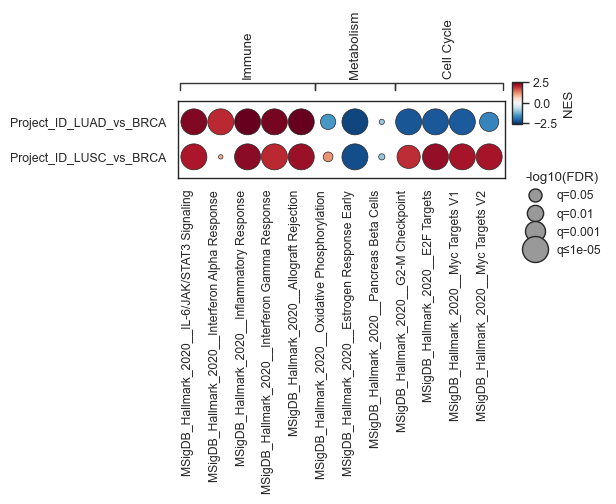

(<Figure size 500x100 with 2 Axes>, <Axes: >)

In [10]:
bk.pl.gsea_bubbleplot(
    df_gsea,
    pathways=pathways,
    fdr_floor=1e-5,             # <- YOU choose the floor
    size_clip_quantile=0.98,    # <- cap extremes so others don’t shrink
    dot_linewidth=0.5,
    row_height=0.1,          # tighter
    col_width=0.1,            # wider columns
    figsize=(5,1),
)

## 9.5. Genesets, GO and GSEA Utilities

### Rerun GSEApy from previously saved rnk file   
(res not needed) only for plotting later:

In [ ]:
rnk_path = "figs/gsea/RB1_mut_1.0_vs_0.0/RB1_mut_1.0_vs_0.0.rnk.tsv"
pre_res = gseapy.prerank(rnk=rnk_path, gene_sets="MSigDB_Hallmark_2020", outdir=None)

### Original genesets from GSEA - MSigDB

In [9]:
msig = Msigdb()
msig.list_category(dbver="2025.1.Hs") 

['c1.all',
 'c2.all',
 'c2.cgp',
 'c2.cp.biocarta',
 'c2.cp.kegg_legacy',
 'c2.cp.kegg_medicus',
 'c2.cp.pid',
 'c2.cp.reactome',
 'c2.cp',
 'c2.cp.wikipathways',
 'c3.all',
 'c3.mir.mir_legacy',
 'c3.mir.mirdb',
 'c3.mir',
 'c3.tft.gtrd',
 'c3.tft.tft_legacy',
 'c3.tft',
 'c4.3ca',
 'c4.all',
 'c4.cgn',
 'c4.cm',
 'c5.all',
 'c5.go.bp',
 'c5.go.cc',
 'c5.go.mf',
 'c5.go',
 'c5.hpo',
 'c6.all',
 'c7.all',
 'c7.immunesigdb',
 'c7.vax',
 'c8.all',
 'h.all',
 'msigdb']

In [ ]:
h_all = msig.get_gmt(category='h.all', dbver="2025.1.Hs")    # HALLMARKS
h_c2_all = msig.get_gmt(category='2.cp.reactome', dbver="2025.1.Hs")

In [ ]:
print(h_all['HALLMARK_WNT_BETA_CATENIN_SIGNALING'])

### Enrichr datasets

The authoritative list is the Enrichr dataset Statistics endpoint. To discover exact names installed in your environment:

In [7]:
bk.tl.list_enrichr_libraries()[:50]

['ARCHS4_Cell-lines',
 'ARCHS4_IDG_Coexp',
 'ARCHS4_Kinases_Coexp',
 'ARCHS4_TFs_Coexp',
 'ARCHS4_Tissues',
 'Achilles_fitness_decrease',
 'Achilles_fitness_increase',
 'Aging_Perturbations_from_GEO_down',
 'Aging_Perturbations_from_GEO_up',
 'Allen_Brain_Atlas_10x_scRNA_2021',
 'Allen_Brain_Atlas_down',
 'Allen_Brain_Atlas_up',
 'Azimuth_2023',
 'Azimuth_Cell_Types_2021',
 'BioCarta_2013',
 'BioCarta_2015',
 'BioCarta_2016',
 'BioPlanet_2019',
 'BioPlex_2017',
 'CCLE_Proteomics_2020',
 'CM4AI_U2OS_Protein_Localization_Assemblies',
 'COMPARTMENTS_Curated_2025',
 'COMPARTMENTS_Experimental_2025',
 'CORUM',
 'COVID-19_Related_Gene_Sets',
 'COVID-19_Related_Gene_Sets_2021',
 'Cancer_Cell_Line_Encyclopedia',
 'CellMarker_2024',
 'CellMarker_Augmented_2021',
 'ChEA_2013',
 'ChEA_2015',
 'ChEA_2016',
 'ChEA_2022',
 'Chromosome_Location',
 'Chromosome_Location_hg19',
 'ClinVar_2019',
 'ClinVar_2025',
 'DGIdb_Drug_Targets_2024',
 'DSigDB',
 'Data_Acquisition_Method_Most_Popular_Genes',
 'DepMa

# 10. Additional Plots 
<a id="plots"></a>

## 10.1. Dotplot

In [5]:
# Check if genes have zeros (e.g. Fraction of samples expressing is not 1)

genes = ["CDK1","MKI67","CD3E","CD79A","MS4A1"]
gidx = [adata.var_names.get_loc(g) for g in genes]
X = adata.layers["counts"][:, gidx]
X = X.toarray() if hasattr(X, "toarray") else np.asarray(X)

print("fraction >0 per gene:", (X > 0).mean(axis=0))
print("min/max counts per gene:", X.min(axis=0), X.max(axis=0))

fraction >0 per gene: [1.         1.         0.98876404 0.88764045 0.88764045]
min/max counts per gene: [5 2 0 0 0] [1156 1003  195  383  966]


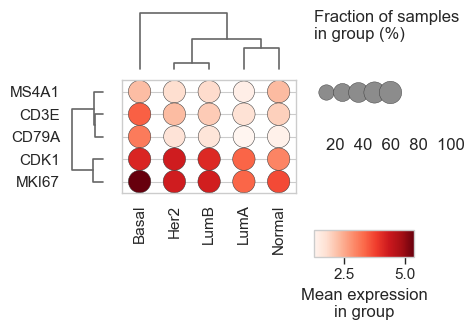

(<Figure size 615x475 with 5 Axes>, <Axes: >)

In [6]:
bk.pl.dotplot(
    adata,
    var_names=["CDK1","MKI67","CD3E","CD79A","MS4A1"],
    groupby="Subtype_PAM50",
    swap_axes=True,
    row_spacing = 0.4,
    dendrogram_top=True,
    dendrogram_rows=True,
    row_dendrogram_position="outer_left",
    title=None,
)

In [7]:
markers = {
    "B-cell": ["CD79A","MS4A1"],
    "Dendritic": ["FCER1A"],
    "Monocytes": ["CST3","FCGR3A"],
    "NK": ["GNLY","NKG7"],
    "Other": ["IGLL1"],
    "T-cell": ["CD3D"],
}

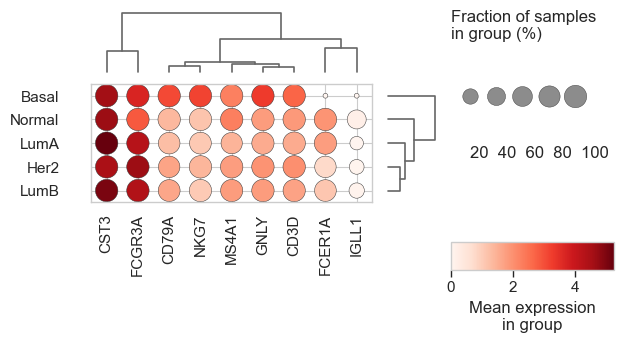

(<Figure size 835x475 with 5 Axes>, <Axes: >)

In [8]:
#var_groups dict (Scanpy-like brackets + ordering)

bk.pl.dotplot(
    adata,
    var_groups=markers,
    groupby="Subtype_PAM50",
    swap_axes=False,
    row_spacing = 0.4,
    dendrogram_rows=True,  # cluster groups
    dendrogram_top=True,  # cluster genes within the full list (still keeps brackets)
    save="figs/dotplot_scanpy_like.png",
)

### CHECK MARKERS DICT GROUPS WITH NO DENDRIMGRAM

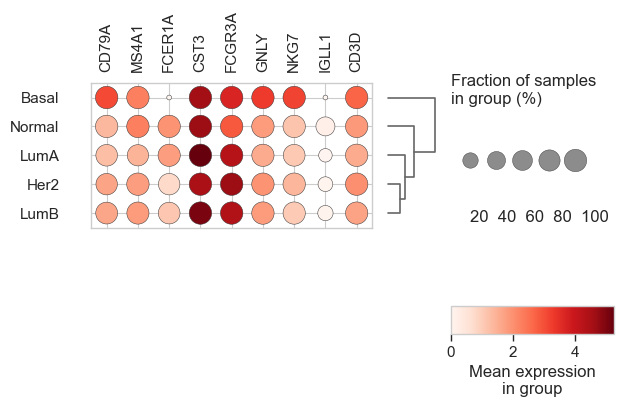

(<Figure size 835x475 with 4 Axes>, <Axes: >)

In [12]:
bk.pl.dotplot(
    adata,
    var_groups=markers,
    groupby="Subtype_PAM50",
    swap_axes=False,
    row_spacing = 0.4,
    dendrogram_rows=True,  # cluster groups
    dendrogram_top=False,  # cluster genes within the full list (still keeps brackets)
    save="figs/dotplot_scanpy_like.png",
)

## 10.2. Heatmap

In [13]:
res.columns.tolist()

['gene', 'log2FC', 't', 'pval', 'qval', 'mean_group', 'mean_ref']

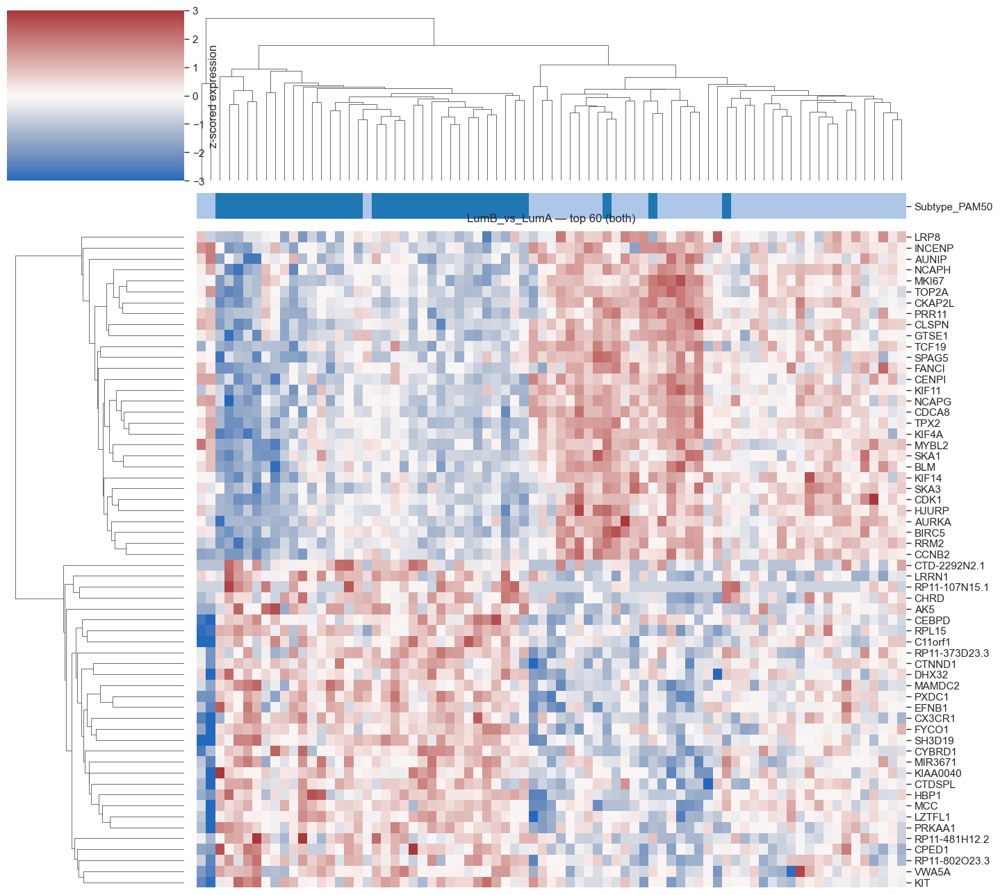

In [14]:
# 2) heatmap of top DE genes
bk.pl.heatmap_de(
    adata,
    contrast="LumB_vs_LumA",
    groupby="Subtype_PAM50",
    groups=["LumA", "LumB"],
    layer="log1p_cpm",
    top_n=60,
    mode="both",
    col_colors=["Subtype_PAM50"],
)


## 10.3. Violin plot

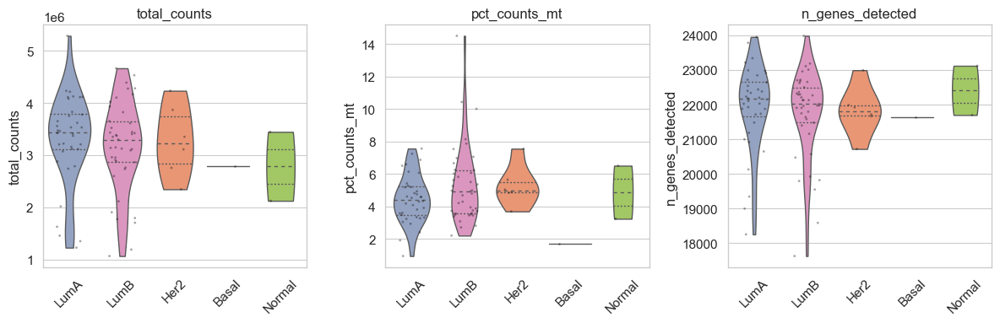

(<Figure size 1200x400 with 3 Axes>,
 array([<Axes: title={'center': 'total_counts'}, ylabel='total_counts'>,
        <Axes: title={'center': 'pct_counts_mt'}, ylabel='pct_counts_mt'>,
        <Axes: title={'center': 'n_genes_detected'}, ylabel='n_genes_detected'>],
       dtype=object))

In [14]:
bk.pl.violin(
    adata,
    keys=["total_counts", "pct_counts_mt", "n_genes_detected"],
    groupby="Subtype_PAM50",
    order=["LumA", "LumB", "Her2", "Basal", "Normal"],
    #figsize=(6, 3),
    save="figs/violin_qc.png",
)

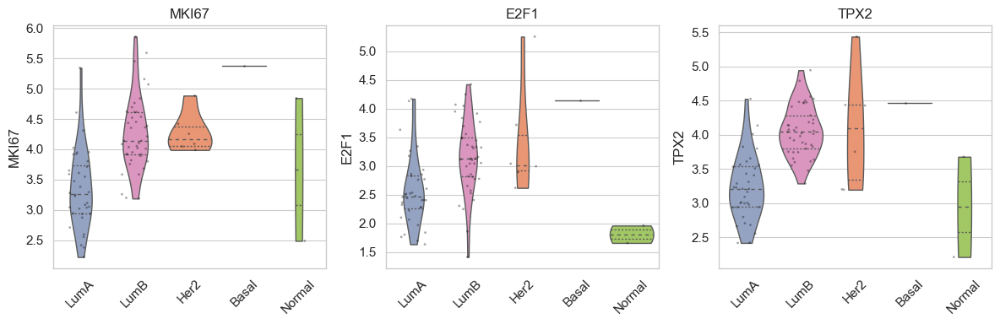

(<Figure size 1200x400 with 3 Axes>,
 array([<Axes: title={'center': 'MKI67'}, ylabel='MKI67'>,
        <Axes: title={'center': 'E2F1'}, ylabel='E2F1'>,
        <Axes: title={'center': 'TPX2'}, ylabel='TPX2'>], dtype=object))

In [13]:
bk.pl.violin_genes(adata, genes=["MKI67","E2F1", "TPX2"], groupby="Subtype_PAM50", 
                   order=["LumA", "LumB", "Her2", "Basal", "Normal"],
                   layer="log1p_cpm",
                   #figsize=(3, 4),
                   save="figs/violin_genes.png")

## 10.4. Sample distances

A) Sample distances (Euclidean on log1p_cpm) + metadata colors

UnboundLocalError: local variable 'plt' referenced before assignment

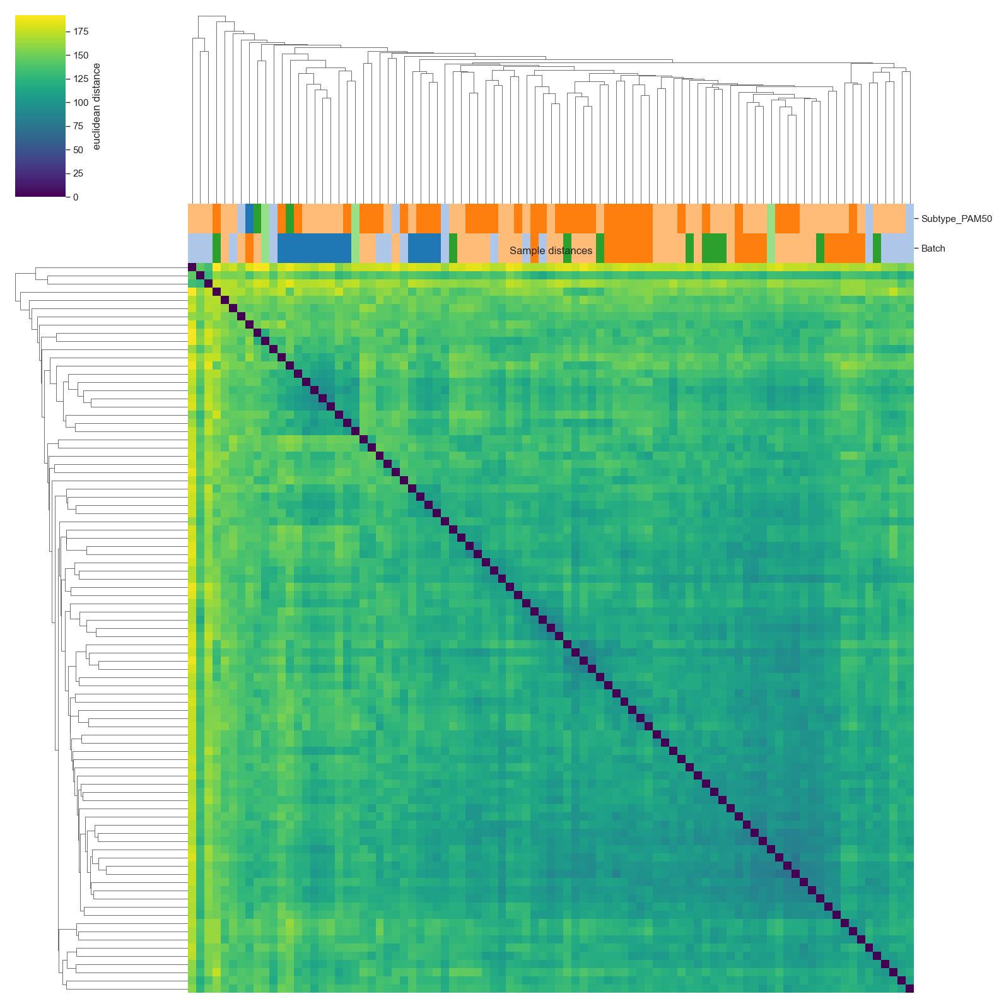

In [5]:
bk.pl.sample_distances(
    adata,
    layer="log1p_cpm",
    metric="euclidean",
    method="average",
    col_colors=["Subtype_PAM50", "Batch"],
    show_labels=False,
    save="figs/sample_distances.png",
)

B) Sample correlation clustergram (recommended for bulk QC)

In [ ]:
bk.pl.sample_correlation_clustergram(
    adata,
    layer="log1p_cpm",
    method="pearson",
    col_colors=["Subtype_PAM50", "Batch"],
    show_labels=False,
    save="figs/sample_corr_clustergram.png",
)

C) Spearman correlation version (robust)

In [ ]:
bk.pl.sample_correlation_clustergram(
    adata,
    layer="log1p_cpm",
    method="spearman",
    col_colors=["Subtype_PAM50"],
    save="figs/sample_corr_spearman.png",
)

## 10.5. Gene Plot

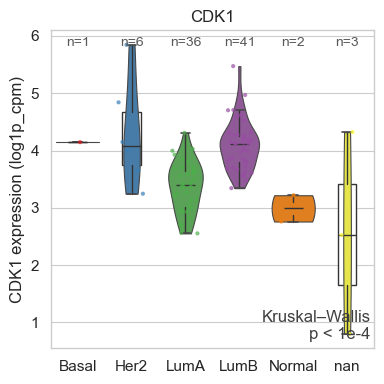

(<Figure size 400x400 with 1 Axes>,
 <Axes: title={'center': 'CDK1'}, ylabel='CDK1 expression (log1p_cpm)'>,
 {'test': 'Kruskal–Wallis', 'pvalue': 3.3816506907753345e-07, 'compare': None})

In [22]:
# Overall p-value across all PAM50 subtypes
bk.pl.gene_plot(
    adata,
    gene="CDK1",
    groupby="Subtype_PAM50",
    layer="log1p_cpm",
    test="auto",           # defaults to Kruskal
    kind="both",
    figsize=(4,4),
    save="figs/CDK1_by_PAM50.png",
)

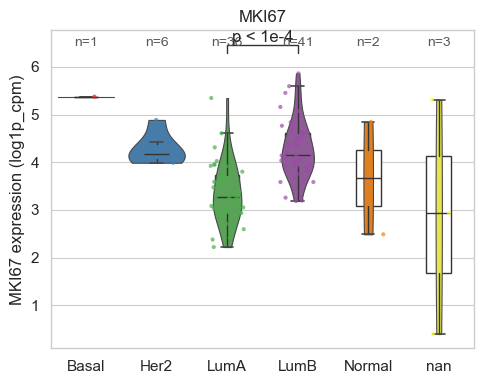

(<Figure size 500x400 with 1 Axes>,
 <Axes: title={'center': 'MKI67'}, ylabel='MKI67 expression (log1p_cpm)'>,
 {'test': 'Mann–Whitney U',
  'pvalue': 5.433595540609767e-08,
  'compare': ['LumA', 'LumB']})

In [24]:
# Pairwise LumA vs LumB with bracket
bk.pl.gene_plot(
    adata,
    gene="MKI67",
    groupby="Subtype_PAM50",
    layer="log1p_cpm",
    compare=["LumA", "LumB"],
    test="wilcoxon",       # Mann–Whitney U
    kind="both",
    figsize=(5,4),
    save="figs/MKI67_LumA_vs_LumB.png",
)

## 10.6. Oncoprint

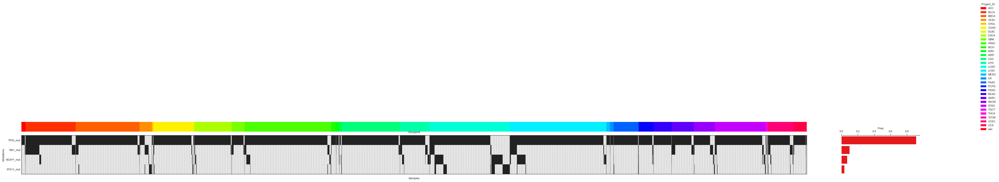

(<Figure size 6924x295 with 3 Axes>,
 <Axes: title={'center': 'Oncoprint'}, xlabel='Samples', ylabel='Mutations'>)

In [7]:
bk.pl.oncoprint(
    adata,
    mut_cols=["TP53_mut", "RB1_mut", "STK11_mut", "KEAP1_mut"],
    groupby="Project_ID",
    group_blocks=True,
    save="figs/oncoprint_mutfirst_by_project.png",
)

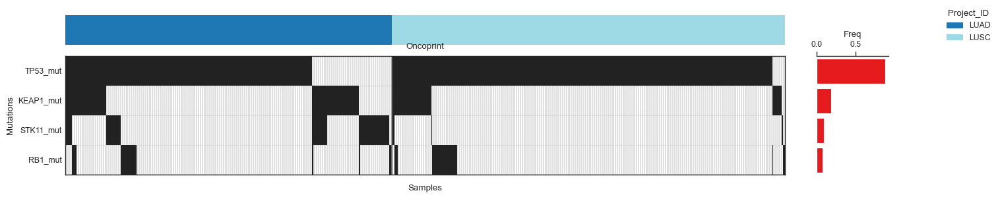

(<Figure size 2080x295 with 3 Axes>,
 <Axes: title={'center': 'Oncoprint'}, xlabel='Samples', ylabel='Mutations'>)

In [8]:
bk.pl.oncoprint(
    adata_lung,
    mut_cols=["TP53_mut", "RB1_mut", "STK11_mut", "KEAP1_mut"],
    groupby="Project_ID",
    group_blocks=True,
    save="figs/oncoprint_mutfirst_by_project.png",
)

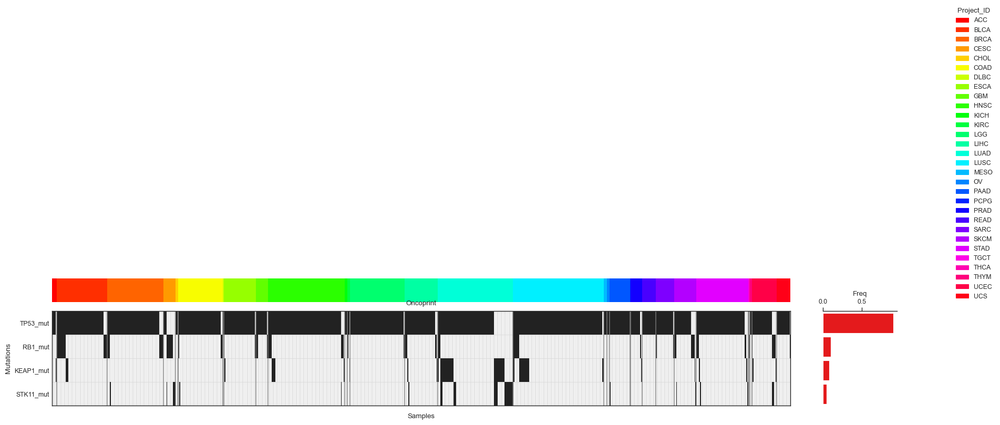

(<Figure size 2680x295 with 3 Axes>,
 <Axes: title={'center': 'Oncoprint'}, xlabel='Samples', ylabel='Mutations'>)

In [9]:
# Large datasets (avoid huge images)
bk.pl.oncoprint(
    adata,
    mut_cols=["TP53_mut", "RB1_mut", "STK11_mut", "KEAP1_mut"],
    groupby="Project_ID",
    max_samples=800,          # IMPORTANT for TCGA-scale
    cell_size=0.03,           # compact columns
    save_dpi=120,             # keep under pixel limit
    save="figs/oncoprint_big.png",
)

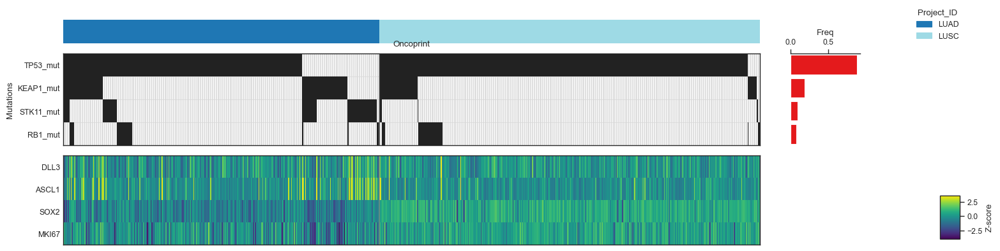

(<Figure size 2080x430 with 5 Axes>,
 <Axes: title={'center': 'Oncoprint'}, xlabel='Samples', ylabel='Mutations'>)

In [10]:
#Add expression tracks under the mutations
bk.pl.oncoprint(
    adata_lung,
    mut_cols=["RB1_mut", "TP53_mut", "KEAP1_mut", "STK11_mut"],
    expr_genes=["DLL3", "ASCL1", "SOX2", "MKI67"],
    layer="log1p_cpm",
    expr_zscore=True,              # makes expression rows comparable
    groupby="Project_ID",
    sort_samples="pattern",
    save="figs/oncoprint_plus_expr.png",
)

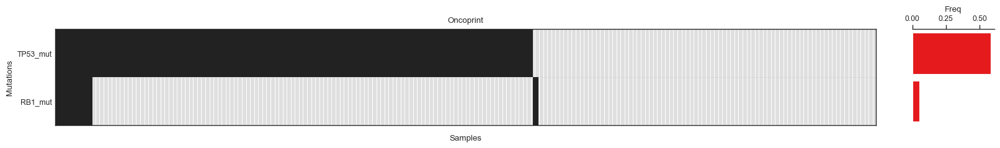

(<Figure size 2524x190 with 2 Axes>,
 <Axes: title={'center': 'Oncoprint'}, xlabel='Samples', ylabel='Mutations'>)

In [18]:
# Control the order
bk.pl.oncoprint(
    adata_lung,
    drop_all_wt = False,
    mut_cols=["RB1_mut", "TP53_mut"],
    #group_order=,  # or any subset/order list(adata.obs_names),
    sort_samples="mut_first"     # "burden",     #"none",
)

# 11. Other Utilities
<a id="utilities"></a>

## 10.1. Batch Correction

Best practice is to run ComBat on log-normalized expression (not raw counts):

In [7]:
adata.obs.Batch.value_counts()

Batch4    29
Batch2    17
Batch3    17
Batch1    13
Batch5    10
Name: Batch, dtype: int64

In [8]:
bk.pp.batch_correct_combat(
    adata,
    batch_key="Batch",
    layer="log1p_cpm",
    covariates=["Subtype_PAM50"],   # preserve biology
    key_added="combat_log1p_cpm",
)

INFO: ComBat: correcting layer='log1p_cpm' with batch_key='Batch' (5 batches), covariates=['Subtype_PAM50']
INFO: ComBat: stored corrected matrix in adata.layers['combat_log1p_cpm']


In [10]:
adata.layers

Layers with keys: counts, cpm, log1p_cpm, combat_log1p_cpm

In [ ]:
#then use downstream
bk.tl.pca(adata, layer="combat_log1p_cpm", use_highly_variable=True)
bk.tl.neighbors(adata, use_rep="X_pca", n_neighbors=15)
bk.tl.umap(adata)

## 10.2. Solve problems when saving h5ad object

In [ ]:
#adata.uns.setdefault("bullkpy", {})
#adata.uns["bullkpy"]["loaded_with_version"] = bk.__version__
#adata.uns["bullkpy"]["load_date"] = datetime.now().isoformat()

In [37]:
adata.uns["bullkpy"] = {
    "version": bk.__version__,
    "date": __import__("datetime").datetime.now().isoformat(),
}

In [35]:
adata.write("251222_CDKpredict_BULLKpy_RNAseq.h5ad",
            #compression="gzip",
           )

### If Errors in saving

In [41]:
bad_cols = [
    c for c in adata.obs.columns
    if adata.obs[c].dtype == "object"
]
len(bad_cols)

1

In [40]:
for col in adata.obs.columns:
    if adata.obs[col].dtype == "object":
        adata.obs[col] = adata.obs[col].astype(str)

In [34]:
bad = []
for col in adata.obs.columns:
    s = adata.obs[col]
    if pd.api.types.is_categorical_dtype(s):
        cats = list(s.cat.categories)
        # flag anything that is not a plain string
        if any((c is not None) and (not isinstance(c, str)) for c in cats):
            bad.append(col)

bad

[]

In [35]:
for col in bad:
    s = adata.obs[col]
    # keep as category but ensure categories are strings
    adata.obs[col] = s.astype("category")
    adata.obs[col] = adata.obs[col].cat.rename_categories(
        [str(c) for c in adata.obs[col].cat.categories]
    )

In [36]:
def _make_serializable(x):
    # numpy scalars
    if isinstance(x, (np.generic,)):
        return x.item()
    # pandas objects
    if isinstance(x, (pd.Index,)):
        return x.astype(str).tolist()
    if isinstance(x, (pd.Series,)):
        return x.to_list()
    if isinstance(x, (pd.DataFrame,)):
        return x.to_dict(orient="list")
    # sets/tuples
    if isinstance(x, (set, tuple)):
        return list(x)
    # dicts/lists recurse
    if isinstance(x, dict):
        return {str(k): _make_serializable(v) for k, v in x.items()}
    if isinstance(x, list):
        return [_make_serializable(v) for v in x]
    # numpy arrays OK
    if isinstance(x, np.ndarray):
        return x
    # basic python types OK
    if isinstance(x, (str, int, float, bool)) or x is None:
        return x
    # fallback: stringify
    return str(x)

adata.uns = _make_serializable(adata.uns)